# Load packages

In [2]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [3]:
# Use the SummaryModels class for everything related to the reconstructions
generative_dist = "GMM"
learning_rate = 0.00003
GMM_equally_weighted = False
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               GMM_equally_weighted=GMM_equally_weighted)

In [4]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [5]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [6]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05.pth


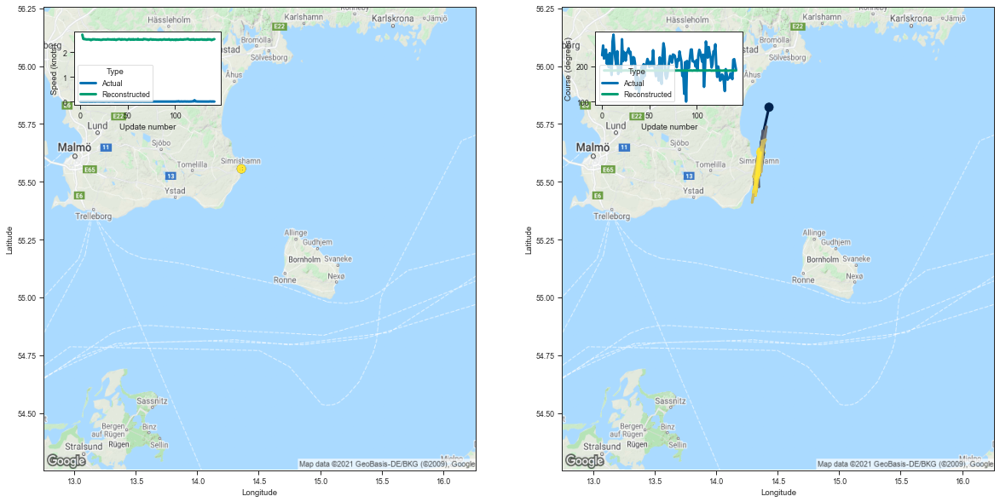

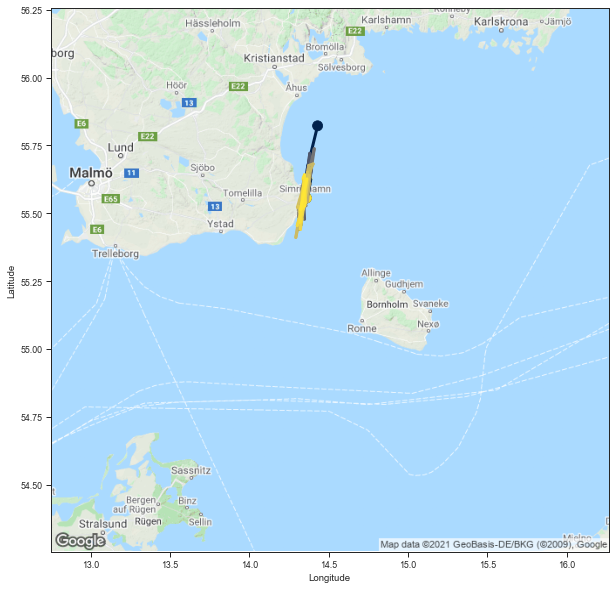

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6805561  265759000  14.359310  55.555870  0.002439   
1                 0  6805561  265759000  14.359292  55.555862  0.000000   
2                 0  6805561  265759000  14.359305  55.555885  0.000000   
3                 0  6805561  265759000  14.359301  55.555866  0.000000   
4                 0  6805561  265759000  14.359290  55.555855  0.000000   
..              ...      ...        ...        ...        ...       ...   
138               0  6805561  265759000  14.359321  55.555862  0.006250   
139               0  6805561  265759000  14.359283  55.555847  0.000000   
140               0  6805561  265759000  14.359297  55.555851  0.004444   
141               0  6805561  265759000  14.359303  55.555874  0.002083   
142               0  6805561  265759000  14.359310  55.555862  0.000000   

         Course Ship type  Track length          Time stamp  
0    230.309753   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma,Max mixing index,Max mixing probability
2,14.430012,55.822292,2.707099,187.693527,0.049879,0.135835,3.406666,100.577744,1,1.0
3,14.368952,55.676041,2.536799,187.747131,0.035216,0.071539,3.308968,100.724800,1,1.0
4,14.371235,55.570122,2.524199,187.619843,0.033428,0.065768,3.263838,100.665718,1,1.0
5,14.386736,55.624294,2.526786,187.800446,0.033326,0.066238,3.274819,100.771324,1,1.0
6,14.354368,55.613949,2.512570,187.710815,0.032933,0.064292,3.273144,100.725533,1,1.0
...,...,...,...,...,...,...,...,...,...,...
138,14.318729,55.466328,2.505302,187.199936,0.033250,0.064232,3.273911,100.458572,1,1.0
139,14.347280,55.641655,2.486117,187.759109,0.032729,0.062139,3.287324,100.752182,1,1.0
140,14.349157,55.528111,2.500784,187.433456,0.032890,0.063289,3.264099,100.581963,1,1.0
141,14.322641,55.512100,2.515203,187.435638,0.032879,0.064836,3.258652,100.579056,1,1.0


In [7]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05.pth


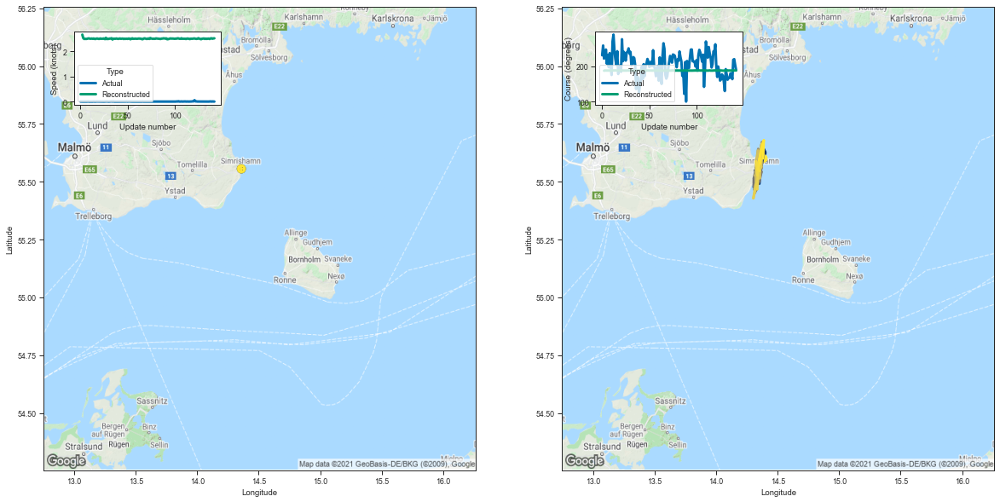

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.373065  55.624653  2.672134  187.082336         0.048699   
3    14.363019  55.617920  2.533905  187.634888         0.035189   
4    14.354159  55.594894  2.499191  187.604996         0.032962   
5    14.352603  55.594616  2.505196  187.703461         0.032559   
6    14.320021  55.500069  2.500103  187.332581         0.032973   
..         ...        ...       ...         ...              ...   
138  14.363234  55.597992  2.520688  187.729172         0.032669   
139  14.356861  55.578598  2.525523  187.631546         0.033252   
140  14.349335  55.593861  2.508363  187.652496         0.032877   
141  14.387736  55.678871  2.520601  187.948669         0.033136   
142  14.381505  55.600807  2.524795  187.672684         0.033024   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.125633     3.391983    100.272575                 1   
3          0.070364     3.295656    100.668236 

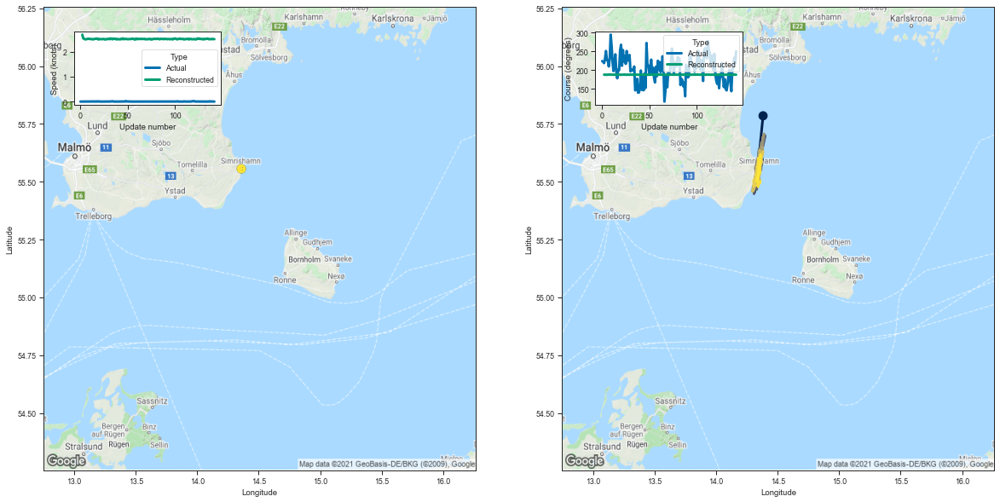

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.381692  55.785168  2.685067  187.664917         0.048294   
3    14.323911  55.476452  2.534850  187.170746         0.035252   
4    14.361232  55.631554  2.516137  187.780441         0.033291   
5    14.311572  55.453953  2.494440  187.153061         0.032852   
6    14.350597  55.610825  2.499345  187.695267         0.032676   
..         ...        ...       ...         ...              ...   
138  14.342456  55.600021  2.508463  187.682266         0.032943   
139  14.354995  55.541321  2.499764  187.459564         0.032723   
140  14.360552  55.611740  2.513139  187.810272         0.032511   
141  14.344303  55.541252  2.505177  187.531235         0.032871   
142  14.331868  55.501541  2.503640  187.392929         0.033150   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.124850     3.398846    100.592529                 1   
3          0.072312     3.275325    100.411278 

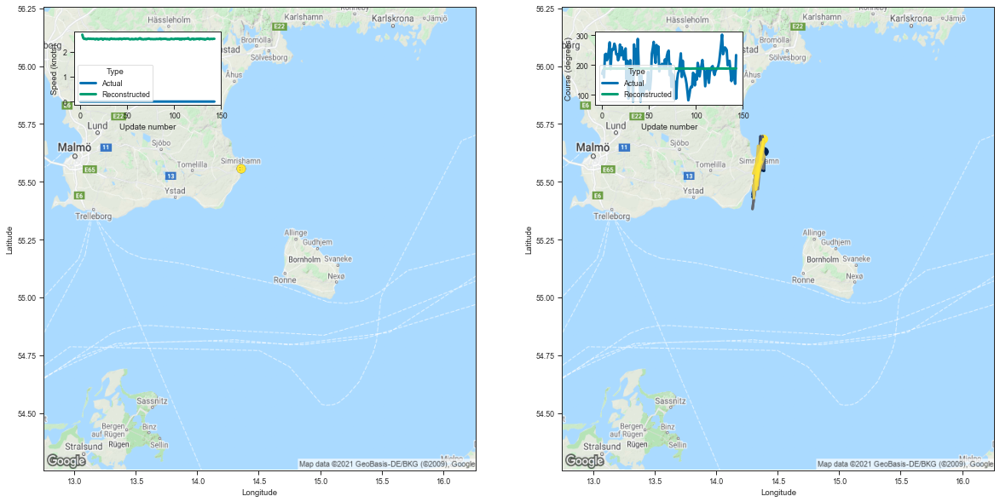

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.390518  55.629570  2.683557  187.272247         0.048084   
3    14.389083  55.547356  2.547409  187.577530         0.034729   
4    14.343550  55.552731  2.510669  187.522293         0.032998   
5    14.354610  55.569942  2.523021  187.589279         0.033261   
6    14.297409  55.433643  2.497776  187.145264         0.032911   
..         ...        ...       ...         ...              ...   
139  14.368640  55.586918  2.512414  187.674637         0.032853   
140  14.329238  55.551914  2.513726  187.501923         0.033390   
141  14.343732  55.575111  2.506236  187.565826         0.033092   
142  14.331120  55.510132  2.517067  187.433014         0.033173   
143  14.384765  55.684376  2.516640  187.952087         0.033095   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.121715     3.387860    100.383354                 1   
3          0.071104     3.271747    100.639496 

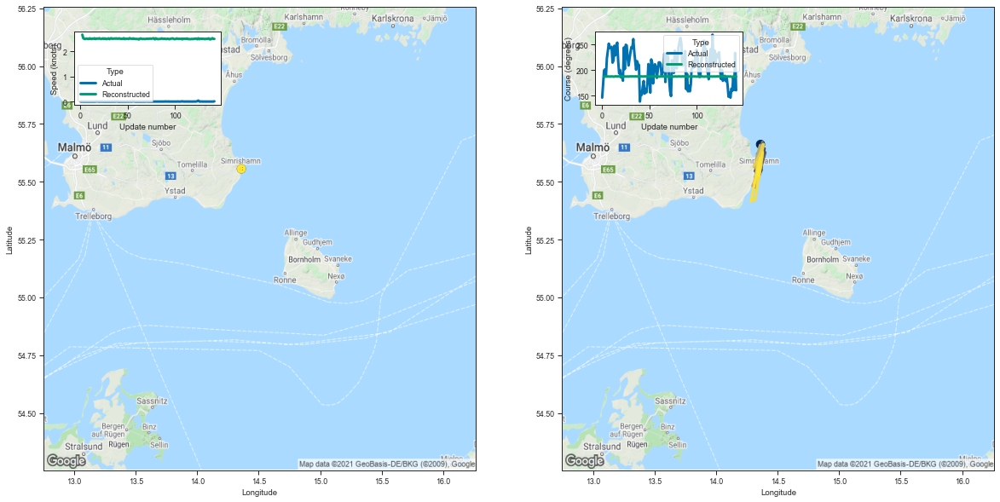

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.361100  55.661541  2.676881  187.273560         0.048457   
3    14.342277  55.509823  2.534133  187.295731         0.035271   
4    14.352596  55.551666  2.507600  187.607315         0.032873   
5    14.332176  55.513607  2.500697  187.408432         0.033041   
6    14.338680  55.592445  2.515203  187.667709         0.033121   
..         ...        ...       ...         ...              ...   
138  14.282613  55.415981  2.487687  187.060165         0.032947   
139  14.358391  55.603088  2.515792  187.701813         0.033065   
140  14.351252  55.568493  2.532019  187.587387         0.033279   
141  14.345313  55.526226  2.510511  187.488235         0.032662   
142  14.341681  55.554165  2.505535  187.521957         0.032718   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.124815     3.387007    100.374519                 1   
3          0.070723     3.281061    100.485222 

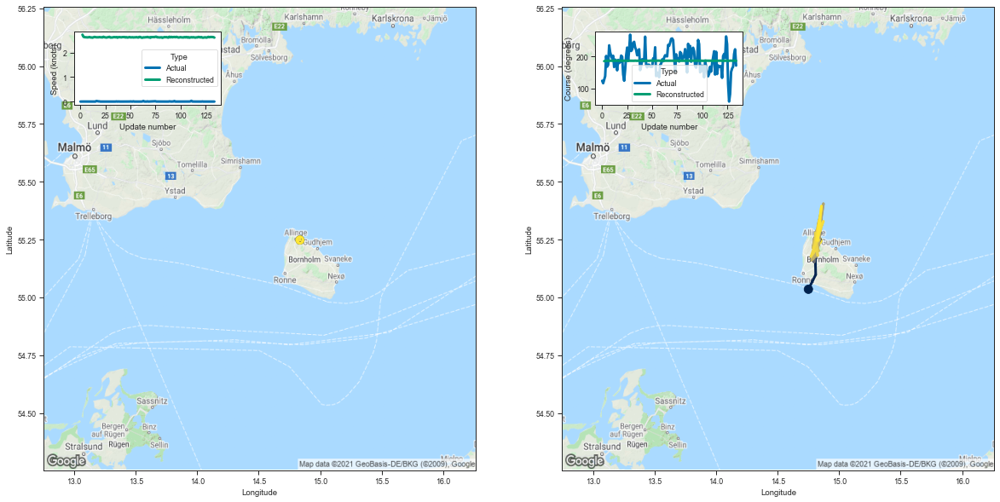

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.750274  55.034939  2.730610  185.819992         0.046244   
3    14.809584  55.097988  2.644442  186.609268         0.034717   
4    14.806705  55.164246  2.626959  186.885849         0.033081   
5    14.816489  55.191120  2.622930  186.942535         0.032991   
6    14.828327  55.293266  2.617871  187.282318         0.032582   
..         ...        ...       ...         ...              ...   
130  14.847539  55.321934  2.634747  187.389923         0.033094   
131  14.816483  55.246349  2.635159  187.148926         0.032655   
132  14.827685  55.292393  2.633296  187.303253         0.032929   
133  14.856764  55.394497  2.628961  187.657364         0.032211   
134  14.826310  55.245682  2.609488  187.078766         0.032542   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.116475     3.270895     99.612808                 1   
3          0.073149     3.179579    100.106483 

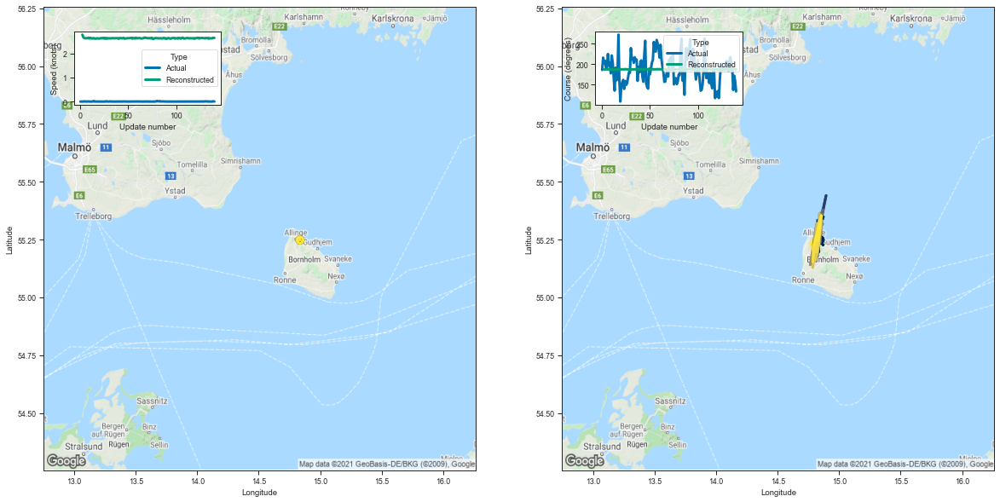

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.845123  55.248985  2.773353  186.558289         0.047258   
3    14.869637  55.226261  2.668968  187.054626         0.035318   
4    14.838394  55.248230  2.631335  187.210129         0.033130   
5    14.836559  55.256649  2.624605  187.167068         0.032763   
6    14.828604  55.262280  2.622509  187.223801         0.032315   
..         ...        ...       ...         ...              ...   
136  14.791902  55.222477  2.621691  187.039978         0.032943   
137  14.822217  55.251793  2.615885  187.148773         0.032517   
138  14.830069  55.243244  2.628026  187.186783         0.032391   
139  14.855889  55.353119  2.647321  187.476562         0.032992   
140  14.797370  55.228680  2.636203  187.114349         0.032893   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126009     3.272849     99.982452                 1   
3          0.075543     3.187290    100.339821 

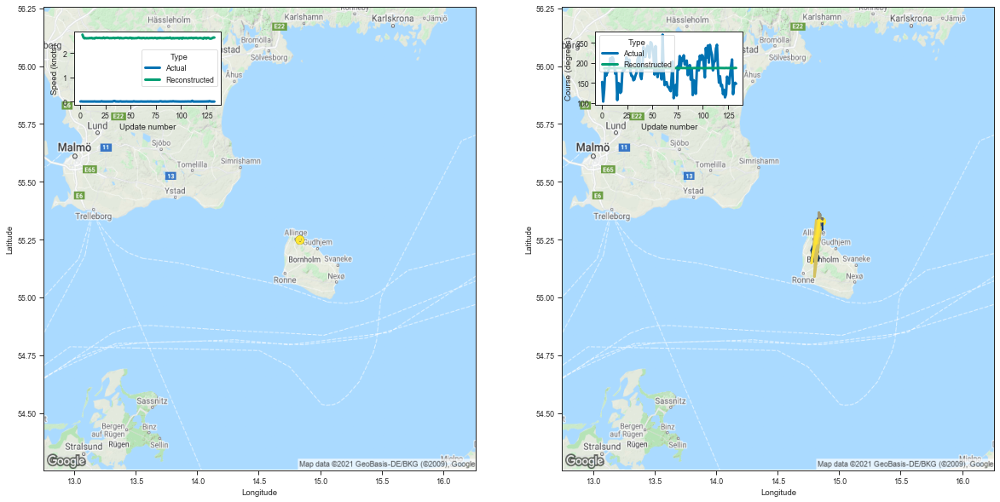

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.805036  55.170944  2.765148  186.270645         0.047289   
3    14.820898  55.160091  2.649825  186.810974         0.034963   
4    14.810813  55.207832  2.610068  187.008392         0.032683   
5    14.822872  55.227314  2.623494  187.089157         0.032421   
6    14.822299  55.276070  2.612128  187.174255         0.032471   
..         ...        ...       ...         ...              ...   
129  14.776047  55.148338  2.597515  186.822464         0.032186   
130  14.812001  55.264500  2.604907  187.199097         0.032350   
131  14.813169  55.232891  2.623397  187.117081         0.032683   
132  14.838240  55.334244  2.646593  187.511337         0.032855   
133  14.857051  55.327827  2.644542  187.425598         0.033000   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.125385     3.275916     99.826393                 1   
3          0.074460     3.188867    100.215271 

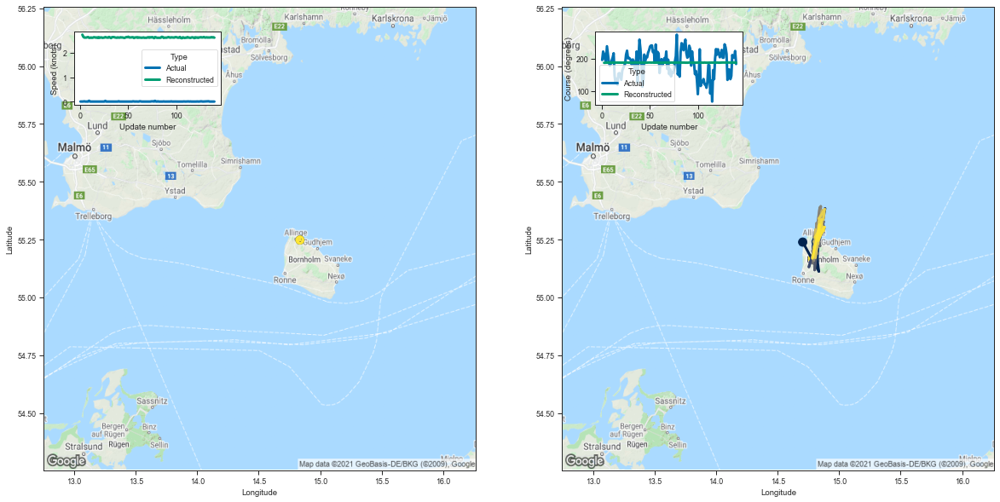

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.704018  55.238937  2.741407  186.535538         0.046250   
3    14.835373  55.112095  2.654457  186.678391         0.034789   
4    14.822635  55.162373  2.620537  186.882202         0.032796   
5    14.834593  55.262043  2.621517  187.204208         0.032136   
6    14.824477  55.301975  2.619145  187.306915         0.032513   
..         ...        ...       ...         ...              ...   
136  14.817801  55.268055  2.624980  187.281723         0.032407   
137  14.881188  55.304100  2.639337  187.402405         0.032430   
138  14.829928  55.245686  2.624946  187.179779         0.032475   
139  14.841373  55.314846  2.634907  187.403793         0.032509   
140  14.784278  55.168777  2.616463  186.861664         0.032735   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.116925     3.285436     99.991859                 1   
3          0.073966     3.178399    100.142647 

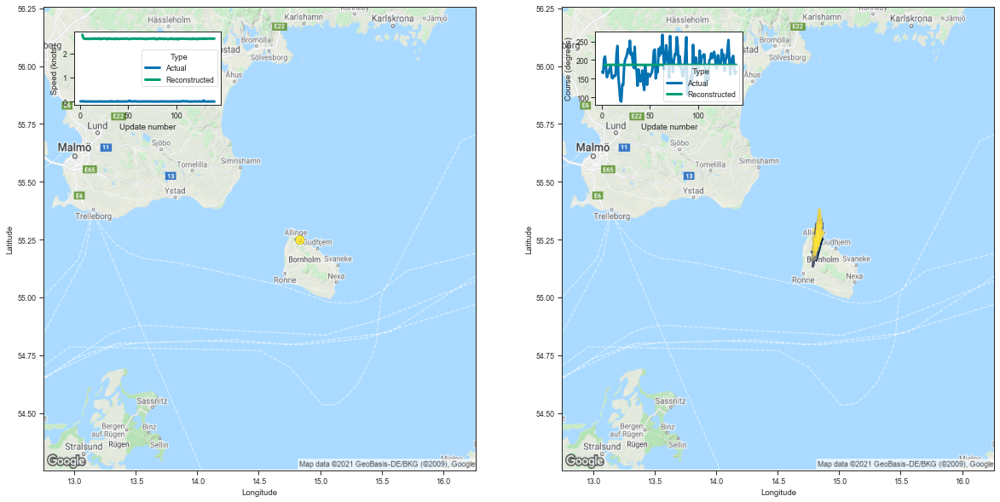

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.834825  55.251938  2.796156  186.550781         0.047856   
3    14.834892  55.243256  2.652601  187.092987         0.034581   
4    14.851870  55.235897  2.626387  187.174606         0.032708   
5    14.814660  55.162178  2.616050  186.875214         0.032408   
6    14.799203  55.234337  2.622526  187.102203         0.032883   
..         ...        ...       ...         ...              ...   
136  14.840480  55.255669  2.628916  187.200195         0.032510   
137  14.810485  55.204216  2.627656  187.012314         0.032843   
138  14.806106  55.249912  2.620795  187.202255         0.032758   
139  14.830740  55.245743  2.633734  187.191025         0.032714   
140  14.824724  55.288204  2.629287  187.294769         0.032446   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.129163     3.270443     99.979797                 1   
3          0.073154     3.187334    100.362206 

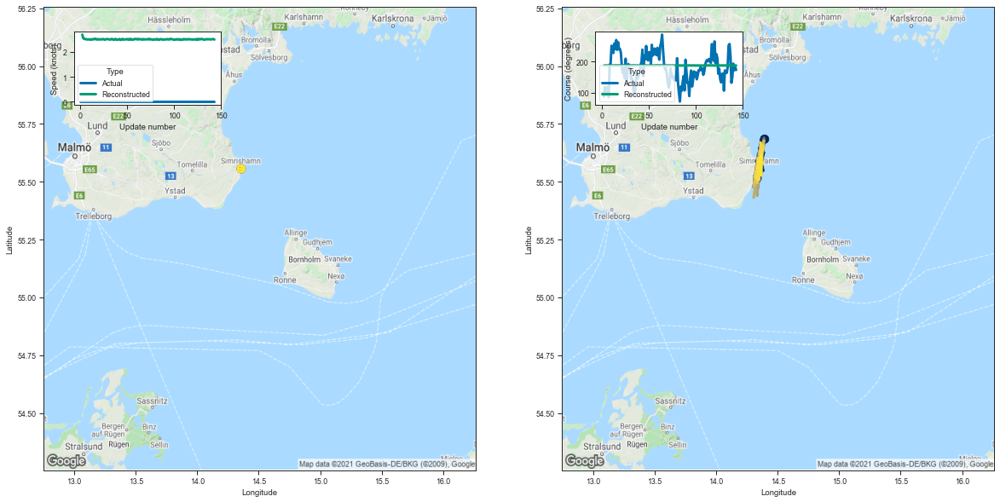

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.393930  55.684151  2.700072  187.261215         0.049776   
3    14.367909  55.633591  2.561299  187.733292         0.035550   
4    14.367334  55.569061  2.524557  187.627014         0.033169   
5    14.372557  55.565006  2.524179  187.622864         0.032994   
6    14.364819  55.527496  2.516275  187.451401         0.033243   
..         ...        ...       ...         ...              ...   
139  14.336275  55.561367  2.503479  187.587296         0.032523   
140  14.355214  55.564613  2.511072  187.585312         0.033009   
141  14.367592  55.527771  2.518858  187.428070         0.033157   
142  14.371146  55.618217  2.521303  187.697723         0.033444   
143  14.351512  55.582184  2.502140  187.637680         0.032812   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.136544     3.392582    100.357666                 1   
3          0.073331     3.291702    100.710075 

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
95,95,6805561,265759000,Fishing,143,-617.255127,-4.316469
29,29,6787151,265759000,Fishing,143,-624.674805,-4.368355
44,44,7135380,266054000,Fishing,144,-636.793457,-4.422177
60,60,6869996,265759000,Fishing,143,-632.778320,-4.425023
8,8,1943886,230069190,Fishing,135,-598.942200,-4.436609
4,4,2259131,230069190,Fishing,141,-626.087158,-4.440334
20,20,1961288,230069190,Fishing,134,-595.360046,-4.442985
70,70,2240973,230069190,Fishing,141,-627.267090,-4.448703
98,98,2159262,230069190,Fishing,141,-629.382324,-4.463704
25,25,7292936,266054000,Fishing,144,-644.760376,-4.477503


In [9]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(tracks['Reconstructed trajectory'])
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05.pth


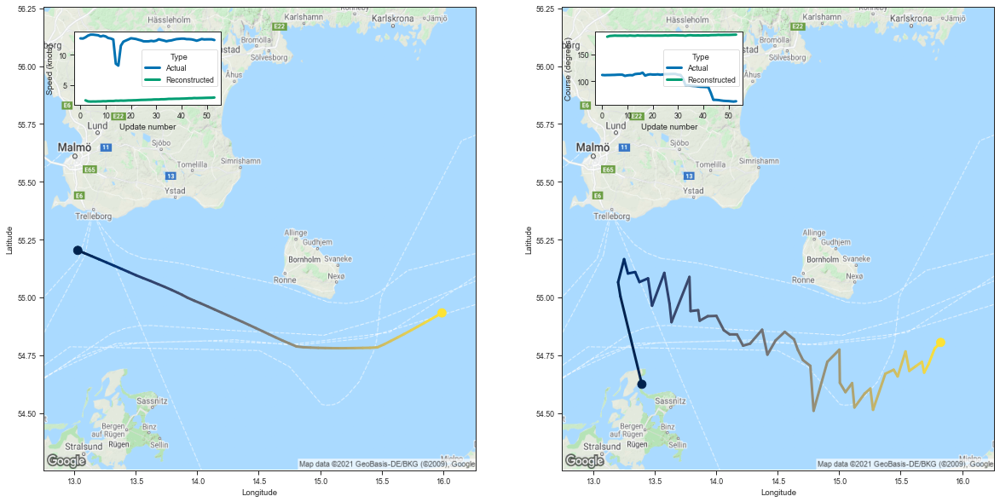

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.396509  54.624119  2.437916  182.983154         0.050869   
3   13.222049  55.004536  2.259335  184.460449         0.036814   
4   13.203227  55.065548  2.231159  184.766312         0.034369   
5   13.251946  55.165012  2.245233  185.150513         0.033768   
6   13.283424  55.103191  2.238305  184.940536         0.033976   
7   13.342049  55.109425  2.258965  184.956207         0.034122   
8   13.376961  55.066166  2.260496  184.914856         0.033916   
9   13.446601  55.082100  2.293920  185.054947         0.033962   
10  13.479291  54.963779  2.281633  184.755280         0.033518   
11  13.578977  55.105743  2.323842  185.284821         0.033784   
12  13.621329  54.972538  2.330163  184.918549         0.033905   
13  13.637575  54.892799  2.324117  184.713791         0.033371   
14  13.783175  55.088322  2.376442  185.450272         0.034121   
15  13.792193  54.940647  2.365206  185.065521         0.03332

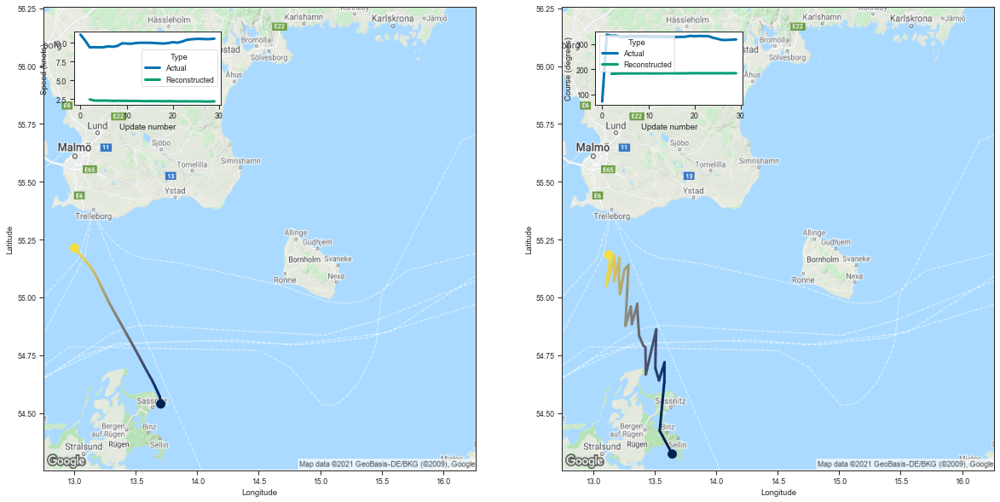

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.643473  54.322361  2.481508  182.507492         0.049358   
3   13.541410  54.422966  2.331019  183.151535         0.036248   
4   13.579193  54.636089  2.316394  183.892120         0.033832   
5   13.580675  54.719181  2.328255  184.120483         0.034287   
6   13.535540  54.640854  2.319567  183.885727         0.034243   
7   13.506104  54.694492  2.283539  183.892593         0.033527   
8   13.508041  54.762398  2.304489  184.142914         0.033777   
9   13.513131  54.860970  2.285380  184.493561         0.033416   
10  13.428662  54.666866  2.299694  183.831985         0.034122   
11  13.425502  54.782825  2.273796  184.124100         0.033825   
12  13.407940  54.792236  2.276652  184.127106         0.034122   
13  13.373780  54.835007  2.270213  184.204834         0.034266   
14  13.360840  54.936634  2.246800  184.574005         0.033321   
15  13.359308  54.972500  2.260990  184.658539         0.03365

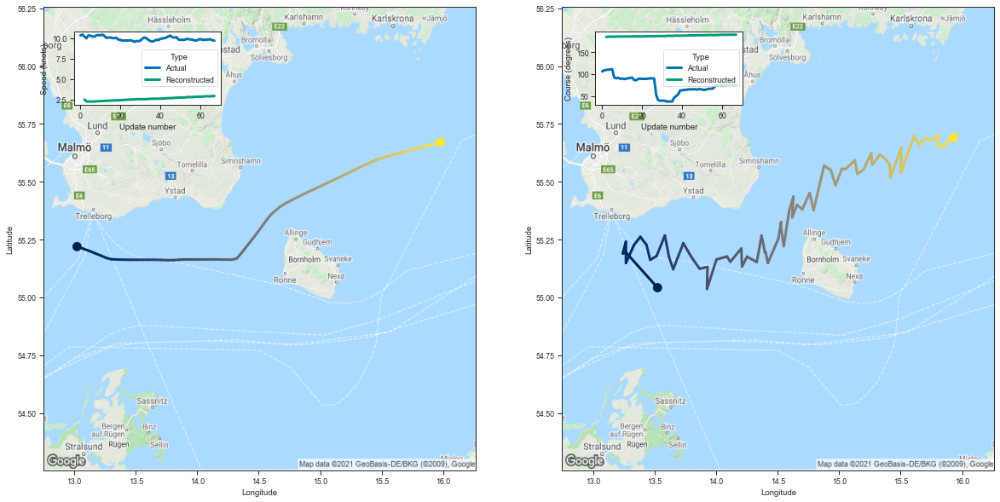

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.523870  55.041691  2.484637  184.337540         0.051793   
3   13.267491  55.194080  2.264877  185.129944         0.036235   
4   13.241418  55.189697  2.239131  185.077820         0.034803   
5   13.266638  55.240608  2.235709  185.324081         0.033709   
6   13.266988  55.148571  2.233804  185.062988         0.033939   
..        ...        ...       ...         ...              ...   
63  15.805748  55.699913  2.884125  189.621155         0.032737   
64  15.800447  55.656998  2.872882  189.520584         0.032577   
65  15.848122  55.651325  2.880268  189.529907         0.032306   
66  15.898418  55.684227  2.899458  189.715942         0.032628   
67  15.930222  55.691639  2.914368  189.758881         0.032687   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.120821     3.460863     98.840950                 1   
3         0.063497     3.399063     99.378357                

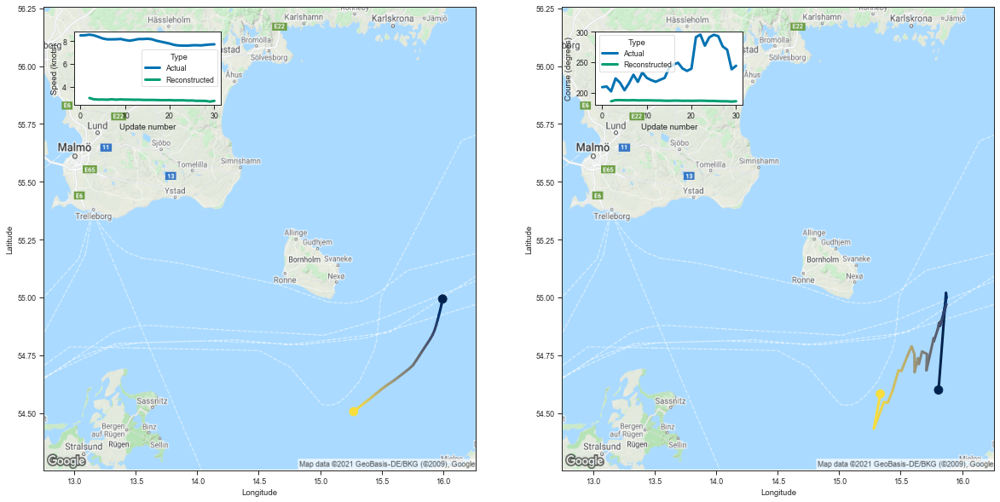

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.808313  54.599384  3.027480  185.711304         0.047580   
3   15.868873  55.019020  2.912462  187.503357         0.035486   
4   15.872988  54.999573  2.888369  187.580643         0.033023   
5   15.850616  54.936287  2.892270  187.396667         0.033217   
6   15.840791  54.905922  2.877438  187.253174         0.032826   
7   15.870688  54.970173  2.911614  187.514206         0.033638   
8   15.819612  54.876160  2.881544  187.123734         0.033200   
9   15.834728  54.900791  2.903728  187.248337         0.033576   
10  15.811257  54.888233  2.887389  187.234909         0.033393   
11  15.803052  54.864594  2.884761  187.121368         0.033515   
12  15.771036  54.810638  2.873339  186.926514         0.033225   
13  15.768699  54.823421  2.878324  186.921448         0.033440   
14  15.728836  54.729275  2.860249  186.552368         0.033407   
15  15.709847  54.684769  2.855817  186.506439         0.03347

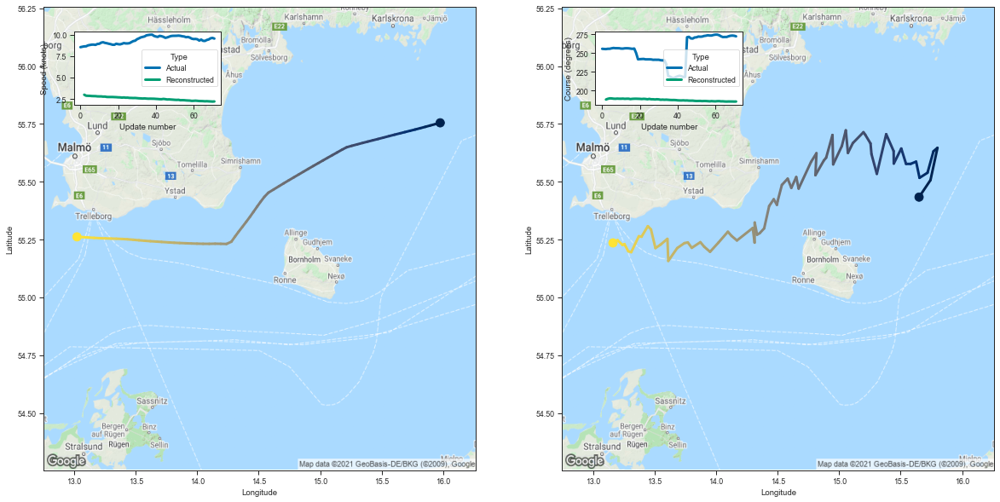

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.649798  55.433525  3.005331  187.909363         0.049394   
3   15.742672  55.507076  2.891431  188.887726         0.034643   
4   15.799505  55.646511  2.878266  189.476166         0.032979   
5   15.767080  55.631828  2.872682  189.400391         0.032601   
6   15.718686  55.538891  2.850163  189.045715         0.032181   
..        ...        ...       ...         ...              ...   
67  13.254629  55.230618  2.251642  185.312347         0.034299   
68  13.239028  55.226238  2.235515  185.278870         0.033556   
69  13.198674  55.247536  2.223994  185.255539         0.033632   
70  13.174863  55.234024  2.208371  185.184586         0.033756   
71  13.161538  55.235474  2.221967  185.244507         0.033997   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.153530     3.203886    100.658478                 1   
3         0.084533     3.097287    101.282555                

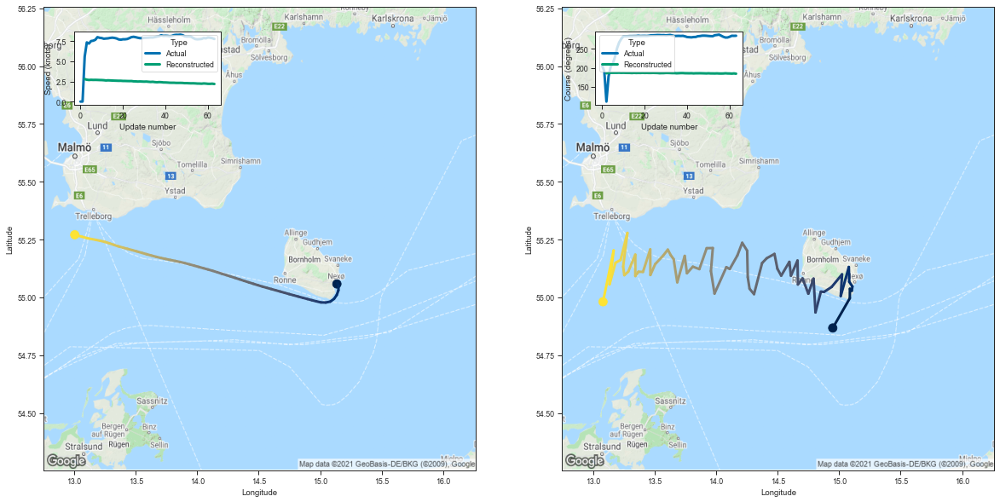

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.948213  54.867516  2.794993  185.548737         0.046775   
3   15.086952  54.996052  2.718264  186.604889         0.034797   
4   15.087675  55.037029  2.682765  186.770187         0.033000   
5   15.102786  55.028267  2.703083  186.829163         0.033001   
6   15.108162  55.047115  2.689875  186.885284         0.032387   
..        ...        ...       ...         ...              ...   
59  13.223297  55.161572  2.235081  185.046066         0.034210   
60  13.182152  55.149601  2.206312  184.950638         0.033688   
61  13.133677  55.055973  2.204047  184.616623         0.034223   
62  13.167182  55.202946  2.222301  185.129303         0.034572   
63  13.080583  54.980854  2.184525  184.390915         0.033883   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.124097     3.221889     99.458069                 1   
3         0.077904     3.125118    100.090866                

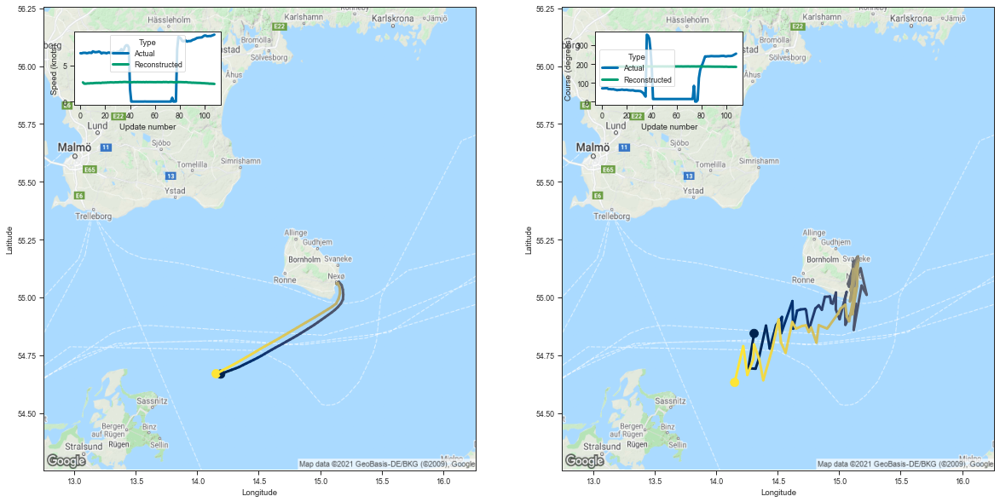

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.308740  54.843979  2.669589  184.726044         0.049277   
3    14.261859  54.693428  2.495978  184.756531         0.035303   
4    14.320520  54.691196  2.482895  184.844559         0.033182   
5    14.343603  54.727608  2.499971  185.001297         0.033464   
6    14.405484  54.877647  2.530579  185.560867         0.033256   
..         ...        ...       ...         ...              ...   
104  14.308092  54.796562  2.482591  185.198166         0.032776   
105  14.302801  54.732224  2.493520  185.003876         0.033275   
106  14.253942  54.664566  2.476217  184.735397         0.033122   
107  14.220313  54.788918  2.476130  185.057968         0.033505   
108  14.150673  54.632111  2.447316  184.480347         0.033157   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.125755     3.308771     99.020271                 1   
3          0.067490     3.216223     99.148933 

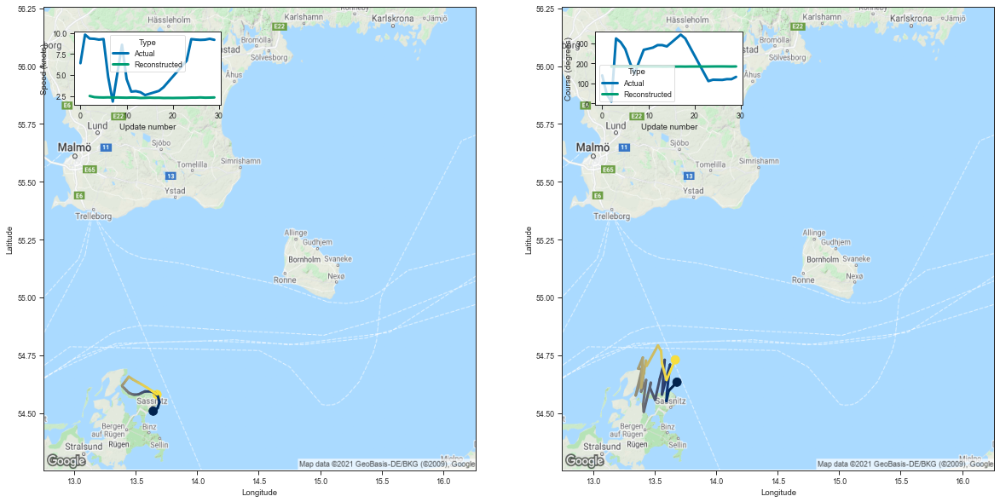

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.682130  54.633266  2.494824  183.389938         0.049281   
3   13.613479  54.595329  2.358167  183.614517         0.036823   
4   13.596176  54.550922  2.326403  183.593719         0.034678   
5   13.600561  54.590134  2.313221  183.739761         0.033698   
6   13.625393  54.709248  2.329860  184.111450         0.033739   
7   13.559785  54.579567  2.307744  183.704712         0.033355   
8   13.582204  54.729717  2.315792  184.113754         0.033745   
9   13.541759  54.645794  2.299034  183.813599         0.033551   
10  13.504108  54.556404  2.287856  183.581818         0.033738   
11  13.462040  54.609562  2.307714  183.696777         0.034021   
12  13.469035  54.630978  2.297062  183.741501         0.034079   
13  13.411849  54.505054  2.259202  183.225845         0.033798   
14  13.406942  54.536007  2.268145  183.343170         0.033793   
15  13.431271  54.642590  2.292375  183.714645         0.03420

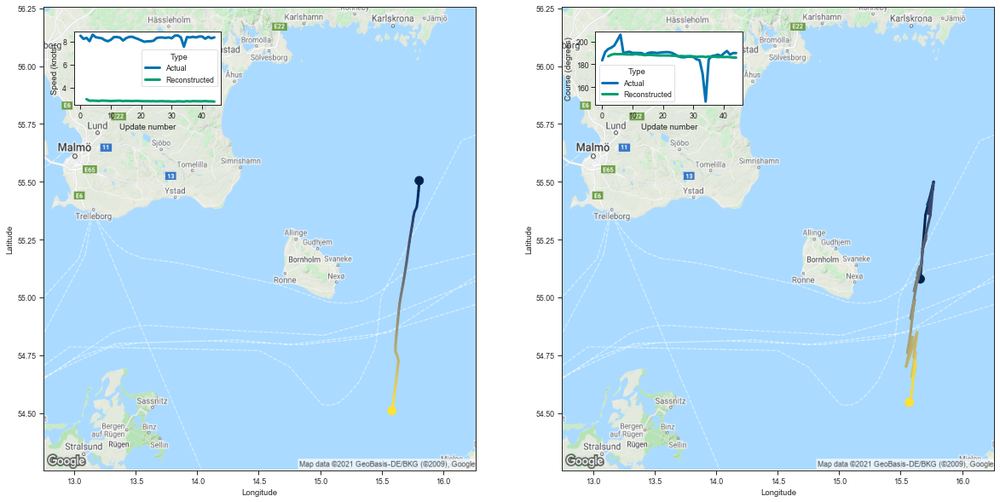

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.659883  55.079582  3.006938  186.993530         0.048632   
3   15.701919  55.355770  2.871064  188.361862         0.035041   
4   15.768240  55.499828  2.883482  189.015366         0.033304   
5   15.753610  55.449326  2.871249  188.821793         0.032541   
6   15.765807  55.483746  2.853329  188.946976         0.032346   
7   15.760836  55.467747  2.885892  188.843109         0.033315   
8   15.717975  55.401463  2.878485  188.659470         0.033275   
9   15.740067  55.403389  2.865593  188.631531         0.033029   
10  15.725504  55.361427  2.847009  188.519684         0.032327   
11  15.764992  55.493446  2.863685  188.990204         0.032787   
12  15.741651  55.355045  2.869178  188.577377         0.032690   
13  15.724029  55.316078  2.877490  188.422226         0.033124   
14  15.677249  55.209778  2.843040  187.998428         0.032526   
15  15.704017  55.250637  2.862842  188.217331         0.03276

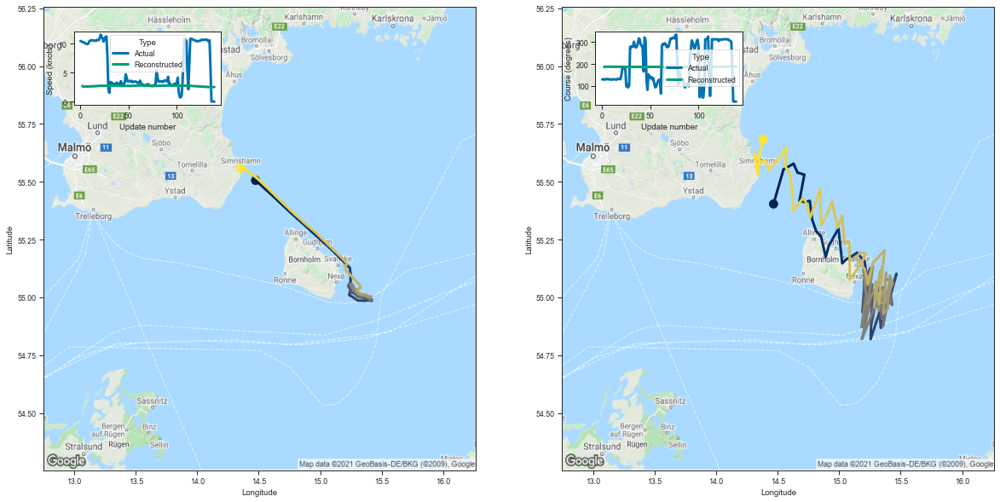

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.466611  55.403999  2.716467  186.568039         0.049326   
3    14.547904  55.553261  2.572216  187.666794         0.034620   
4    14.629343  55.577961  2.571557  187.868790         0.032958   
5    14.662199  55.539417  2.586636  187.813766         0.033057   
6    14.717369  55.530415  2.613423  187.921249         0.033228   
..         ...        ...       ...         ...              ...   
135  14.308561  55.622108  2.496447  187.697952         0.032922   
136  14.342690  55.527714  2.501840  187.490067         0.032855   
137  14.356075  55.629768  2.515120  187.692184         0.033320   
138  14.355029  55.622444  2.511852  187.739151         0.033332   
139  14.382717  55.683067  2.524164  188.004852         0.032910   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.130575     3.350498     99.996048                 1   
3          0.070111     3.270270    100.687263 

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-791.940674,-14.665568
101,101,1176042,211755650,Fishing,30,-273.025940,-9.100865
97,97,7993496,273513600,Fishing,68,-551.860107,-8.115590
1,1,4547326,261061000,Fishing,31,-234.735107,-7.572100
6,6,7960421,273294000,Fishing,72,-534.500000,-7.423611
37,37,1615516,220339000,Fishing,64,-457.565125,-7.149455
69,69,461902,211317720,Fishing,109,-743.985779,-6.825558
73,73,1113112,211542610,Fishing,30,-201.934128,-6.731138
71,71,4377660,261015270,Fishing,45,-296.966614,-6.599258
91,91,5598936,265750000,Fishing,140,-894.997192,-6.392837


In [10]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    #print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
    print(tracks['Reconstructed trajectory'])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM4NEW_lr3e-05.pth


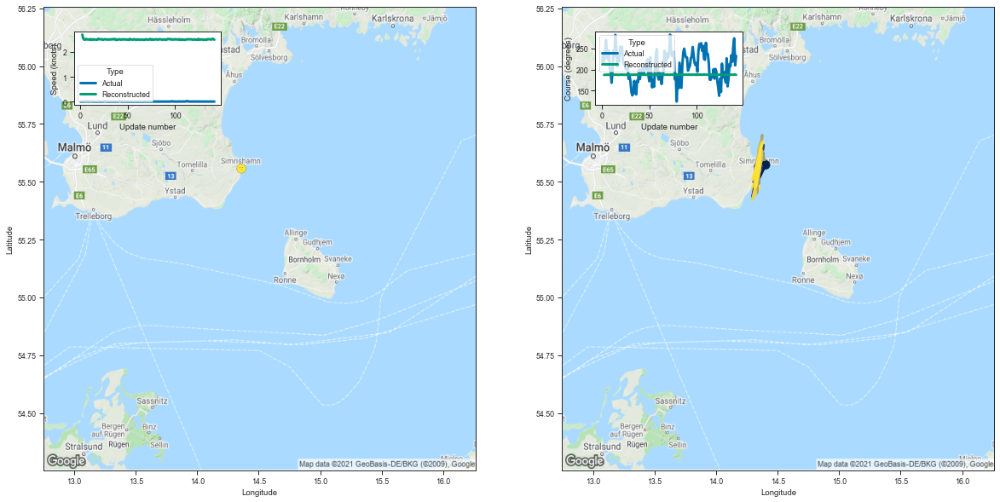

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.402532  55.572731  2.702023  187.063187         0.049685   
3    14.364401  55.530811  2.546306  187.396271         0.035077   
4    14.340280  55.502293  2.498106  187.316528         0.032924   
5    14.348464  55.608543  2.501462  187.723633         0.032429   
6    14.328321  55.530262  2.528625  187.430130         0.033094   
..         ...        ...       ...         ...              ...   
138  14.357969  55.609058  2.505916  187.694061         0.032881   
139  14.297383  55.510441  2.503155  187.394577         0.033190   
140  14.377969  55.671322  2.536736  188.001602         0.033631   
141  14.362507  55.647327  2.522660  187.875137         0.033125   
142  14.322222  55.475079  2.497676  187.232529         0.033315   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.131296     3.379594    100.254219                 1   
3          0.072119     3.277716    100.538132 

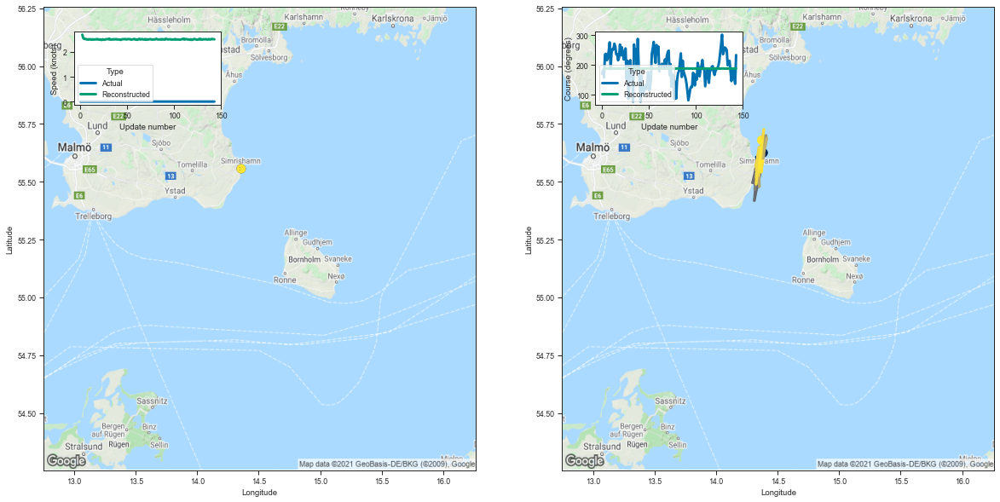

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.383432  55.625225  2.701709  187.076721         0.050563   
3    14.383570  55.649025  2.563164  187.814392         0.035624   
4    14.338450  55.522163  2.528145  187.438019         0.033734   
5    14.376981  55.612446  2.526191  187.725601         0.033195   
6    14.364574  55.585354  2.526208  187.703125         0.033329   
..         ...        ...       ...         ...              ...   
139  14.350405  55.542217  2.506071  187.500031         0.032497   
140  14.368562  55.542110  2.526883  187.586639         0.033400   
141  14.379272  55.591087  2.523107  187.659958         0.033400   
142  14.351171  55.557400  2.517653  187.516312         0.033451   
143  14.369871  55.679573  2.510581  187.971054         0.032516   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.136973     3.387120    100.243103                 1   
3          0.075407     3.280845    100.746376 

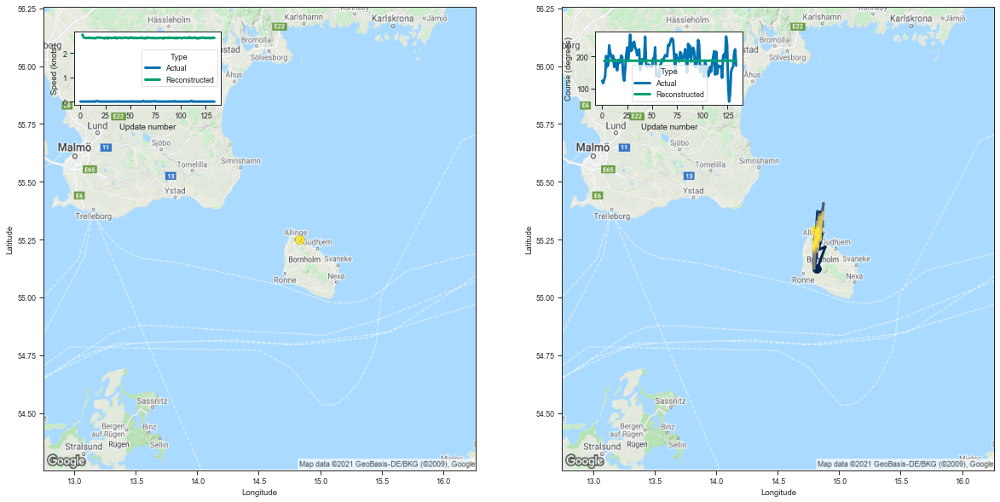

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.820640  55.122406  2.759769  186.165710         0.046678   
3    14.887865  55.218491  2.663300  187.099030         0.034746   
4    14.835001  55.206478  2.624603  187.021317         0.032844   
5    14.862733  55.276051  2.625941  187.349274         0.032273   
6    14.816997  55.228634  2.613409  187.068771         0.032443   
..         ...        ...       ...         ...              ...   
130  14.828377  55.302227  2.609863  187.381653         0.031981   
131  14.828238  55.299877  2.621312  187.305862         0.032706   
132  14.792744  55.216621  2.615382  187.097244         0.032549   
133  14.835240  55.262627  2.637062  187.178665         0.033227   
134  14.809852  55.291458  2.624777  187.244797         0.032774   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.120390     3.279909     99.796707                 1   
3          0.074758     3.172248    100.364517 

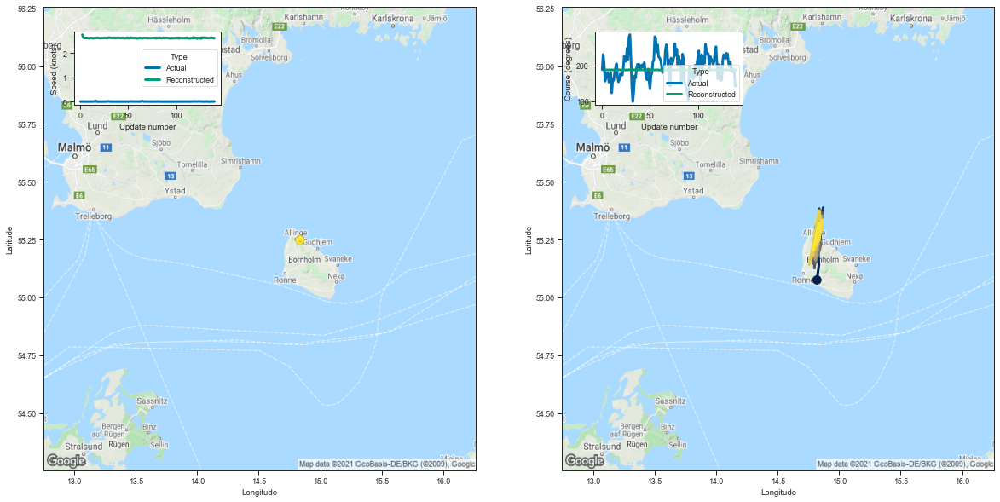

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.819787  55.075260  2.762707  186.048080         0.046543   
3    14.836054  55.141888  2.636303  186.748627         0.034436   
4    14.825282  55.238914  2.626999  187.070084         0.033119   
5    14.815273  55.225212  2.617021  187.024979         0.032891   
6    14.792777  55.186127  2.634350  186.975311         0.032704   
..         ...        ...       ...         ...              ...   
136  14.862369  55.334126  2.632252  187.456421         0.032879   
137  14.827765  55.253853  2.637717  187.276382         0.032408   
138  14.817880  55.252838  2.629228  187.163315         0.032804   
139  14.789077  55.203999  2.609926  187.016678         0.032561   
140  14.836151  55.321625  2.623303  187.405792         0.032638   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.121021     3.267587     99.722961                 1   
3          0.071838     3.184255    100.185173 

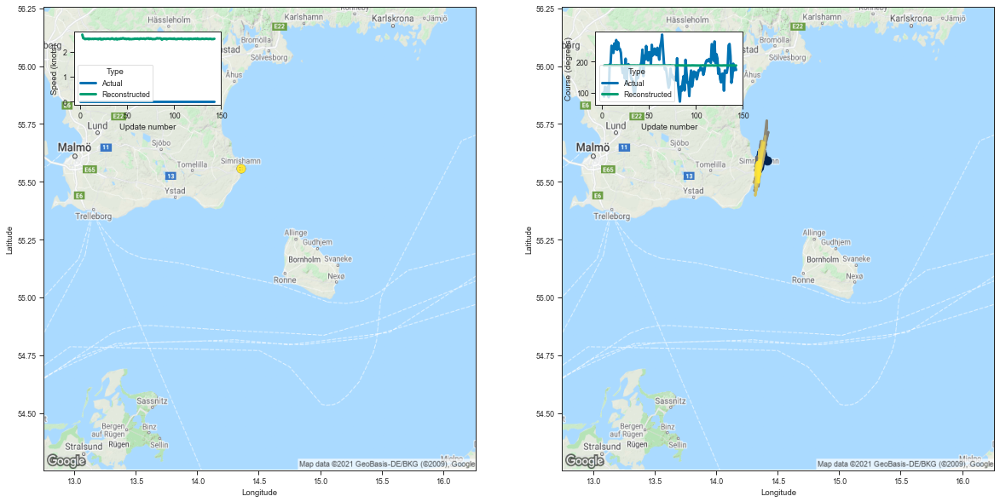

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.417951  55.589893  2.679959  187.066589         0.047968   
3    14.400453  55.626247  2.535552  187.699997         0.034786   
4    14.377805  55.556126  2.525166  187.622131         0.033315   
5    14.354141  55.536232  2.498260  187.457352         0.032798   
6    14.373822  55.596767  2.513413  187.694580         0.032893   
..         ...        ...       ...         ...              ...   
139  14.361116  55.590549  2.512359  187.711548         0.032690   
140  14.360103  55.559021  2.499601  187.500488         0.032931   
141  14.338449  55.584209  2.502722  187.607285         0.032792   
142  14.345891  55.497562  2.502946  187.340836         0.033052   
143  14.352545  55.592373  2.513978  187.634171         0.032821   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.122435     3.386642    100.268524                 1   
3          0.070531     3.291829    100.705566 

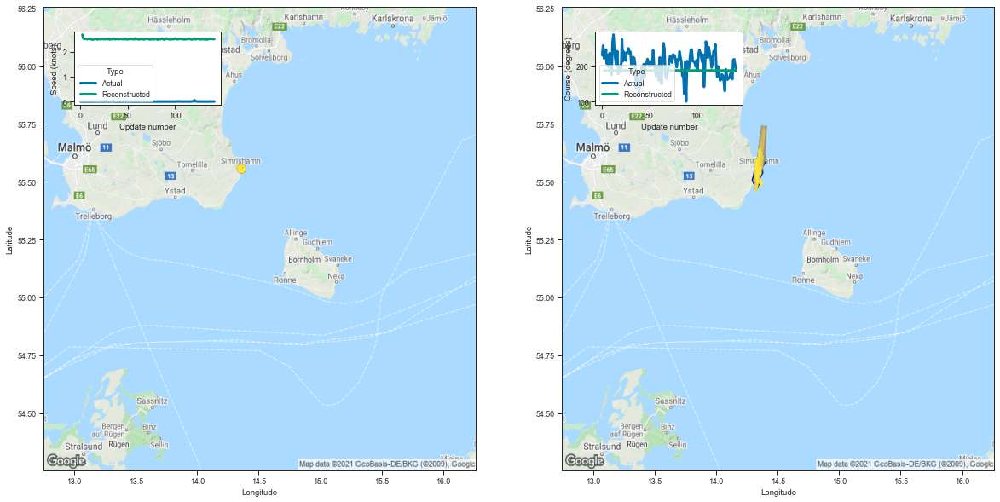

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.362497  55.583286  2.686892  187.079361         0.048855   
3    14.366761  55.591988  2.539106  187.606628         0.034925   
4    14.367264  55.546799  2.520657  187.538162         0.033415   
5    14.366493  55.586990  2.513819  187.614044         0.033126   
6    14.350842  55.543240  2.522000  187.470581         0.033374   
..         ...        ...       ...         ...              ...   
138  14.359204  55.534317  2.513524  187.504303         0.032875   
139  14.356149  55.561604  2.519927  187.606491         0.033018   
140  14.329740  55.515022  2.517211  187.388138         0.033499   
141  14.326486  55.598804  2.507660  187.647232         0.033095   
142  14.342298  55.495468  2.511000  187.277191         0.033066   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.127492     3.373493    100.268135                 1   
3          0.070158     3.281432    100.653534 

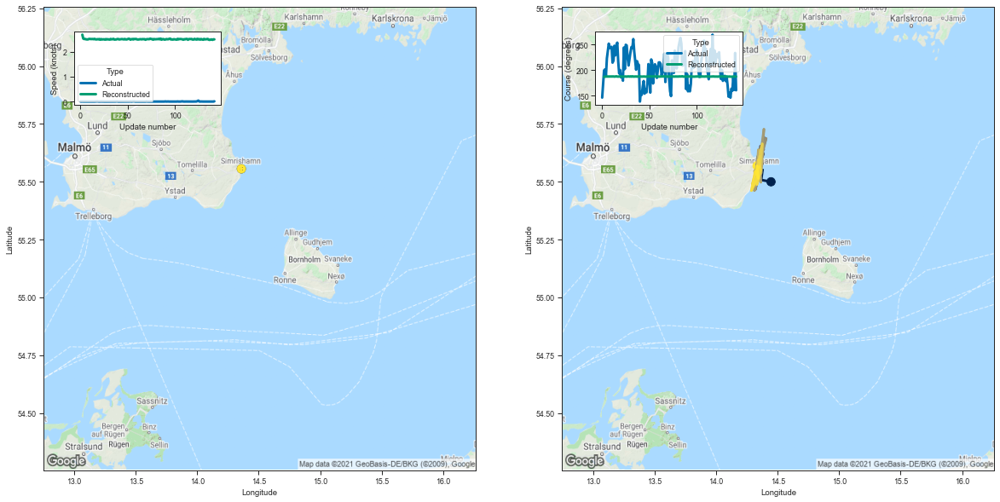

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.446295  55.499847  2.694104  186.851257         0.047693   
3    14.366601  55.507759  2.535614  187.298935         0.035236   
4    14.377602  55.551239  2.516651  187.521942         0.033296   
5    14.357273  55.543331  2.520828  187.538925         0.033159   
6    14.341047  55.555447  2.504747  187.524765         0.032914   
..         ...        ...       ...         ...              ...   
138  14.317804  55.543652  2.492793  187.405045         0.032918   
139  14.350539  55.564041  2.503431  187.512283         0.033188   
140  14.321069  55.541908  2.483503  187.461105         0.032299   
141  14.341994  55.514725  2.506122  187.417236         0.033114   
142  14.333030  55.568939  2.502399  187.540466         0.032827   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.123786     3.351305    100.148682                 1   
3          0.070990     3.284883    100.481079 

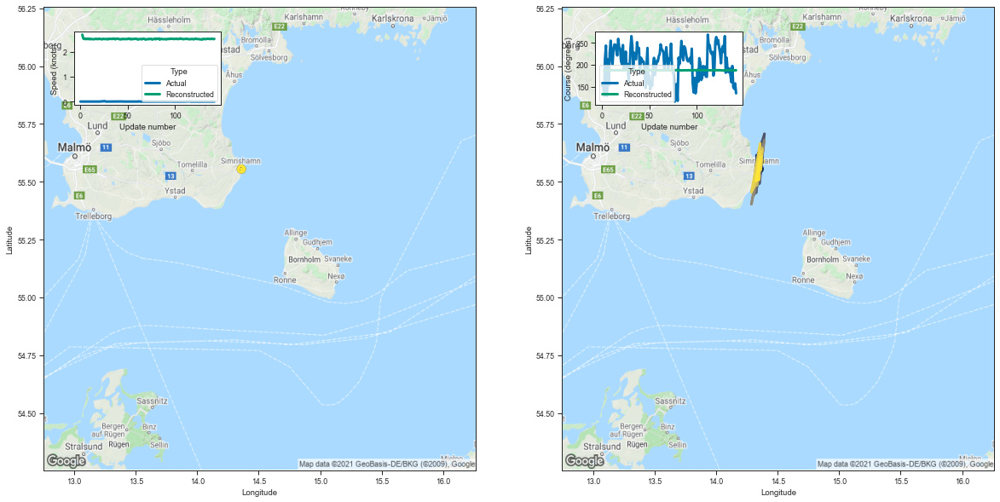

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.349984  55.555332  2.681877  186.868225         0.049456   
3    14.369709  55.554504  2.529347  187.450790         0.035456   
4    14.336597  55.484394  2.505356  187.259171         0.033439   
5    14.342115  55.546303  2.522285  187.489868         0.033456   
6    14.337840  55.523506  2.499354  187.417450         0.032948   
..         ...        ...       ...         ...              ...   
138  14.354687  55.604599  2.504614  187.705521         0.032540   
139  14.345332  55.577866  2.520587  187.609421         0.032871   
140  14.348962  55.509781  2.510106  187.376022         0.033358   
141  14.322704  55.503746  2.500388  187.368988         0.032874   
142  14.356002  55.589748  2.511832  187.640350         0.032872   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.129196     3.381003    100.154694                 1   
3          0.070837     3.296095    100.568489 

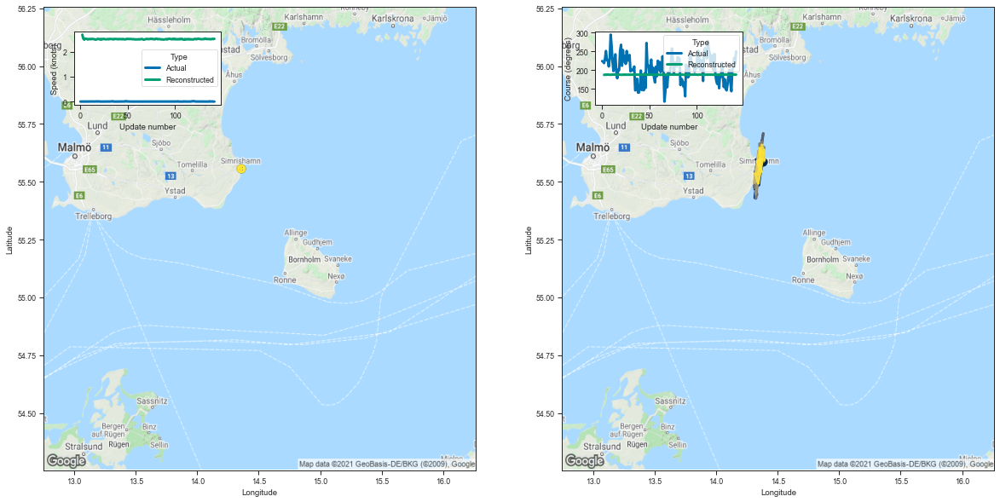

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.381233  55.584961  2.691219  187.042694         0.049011   
3    14.355341  55.611080  2.534939  187.590134         0.035412   
4    14.346852  55.485554  2.489488  187.262283         0.032531   
5    14.378963  55.605049  2.523838  187.770203         0.033242   
6    14.381021  55.648251  2.527573  187.872742         0.033242   
..         ...        ...       ...         ...              ...   
138  14.384396  55.618610  2.505761  187.741714         0.032804   
139  14.353113  55.645058  2.509597  187.830826         0.033086   
140  14.367146  55.543896  2.523502  187.535995         0.033114   
141  14.334572  55.587849  2.512035  187.600937         0.032763   
142  14.366879  55.598240  2.523859  187.660309         0.033335   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.128557     3.375860    100.249847                 1   
3          0.071355     3.296864    100.643021 

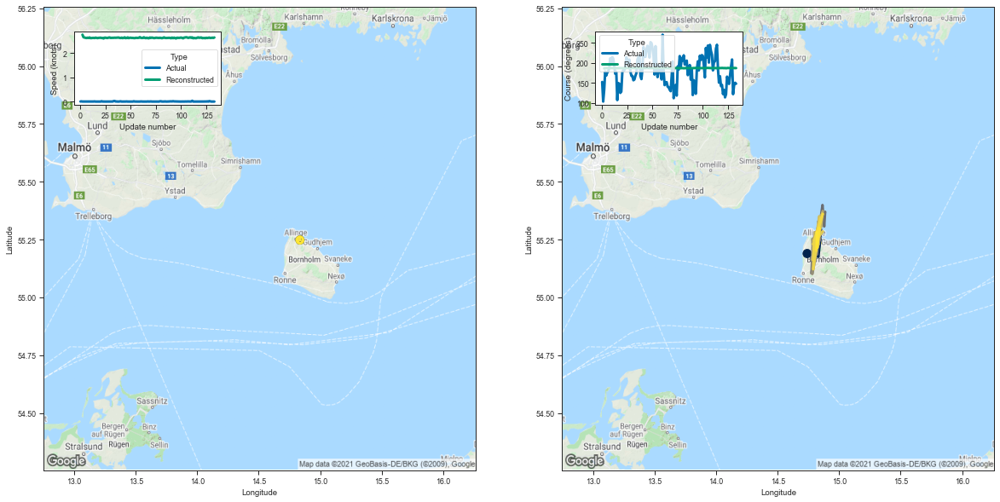

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.740293  55.189476  2.754499  186.240601         0.047457   
3    14.831239  55.176224  2.649430  186.862915         0.034684   
4    14.849678  55.262924  2.633384  187.262299         0.033319   
5    14.845772  55.250919  2.624525  187.143906         0.032804   
6    14.815002  55.242641  2.614313  187.125473         0.032730   
..         ...        ...       ...         ...              ...   
129  14.833779  55.299526  2.616292  187.378464         0.032234   
130  14.841043  55.298092  2.620514  187.328583         0.032201   
131  14.823002  55.215454  2.630313  187.137222         0.032728   
132  14.818809  55.282913  2.617978  187.223999         0.032617   
133  14.818938  55.235283  2.637078  187.126740         0.032946   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.124949     3.293783     99.816856                 1   
3          0.074105     3.182485    100.237404 

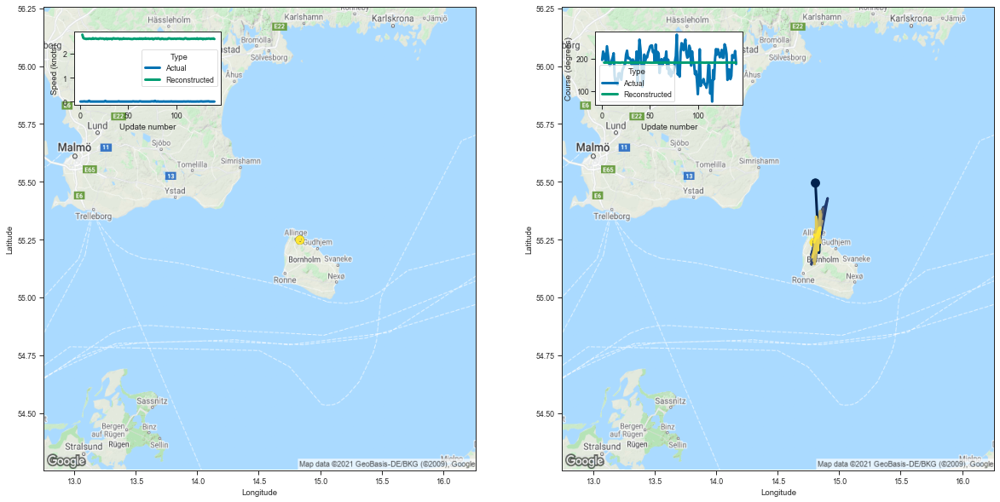

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.807385  55.494385  2.796252  187.187637         0.049335   
3    14.836695  55.193623  2.655446  186.970291         0.034866   
4    14.843013  55.264923  2.630045  187.287460         0.032802   
5    14.840943  55.229187  2.627893  187.197189         0.032328   
6    14.825804  55.256012  2.612354  187.123413         0.032490   
..         ...        ...       ...         ...              ...   
136  14.799243  55.270988  2.615939  187.244568         0.032333   
137  14.825985  55.257805  2.631227  187.214691         0.032683   
138  14.842446  55.276123  2.624371  187.219666         0.032500   
139  14.840512  55.299366  2.636684  187.285202         0.033209   
140  14.796422  55.237587  2.612692  187.164337         0.032378   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.137599     3.319289    100.304413                 1   
3          0.073567     3.179573    100.295166 

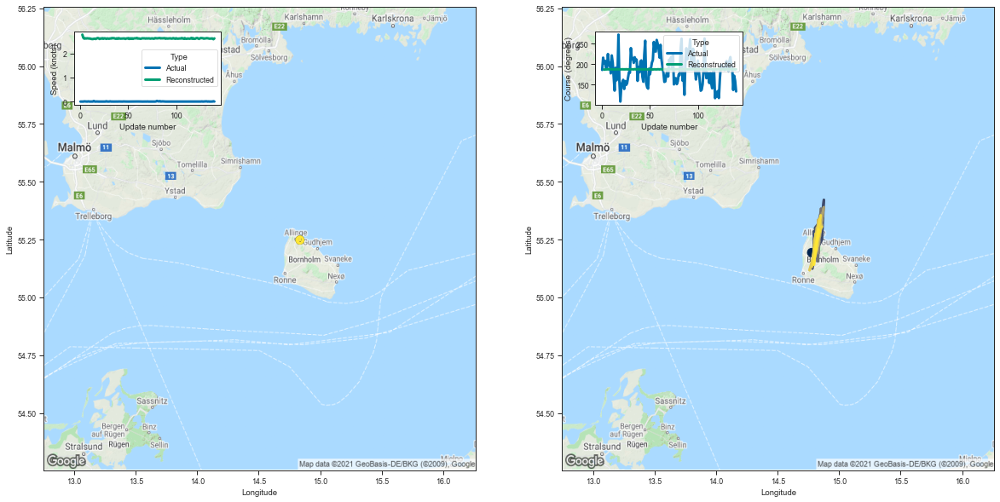

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.776278  55.193775  2.784035  186.261414         0.048525   
3    14.825242  55.248703  2.655610  187.042831         0.034759   
4    14.824852  55.199211  2.617684  186.962433         0.032610   
5    14.822179  55.236610  2.632730  187.196289         0.032697   
6    14.828095  55.280186  2.622229  187.294464         0.032498   
..         ...        ...       ...         ...              ...   
136  14.801349  55.210320  2.620845  187.029510         0.032790   
137  14.841026  55.287254  2.622941  187.288193         0.032613   
138  14.821284  55.255810  2.625429  187.155823         0.032921   
139  14.794732  55.141785  2.593172  186.763474         0.032217   
140  14.832184  55.294525  2.627406  187.334854         0.032732   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.133812     3.274809     99.821693                 1   
3          0.074624     3.186755    100.334839 

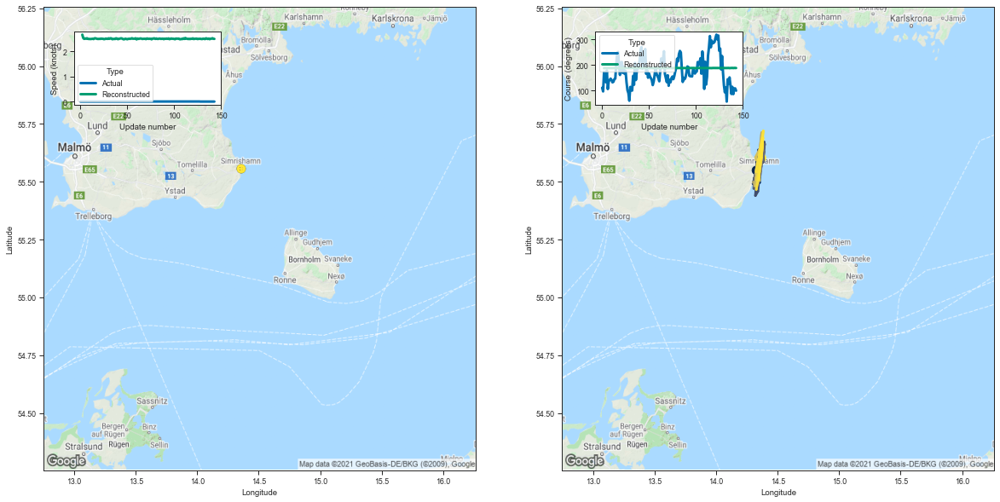

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.326763  55.549175  2.675102  186.887924         0.048875   
3    14.361543  55.604488  2.539853  187.567535         0.035146   
4    14.353203  55.496040  2.504889  187.338242         0.033428   
5    14.329370  55.521755  2.522182  187.429489         0.033501   
6    14.347177  55.546249  2.512025  187.536057         0.032979   
..         ...        ...       ...         ...              ...   
139  14.383564  55.719940  2.511110  188.043137         0.032775   
140  14.344891  55.508125  2.515474  187.416504         0.032993   
141  14.380857  55.689850  2.530321  188.018448         0.033060   
142  14.366773  55.602856  2.509992  187.722031         0.032732   
143  14.369875  55.603260  2.504066  187.661041         0.032644   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126662     3.380117    100.167618                 1   
3          0.071080     3.298665    100.629486 

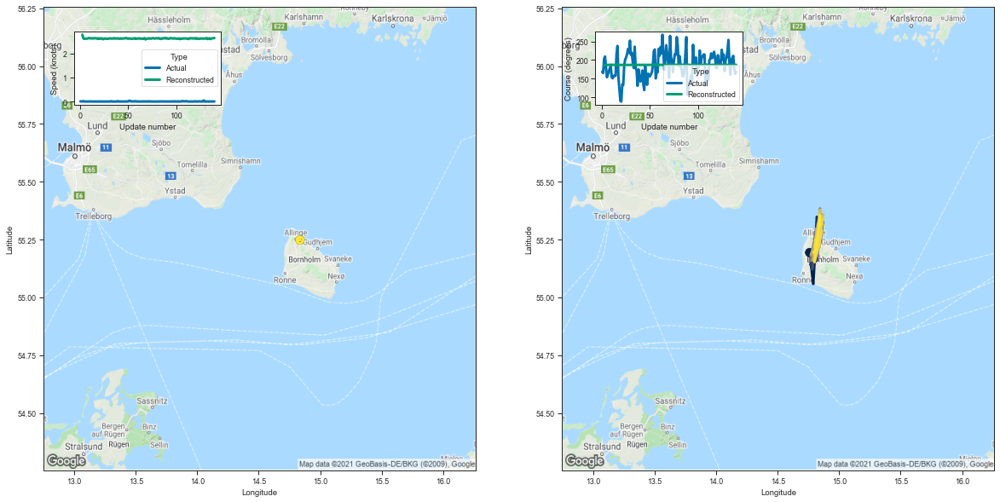

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.759912  55.193794  2.784460  186.292953         0.048416   
3    14.789906  55.058609  2.634175  186.524353         0.034278   
4    14.807903  55.223034  2.607814  187.100677         0.032438   
5    14.818000  55.234108  2.616991  187.133194         0.032384   
6    14.818797  55.259647  2.616745  187.210342         0.032421   
..         ...        ...       ...         ...              ...   
136  14.790726  55.194412  2.598259  186.948456         0.032310   
137  14.810018  55.202080  2.622515  187.083817         0.032720   
138  14.834763  55.301476  2.632825  187.388260         0.032746   
139  14.844195  55.354191  2.635430  187.581055         0.032433   
140  14.844460  55.311707  2.645115  187.374420         0.032779   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.134844     3.277573     99.822266                 1   
3          0.071484     3.165289    100.071747 

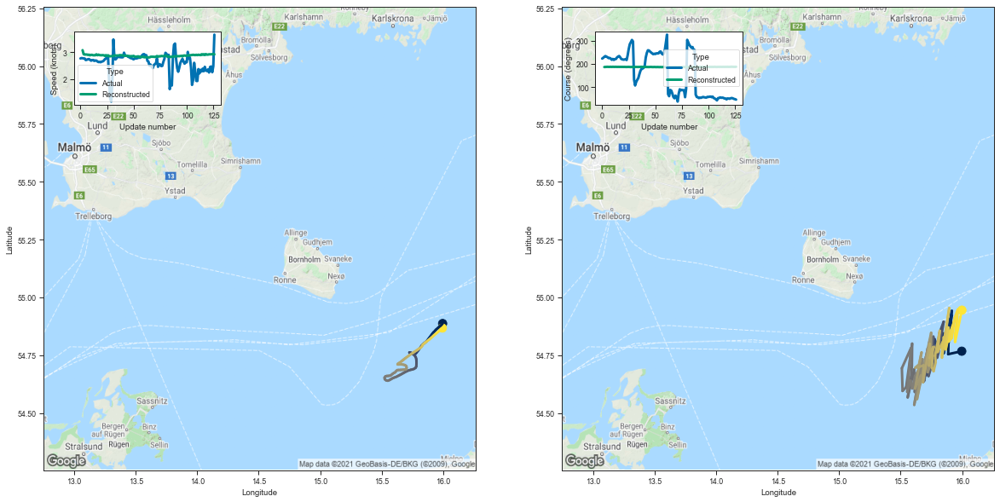

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.996880  54.767143  3.070501  186.384354         0.047871   
3    15.886853  54.754189  2.923702  186.748672         0.035066   
4    15.889232  54.811199  2.908478  187.103531         0.033156   
5    15.920559  54.886257  2.910222  187.377930         0.032933   
6    15.886889  54.820446  2.910733  187.026871         0.033498   
..         ...        ...       ...         ...              ...   
122  15.965207  54.947720  2.916097  187.551254         0.033042   
123  15.958487  54.899712  2.919997  187.393784         0.033087   
124  15.943627  54.841583  2.917790  187.219803         0.033132   
125  15.942610  54.807285  2.933994  187.177368         0.033651   
126  15.998130  54.944595  2.918725  187.532898         0.032973   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149127     3.083908     99.842064                 1   
3          0.087168     3.010831    100.125458 

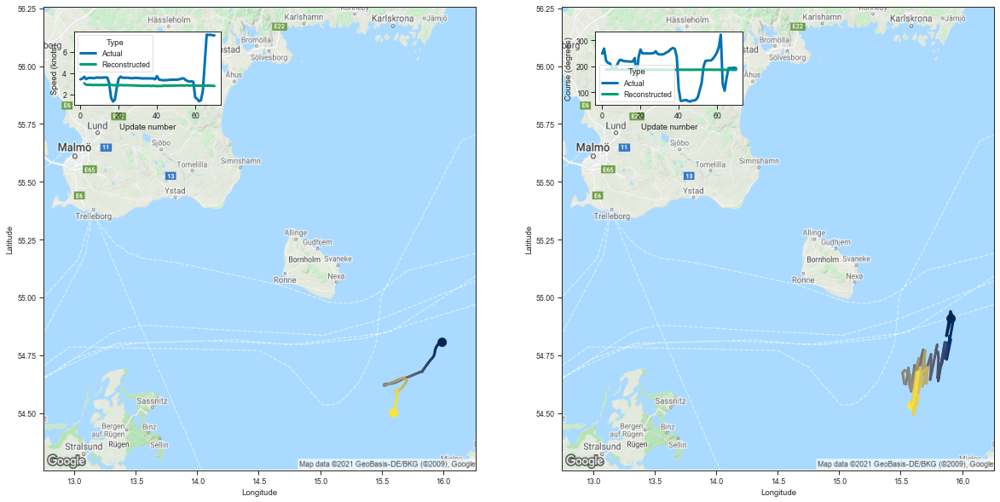

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.910207  54.908138  3.063366  186.695435         0.048797   
3   15.872267  54.834045  2.925621  186.929596         0.036162   
4   15.905800  54.938766  2.908629  187.412155         0.033831   
5   15.930142  54.907028  2.915550  187.434250         0.032848   
6   15.892718  54.797493  2.898047  186.964767         0.032947   
..        ...        ...       ...         ...              ...   
66  15.622817  54.583462  2.830864  186.073395         0.033109   
67  15.645852  54.678993  2.843651  186.342148         0.033481   
68  15.599787  54.534794  2.828079  185.883362         0.033069   
69  15.584870  54.530998  2.823933  185.921509         0.033042   
70  15.591263  54.533363  2.809035  185.891479         0.032763   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.153529     3.109465    100.007034                 1   
3         0.090807     3.026886    100.205376                

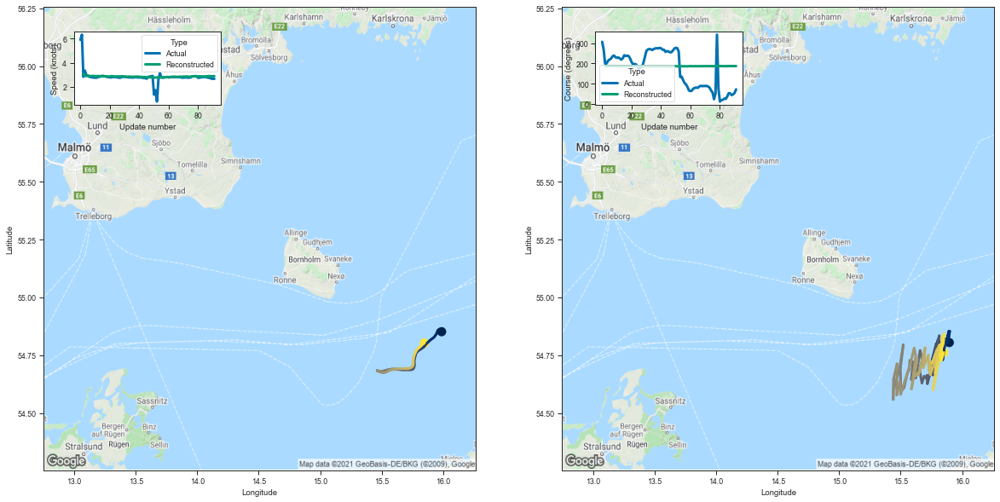

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.895349  54.804554  3.072009  186.373444         0.048587   
3   15.867986  54.820267  2.917456  186.980331         0.035184   
4   15.880882  54.822193  2.896401  187.065689         0.033468   
5   15.892341  54.853874  2.916674  187.172592         0.033509   
6   15.875935  54.804173  2.893510  187.070206         0.033068   
..        ...        ...       ...         ...              ...   
87  15.855623  54.841579  2.892205  187.083069         0.032963   
88  15.846607  54.800602  2.899363  186.989853         0.033530   
89  15.833146  54.779045  2.872634  186.895950         0.032904   
90  15.830739  54.727188  2.887211  186.790619         0.033422   
91  15.850991  54.762012  2.894860  186.869553         0.033211   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.154752     3.097713     99.830063                 1   
3         0.086344     3.013418    100.249603                

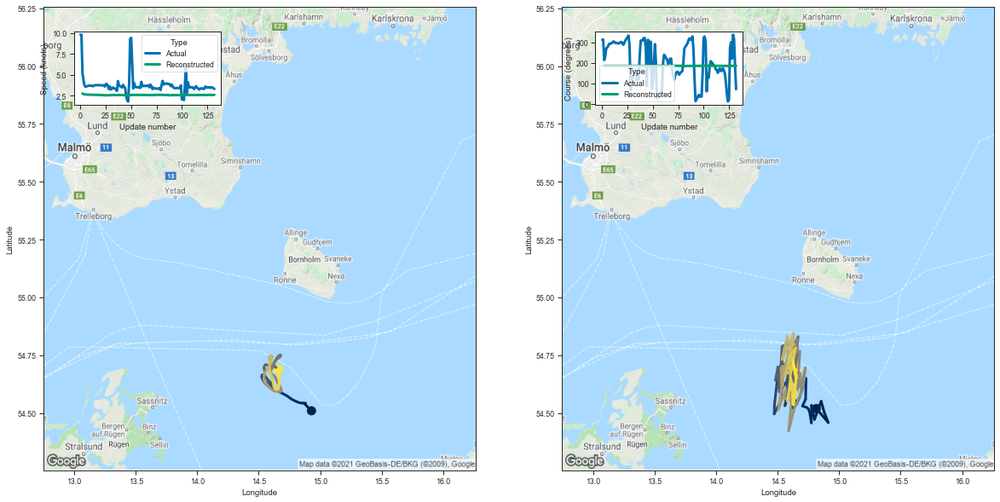

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.814335  54.519218  2.755067  184.401642         0.047170   
3    14.911654  54.458759  2.663996  184.771927         0.035279   
4    14.879128  54.502590  2.653990  184.977188         0.033663   
5    14.854064  54.550774  2.636600  185.099792         0.033124   
6    14.799430  54.471832  2.617012  184.797440         0.033192   
..         ...        ...       ...         ...              ...   
128  14.651791  54.652374  2.568067  185.164566         0.032225   
129  14.649782  54.647690  2.581842  185.124222         0.033034   
130  14.621902  54.729843  2.560468  185.374115         0.032880   
131  14.642628  54.678188  2.575001  185.187714         0.033285   
132  14.653615  54.687553  2.586104  185.336411         0.032540   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.118799     3.211820     98.859734                 1   
3          0.074448     3.099818     99.137390 

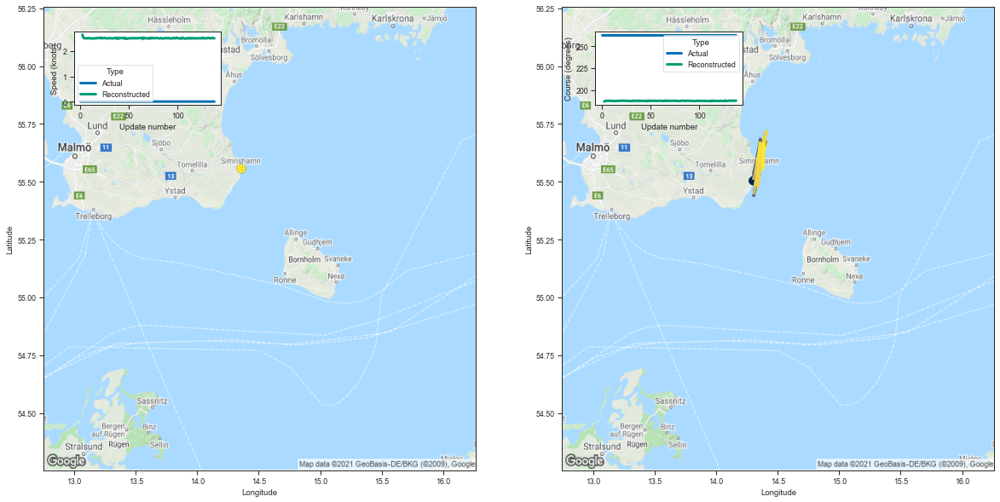

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.302011  55.504292  2.651865  186.799942         0.047131   
3    14.332921  55.576038  2.534086  187.467529         0.035224   
4    14.375892  55.605408  2.510571  187.713654         0.033137   
5    14.357100  55.583481  2.500636  187.633804         0.032676   
6    14.363584  55.583561  2.509811  187.679443         0.032614   
..         ...        ...       ...         ...              ...   
134  14.339191  55.588989  2.499435  187.594910         0.032720   
135  14.363728  55.640121  2.509223  187.825058         0.032999   
136  14.393970  55.654018  2.521518  187.930435         0.032704   
137  14.379512  55.555580  2.513374  187.547760         0.032703   
138  14.383085  55.666538  2.505037  187.864532         0.032795   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.117288     3.373074    100.144852                 1   
3          0.071238     3.296277    100.576210 

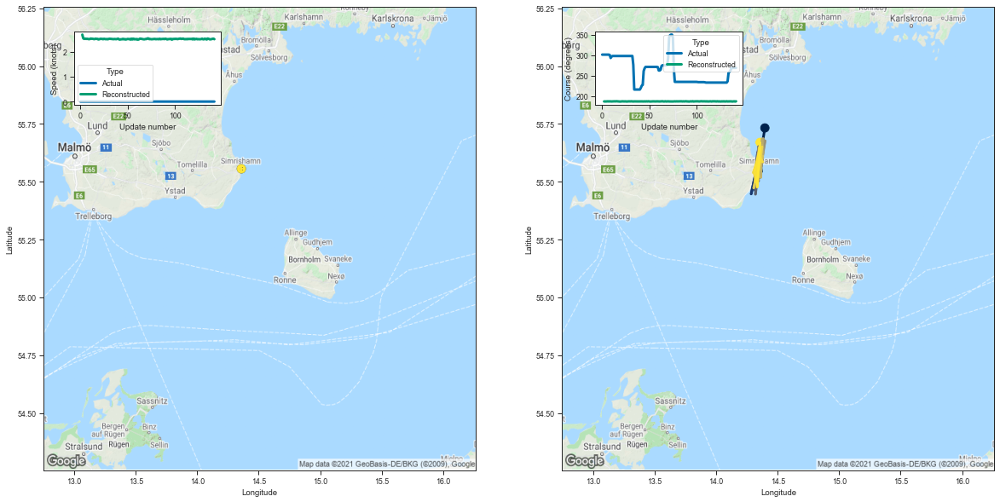

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.396410  55.732674  2.686373  187.481812         0.048970   
3    14.331700  55.514828  2.537218  187.364304         0.035041   
4    14.346157  55.536015  2.514568  187.414688         0.033285   
5    14.363403  55.556438  2.526831  187.556122         0.033369   
6    14.343169  55.603817  2.514476  187.739700         0.032839   
..         ...        ...       ...         ...              ...   
138  14.320688  55.498150  2.497678  187.271255         0.032909   
139  14.314522  55.550133  2.506517  187.522385         0.032759   
140  14.355970  55.646461  2.515683  187.803101         0.033126   
141  14.334098  55.477531  2.525245  187.253021         0.033790   
142  14.357223  55.670311  2.502820  187.848236         0.032633   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126951     3.391809    100.483727                 1   
3          0.071038     3.276036    100.514610 

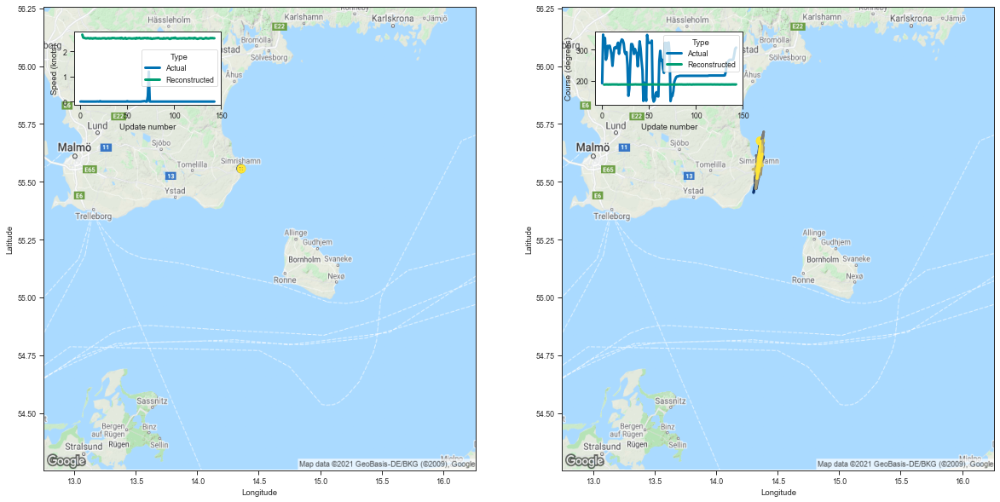

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.357138  55.604904  2.657182  187.065903         0.047724   
3    14.342520  55.588848  2.538804  187.534958         0.035647   
4    14.340716  55.533985  2.527665  187.464340         0.033692   
5    14.352253  55.596298  2.517027  187.696030         0.032645   
6    14.362234  55.600479  2.506324  187.632462         0.032928   
..         ...        ...       ...         ...              ...   
139  14.348080  55.621063  2.524637  187.831436         0.033057   
140  14.347711  55.572426  2.515075  187.621948         0.033110   
141  14.374726  55.620491  2.522204  187.775314         0.032930   
142  14.332366  55.514175  2.512937  187.372375         0.033655   
143  14.359722  55.676388  2.513133  187.915695         0.032753   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.121054     3.382076    100.263168                 1   
3          0.074392     3.291189    100.608124 

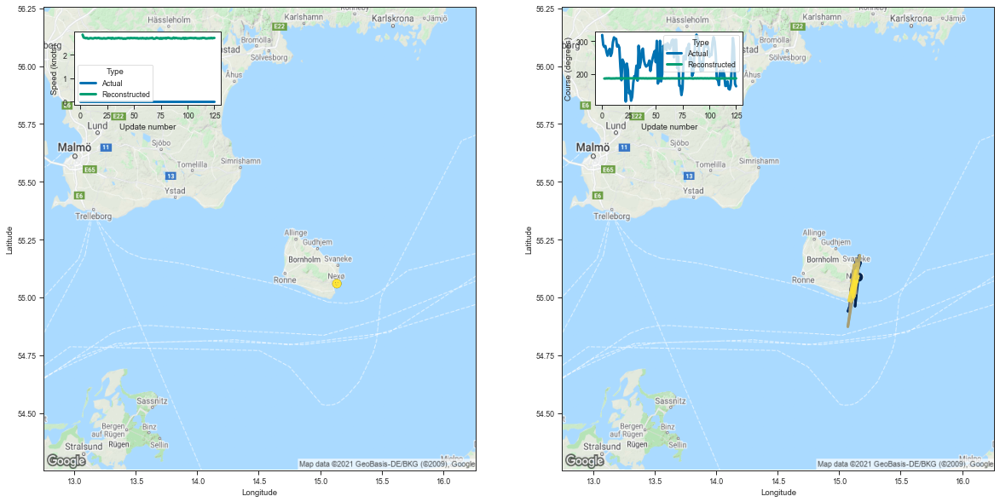

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.156430  55.087372  2.851089  186.496445         0.047098   
3    15.129883  54.961788  2.727818  186.592010         0.034461   
4    15.148654  55.082764  2.714060  187.062469         0.033172   
5    15.097364  55.039093  2.696851  186.860031         0.032908   
6    15.174744  55.149895  2.712134  187.279404         0.032448   
..         ...        ...       ...         ...              ...   
121  15.112179  55.000614  2.693625  186.719284         0.032690   
122  15.146728  55.071007  2.713777  187.005615         0.032640   
123  15.101178  55.021431  2.693087  186.725815         0.032699   
124  15.126448  55.064903  2.705670  186.902405         0.033003   
125  15.126013  55.071682  2.709975  186.947861         0.033033   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.129141     3.218583     99.945297                 1   
3          0.075951     3.111178    100.082748 

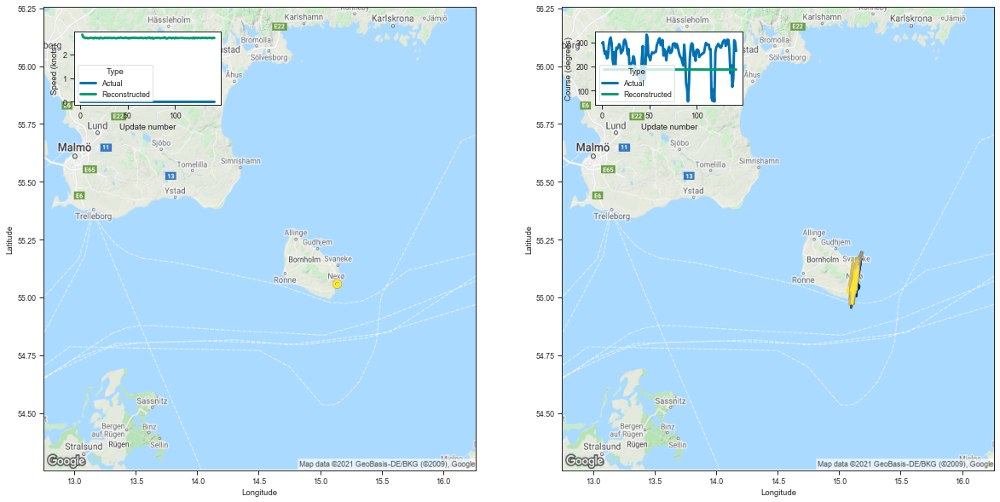

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.135360  55.045948  2.842961  186.357208         0.046021   
3    15.174074  55.150665  2.731701  187.247864         0.033969   
4    15.142273  55.042782  2.726427  186.949295         0.033205   
5    15.120108  55.091694  2.694835  187.065414         0.032135   
6    15.155749  55.156872  2.704145  187.233047         0.032706   
..         ...        ...       ...         ...              ...   
138  15.124134  55.066154  2.707283  186.990799         0.032716   
139  15.109509  55.038078  2.700496  186.894669         0.032300   
140  15.106401  54.973061  2.684588  186.640244         0.032522   
141  15.150758  55.120289  2.711037  187.125702         0.032854   
142  15.095153  55.029640  2.701818  186.926239         0.032528   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126049     3.205251     99.869621                 1   
3          0.074357     3.124661    100.437706 

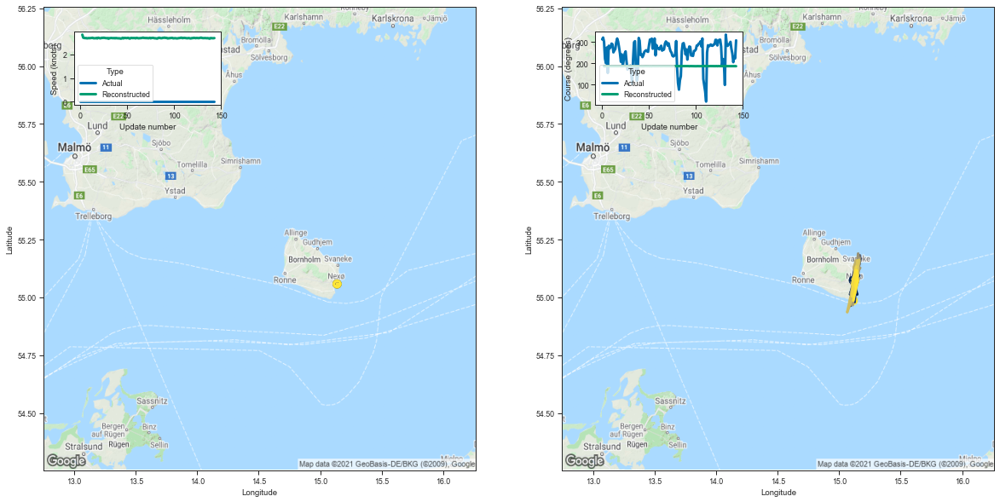

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.115352  55.073814  2.848004  186.448212         0.046896   
3    15.147049  55.013096  2.716976  186.713470         0.034347   
4    15.135807  55.014633  2.708055  186.772903         0.033058   
5    15.129006  55.033257  2.698744  186.869537         0.032557   
6    15.148418  55.079288  2.704130  187.006577         0.032582   
..         ...        ...       ...         ...              ...   
139  15.134266  55.117161  2.702962  187.115936         0.032491   
140  15.130848  55.045868  2.698673  186.846191         0.032617   
141  15.142995  55.116386  2.695229  187.127304         0.032269   
142  15.151339  55.071213  2.694719  186.989212         0.032311   
143  15.115240  54.985912  2.701557  186.738724         0.032633   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126965     3.217016     99.908157                 1   
3          0.074585     3.128200    100.159119 

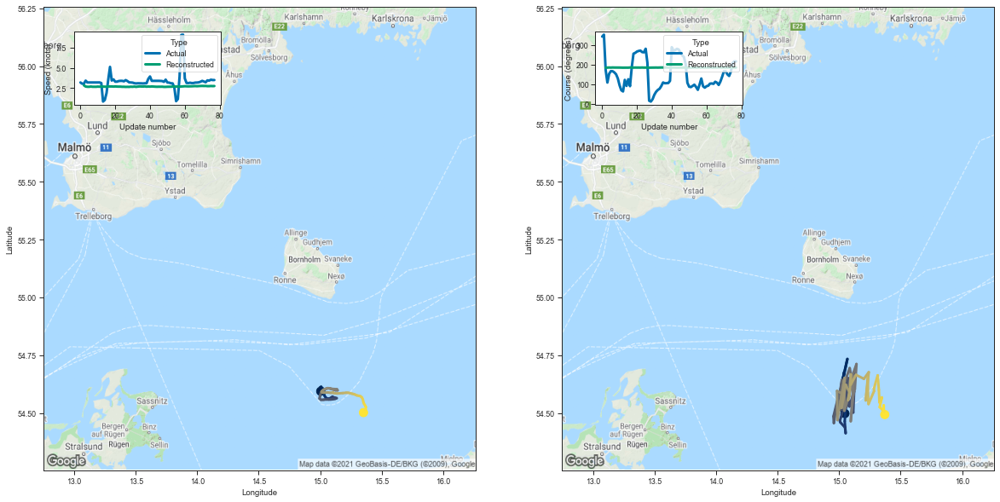

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.046994  54.497608  2.843799  184.557709         0.047994   
3   15.000353  54.518593  2.696534  185.043091         0.035078   
4   15.041354  54.677197  2.667582  185.693008         0.032778   
5   14.987789  54.539242  2.663482  185.235809         0.033001   
6   15.067212  54.733616  2.694876  185.851120         0.033424   
..        ...        ...       ...         ...              ...   
73  15.329962  54.525146  2.743765  185.560669         0.032562   
74  15.363583  54.507023  2.744892  185.520889         0.032885   
75  15.362624  54.533051  2.761984  185.647751         0.032736   
76  15.358969  54.496273  2.749985  185.506943         0.033119   
77  15.371145  54.493107  2.758922  185.467880         0.033326   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.132773     3.169083     98.907799                 1   
3         0.075928     3.085389     99.262329                

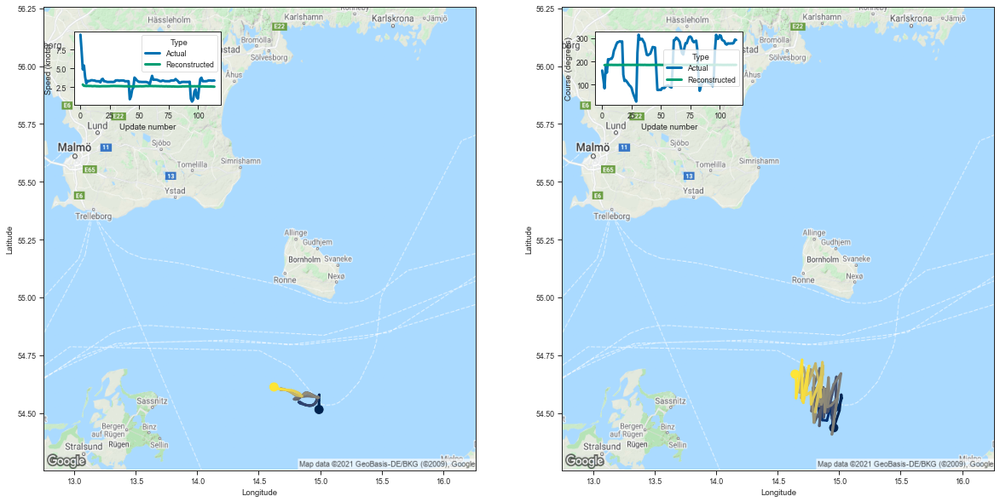

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.956181  54.436085  2.853806  184.215607         0.049922   
3    15.002870  54.510807  2.687250  185.004135         0.035186   
4    15.017529  54.578857  2.679648  185.380798         0.033428   
5    15.021183  54.564045  2.658122  185.313828         0.032469   
6    14.988219  54.515755  2.673465  185.142227         0.033126   
..         ...        ...       ...         ...              ...   
110  14.700196  54.552380  2.583434  184.871353         0.033023   
111  14.698844  54.729984  2.596823  185.545380         0.032715   
112  14.649821  54.563782  2.582281  184.963211         0.032892   
113  14.651052  54.643288  2.574904  185.175842         0.032707   
114  14.642220  54.667988  2.568371  185.199020         0.032902   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.143755     3.171868     98.714478                 1   
3          0.074014     3.107709     99.258209 

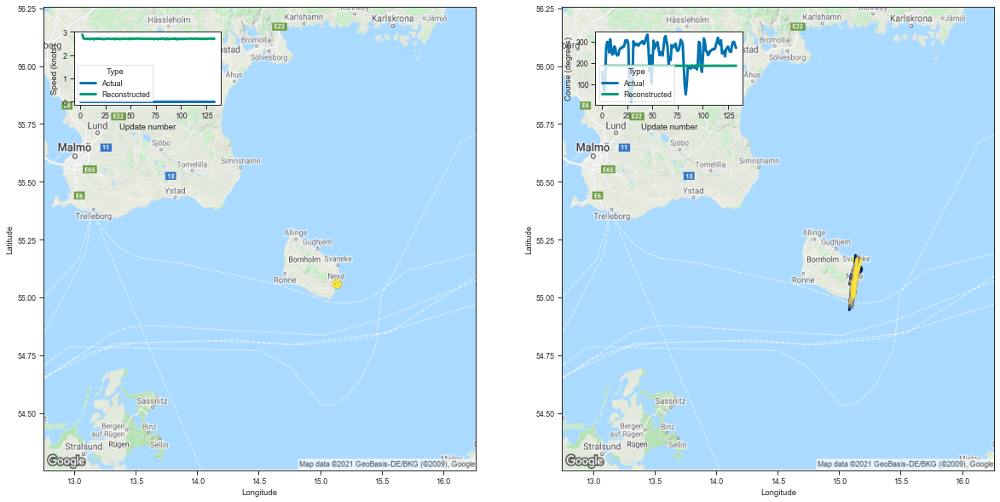

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.156292  55.121258  2.878796  186.466446         0.049004   
3    15.132957  55.181210  2.719309  187.193924         0.034479   
4    15.118400  55.067284  2.701280  186.978699         0.033098   
5    15.122807  55.073647  2.695533  186.961487         0.032650   
6    15.139078  55.091805  2.705643  187.093719         0.032455   
..         ...        ...       ...         ...              ...   
129  15.119405  55.045811  2.709456  186.873825         0.032813   
130  15.105708  55.021687  2.688807  186.802444         0.032200   
131  15.125824  55.045612  2.702494  186.899719         0.032618   
132  15.111808  55.004078  2.720533  186.738708         0.033483   
133  15.143425  55.161377  2.700555  187.342514         0.032161   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141685     3.229228     99.911667                 1   
3          0.075165     3.150511    100.412201 

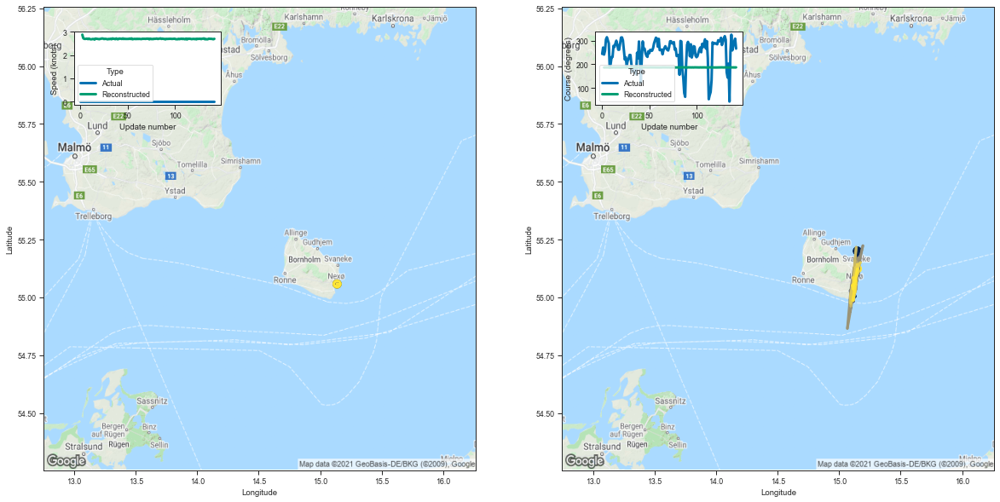

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.147992  55.200432  2.882860  186.680542         0.049284   
3    15.145405  55.098087  2.730008  186.996246         0.034569   
4    15.146554  55.083656  2.701199  187.020187         0.032599   
5    15.121311  55.013302  2.697703  186.737442         0.032897   
6    15.116389  55.034771  2.703846  186.818008         0.032784   
..         ...        ...       ...         ...              ...   
138  15.109957  54.986115  2.700929  186.754272         0.032471   
139  15.136946  55.070652  2.701227  187.026443         0.032490   
140  15.107270  55.051884  2.691341  186.900238         0.032722   
141  15.114336  55.035603  2.683621  186.850403         0.032495   
142  15.147417  55.123508  2.702720  187.122681         0.032781   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.142931     3.240746    100.022110                 1   
3          0.075790     3.136922    100.309151 

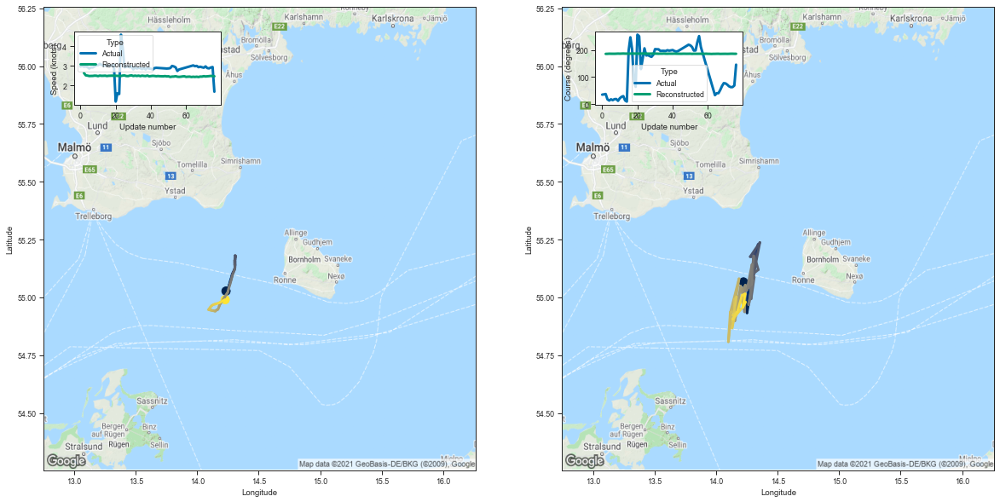

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.222345  55.066700  2.640081  185.296738         0.049210   
3   14.251311  54.932743  2.518239  185.489334         0.035887   
4   14.279349  55.024700  2.504347  185.927094         0.033567   
5   14.271592  54.992870  2.483419  185.773865         0.033010   
6   14.253196  54.992630  2.487223  185.714233         0.033521   
..        ...        ...       ...         ...              ...   
72  14.171710  54.936573  2.469401  185.490845         0.033333   
73  14.212317  55.009514  2.476993  185.805908         0.033096   
74  14.236085  55.014999  2.488874  185.798157         0.033377   
75  14.216519  54.956070  2.479957  185.558289         0.033463   
76  14.239409  54.979828  2.469648  185.621735         0.033335   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.122984     3.344266     99.322792                 1   
3         0.070926     3.240308     99.531075                

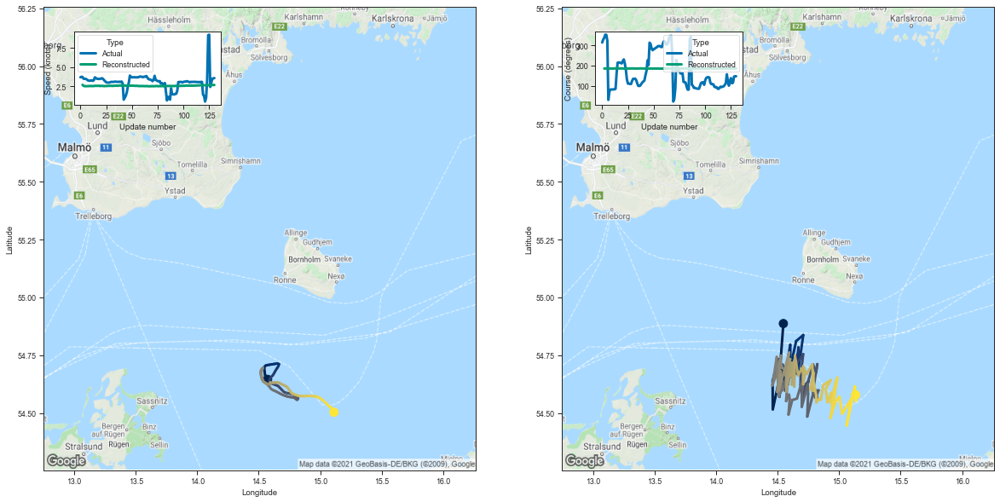

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.546768  54.886669  2.719726  185.091705         0.049134   
3    14.513175  54.645283  2.580788  184.981216         0.035292   
4    14.460787  54.515606  2.550682  184.529465         0.033360   
5    14.459462  54.637772  2.534959  184.923431         0.033029   
6    14.504412  54.732784  2.543160  185.267273         0.033325   
..         ...        ...       ...         ...              ...   
126  15.099684  54.561745  2.695487  185.350525         0.033342   
127  15.061531  54.445869  2.679502  184.965347         0.033197   
128  15.128107  54.615307  2.694467  185.607178         0.032689   
129  15.136230  54.551003  2.697260  185.443100         0.032952   
130  15.133649  54.578342  2.694299  185.504059         0.033118   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.128676     3.285526     99.207191                 1   
3          0.072171     3.164404     99.247757 

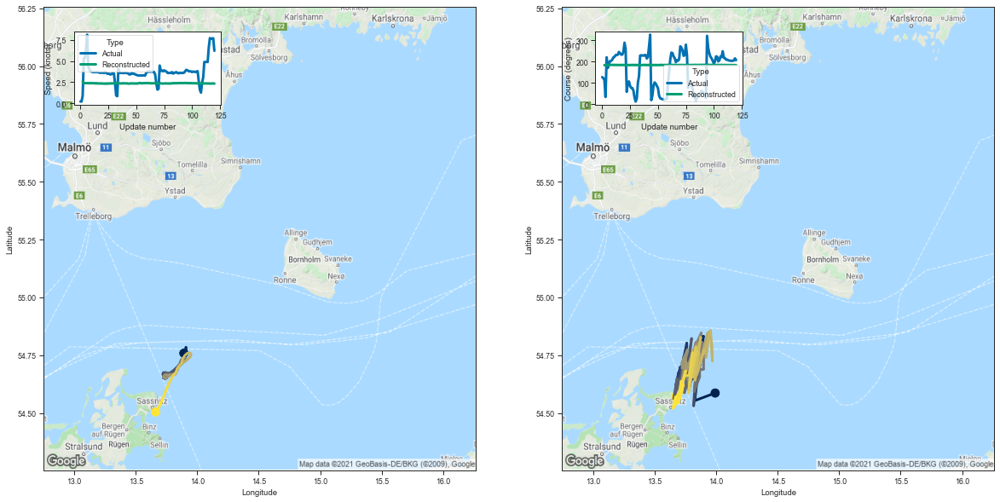

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.992266  54.586246  2.577149  183.716736         0.048130   
3    13.827011  54.553394  2.401493  183.744751         0.035890   
4    13.860234  54.715378  2.385769  184.369843         0.033893   
5    13.860607  54.696762  2.383424  184.356827         0.033484   
6    13.850265  54.744411  2.388673  184.458084         0.033489   
..         ...        ...       ...         ...              ...   
116  13.691811  54.544056  2.331105  183.772644         0.033091   
117  13.732733  54.622261  2.346437  183.979324         0.033445   
118  13.710130  54.566338  2.348369  183.814651         0.033571   
119  13.649301  54.519913  2.342761  183.610184         0.034229   
120  13.670197  54.570488  2.338130  183.767990         0.034010   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.111289     3.323683     98.506325                 1   
3          0.066372     3.257753     98.626884 

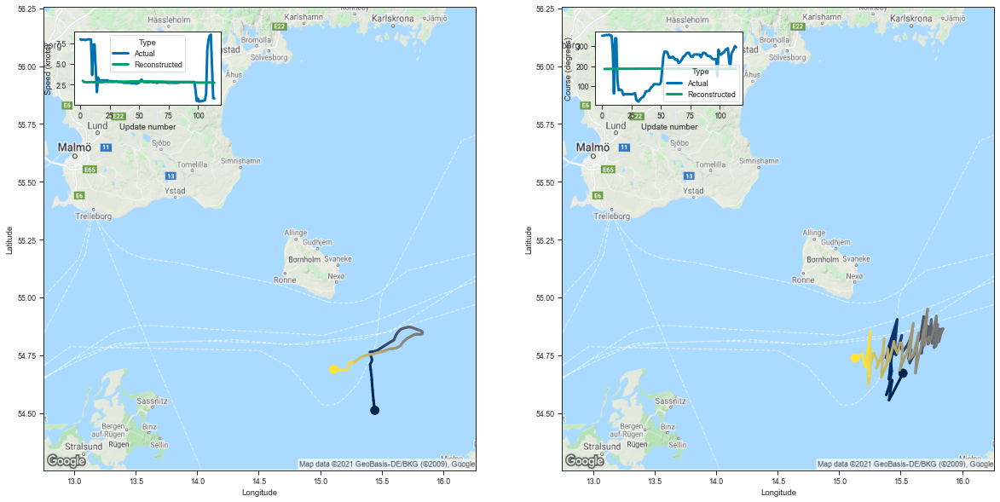

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.519102  54.671741  2.950469  185.573242         0.047604   
3    15.436910  54.586624  2.808723  185.764893         0.035698   
4    15.405104  54.555244  2.784661  185.699402         0.034016   
5    15.431708  54.641891  2.778836  186.000397         0.033112   
6    15.383245  54.577774  2.766883  185.800140         0.032714   
..         ...        ...       ...         ...              ...   
110  15.255867  54.854256  2.750697  186.544983         0.033039   
111  15.215929  54.697842  2.735982  185.951233         0.033305   
112  15.186245  54.754021  2.720409  186.097580         0.033240   
113  15.121393  54.731594  2.692468  185.893967         0.032652   
114  15.129231  54.737324  2.701613  185.973724         0.033183   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140022     3.134828     99.428963                 1   
3          0.082882     3.046960     99.620934 

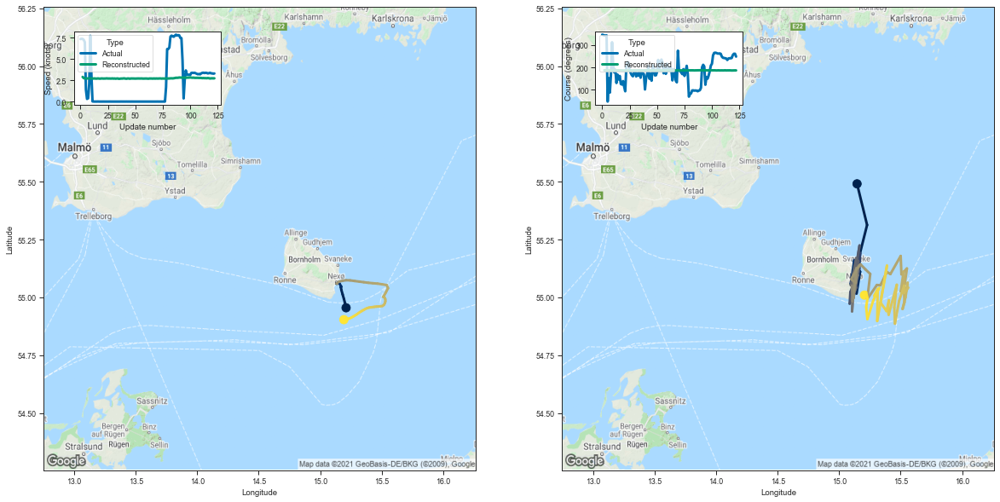

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.145700  55.490974  2.891207  187.463821         0.050127   
3    15.227359  55.313011  2.755740  187.711365         0.035047   
4    15.156232  55.162556  2.705119  187.218552         0.032924   
5    15.144339  55.132668  2.703029  187.237259         0.032314   
6    15.141210  55.016739  2.711410  186.806717         0.032961   
..         ...        ...       ...         ...              ...   
118  15.229715  54.905769  2.704159  186.535980         0.032516   
119  15.220060  54.958622  2.721950  186.653564         0.032947   
120  15.230895  54.996017  2.728154  186.824295         0.032796   
121  15.219418  55.021294  2.719728  186.985947         0.032493   
122  15.205750  55.009735  2.725897  186.955414         0.032487   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.153070     3.273823    100.424278                 1   
3          0.080347     3.147275    100.669495 

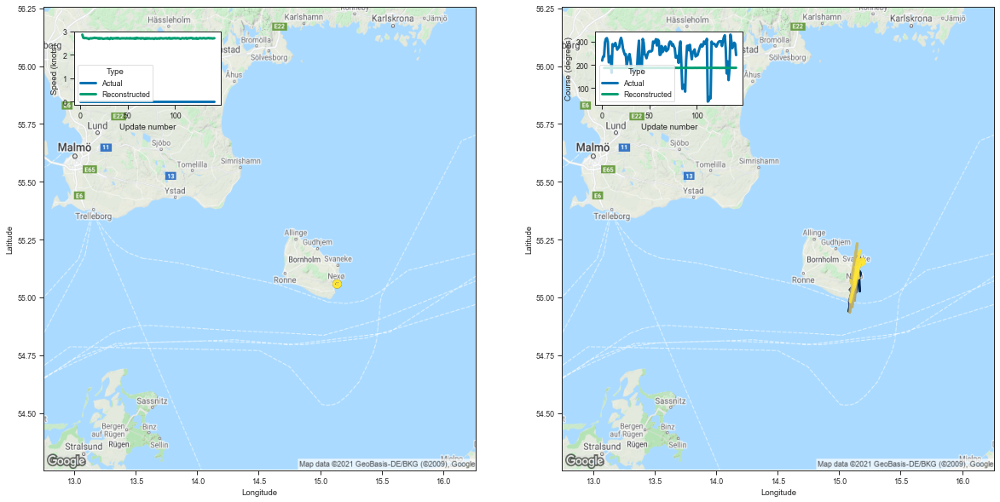

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.147160  55.102303  2.858048  186.448898         0.047495   
3    15.167646  55.026852  2.724593  186.826508         0.035199   
4    15.159639  55.118809  2.709360  187.146240         0.033137   
5    15.132875  55.037735  2.713380  186.894592         0.032750   
6    15.133173  55.059914  2.713857  186.975006         0.033179   
..         ...        ...       ...         ...              ...   
138  15.168586  55.202679  2.704468  187.419144         0.032248   
139  15.127929  55.054226  2.703425  186.910416         0.032627   
140  15.144207  55.134769  2.693410  187.164688         0.032680   
141  15.125227  55.074184  2.698983  187.032074         0.032598   
142  15.179825  55.153736  2.705652  187.242615         0.032812   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.130228     3.227412     99.923218                 1   
3          0.076706     3.130457    100.205704 

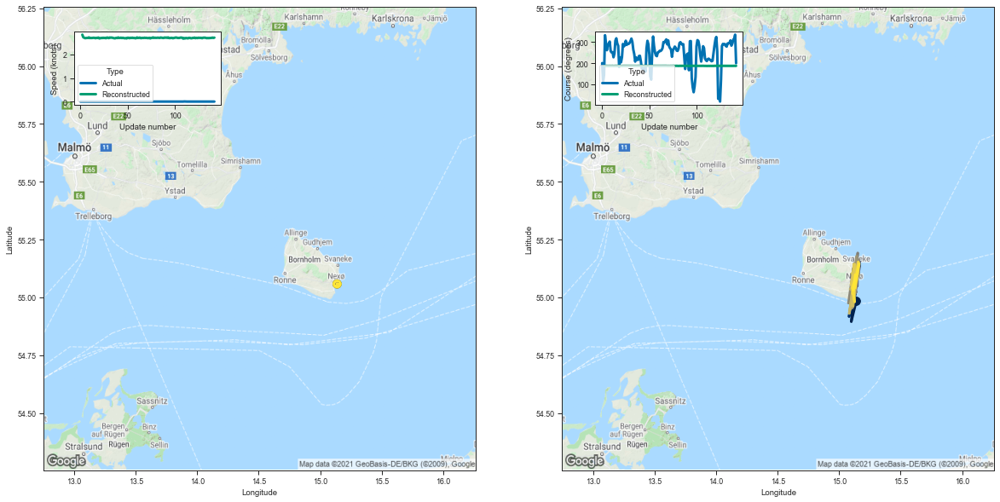

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139548  54.983036  2.840297  186.176483         0.046024   
3    15.099056  54.895477  2.727828  186.437286         0.034548   
4    15.125275  55.051483  2.707441  186.927628         0.032822   
5    15.137853  55.123409  2.690179  187.161987         0.032173   
6    15.103133  54.953133  2.696697  186.537109         0.032826   
..         ...        ...       ...         ...              ...   
138  15.139352  55.092331  2.700324  187.049347         0.032738   
139  15.129859  55.041729  2.702375  186.932541         0.032607   
140  15.162272  55.145729  2.713866  187.265823         0.032678   
141  15.115105  55.030052  2.701331  186.843506         0.032667   
142  15.131300  55.098484  2.712951  187.042511         0.032956   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.125408     3.196634     99.774010                 1   
3          0.076892     3.093199     99.997490 

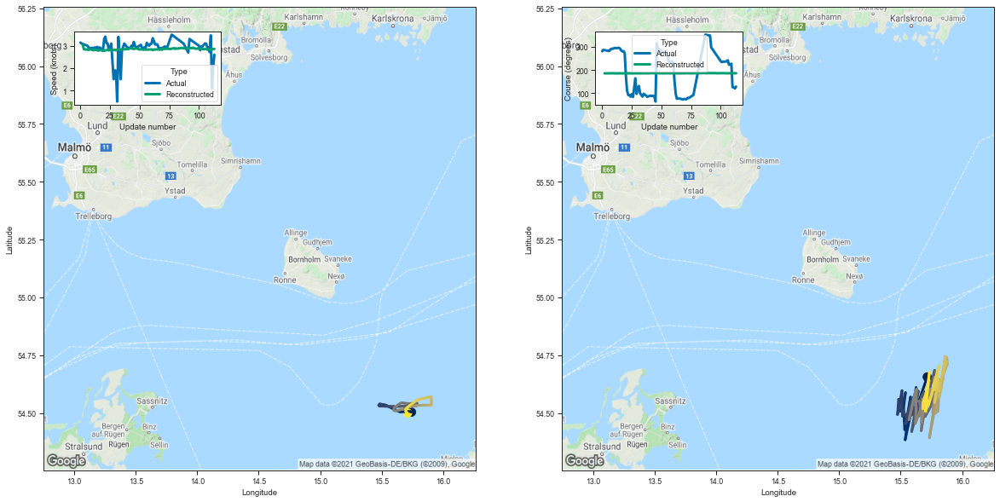

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.716206  54.655815  3.026643  185.621796         0.049474   
3    15.629918  54.522327  2.843552  185.798309         0.034902   
4    15.635148  54.488827  2.835653  185.747925         0.033617   
5    15.638992  54.524845  2.832814  185.889465         0.033527   
6    15.633267  54.511108  2.837696  185.868042         0.033199   
..         ...        ...       ...         ...              ...   
109  15.680422  54.543179  2.831944  185.961914         0.033078   
110  15.712509  54.597542  2.842931  186.200104         0.032993   
111  15.734592  54.675831  2.868119  186.445511         0.033602   
112  15.701002  54.508221  2.844813  185.882172         0.033164   
113  15.727410  54.552208  2.859214  186.119110         0.033417   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.154543     3.111568     99.431206                 1   
3          0.082445     3.013517     99.634682 

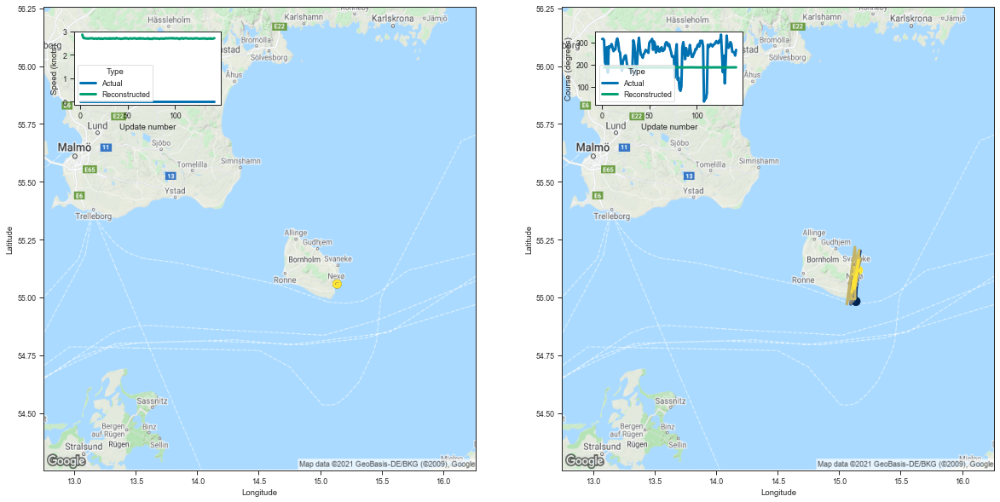

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.136920  54.982502  2.865540  186.121292         0.047637   
3    15.139803  55.103493  2.734646  187.012894         0.034872   
4    15.140336  55.063976  2.711950  186.992722         0.033003   
5    15.137411  55.061726  2.710482  186.976669         0.032637   
6    15.104784  54.990234  2.702039  186.726746         0.032439   
..         ...        ...       ...         ...              ...   
138  15.157124  55.160389  2.708499  187.325165         0.032235   
139  15.124668  55.039558  2.689319  186.881912         0.032780   
140  15.113953  55.052315  2.687784  186.881271         0.032560   
141  15.122911  55.077324  2.698781  186.968948         0.032561   
142  15.156987  55.117287  2.712735  187.193802         0.032543   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.133759     3.203579     99.734276                 1   
3          0.078672     3.128676    100.304573 

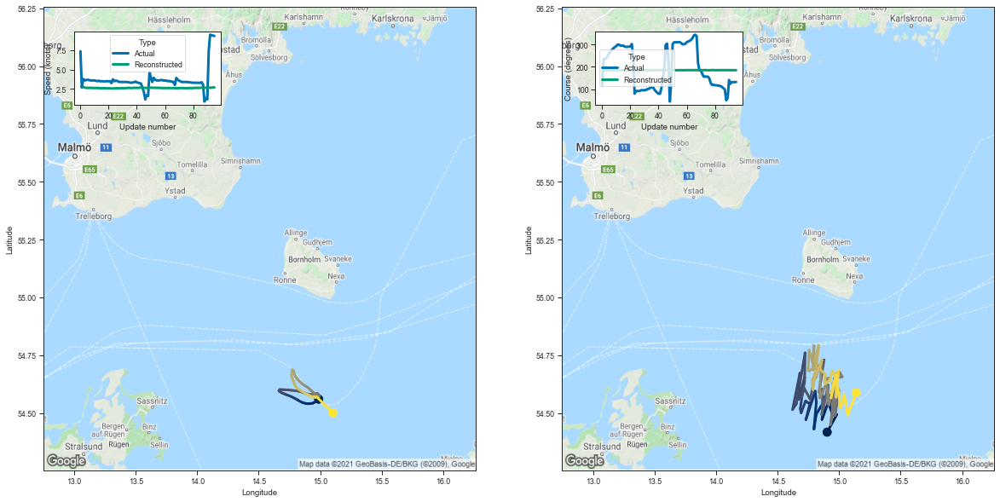

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.902583  54.417065  2.776726  184.230728         0.046408   
3   14.981071  54.493076  2.675923  185.040939         0.034600   
4   14.946594  54.490810  2.648536  184.970886         0.033269   
5   14.923656  54.528206  2.630159  185.123093         0.032749   
6   14.944523  54.594219  2.651383  185.332367         0.032733   
..        ...        ...       ...         ...              ...   
91  14.977033  54.665707  2.662217  185.565460         0.032961   
92  15.011272  54.520298  2.669105  185.178238         0.032925   
93  15.041442  54.580673  2.665365  185.359848         0.032756   
94  15.069611  54.490738  2.699578  185.164642         0.033500   
95  15.138659  54.587997  2.692937  185.484650         0.032743   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.117545     3.173923     98.763786                 1   
3         0.073272     3.083283     99.270836                

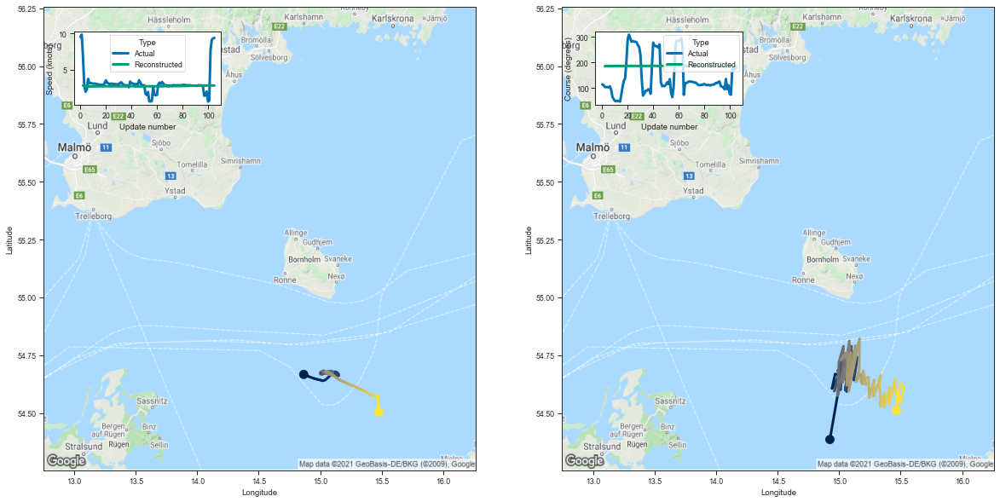

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.924861  54.385124  2.794872  184.057465         0.048153   
3    15.003122  54.624176  2.693451  185.437546         0.034599   
4    14.994752  54.667458  2.664073  185.611710         0.033012   
5    14.967004  54.667538  2.666285  185.602997         0.033475   
6    14.942202  54.606277  2.640347  185.345795         0.032652   
..         ...        ...       ...         ...              ...   
101  15.526441  54.612282  2.791142  185.957504         0.033057   
102  15.496483  54.541428  2.789244  185.749878         0.033096   
103  15.479684  54.590275  2.791231  185.915115         0.033228   
104  15.463302  54.504459  2.791713  185.563324         0.033380   
105  15.466692  54.511024  2.791043  185.686371         0.033441   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.127405     3.184810     98.650452                 1   
3          0.075257     3.097531     99.475822 

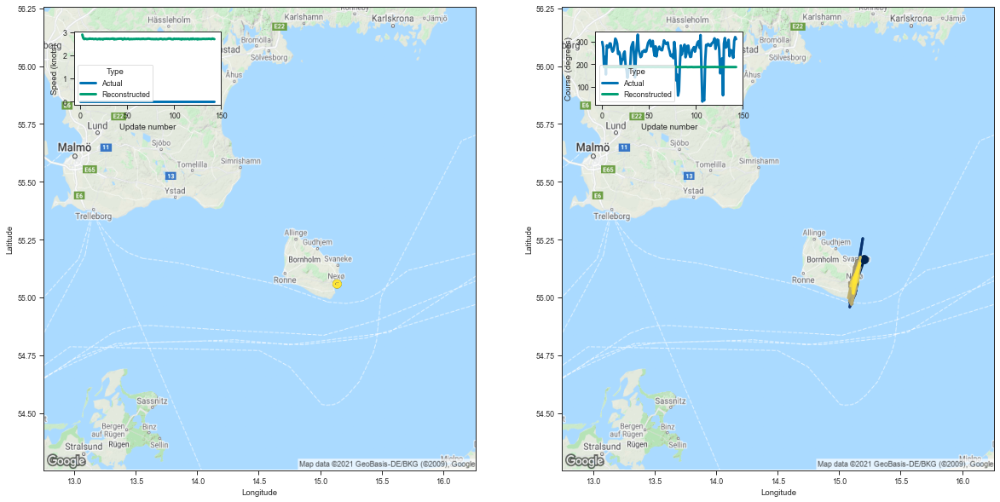

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.204690  55.163136  2.886791  186.623627         0.048454   
3    15.158883  55.094601  2.739488  187.054916         0.034665   
4    15.135426  55.024700  2.691119  186.833481         0.032378   
5    15.148659  55.132313  2.714606  187.210297         0.033019   
6    15.141756  55.084129  2.704451  187.042725         0.032693   
..         ...        ...       ...         ...              ...   
139  15.169690  55.149082  2.698686  187.249466         0.032220   
140  15.113857  55.017628  2.694253  186.785858         0.032569   
141  15.119981  55.081680  2.716819  187.066635         0.032808   
142  15.150149  55.115833  2.702434  187.134201         0.032468   
143  15.128206  55.062813  2.692047  186.918427         0.032553   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.137513     3.230408     99.991539                 1   
3          0.077828     3.121192    100.328697 

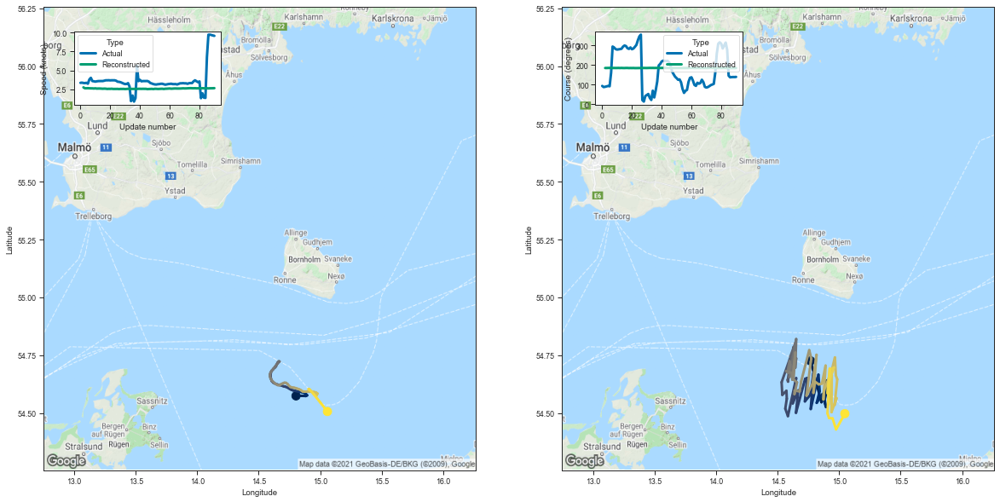

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.768044  54.725365  2.765776  185.073074         0.047134   
3   14.856155  54.546482  2.651052  185.054550         0.034558   
4   14.898639  54.639374  2.650938  185.389526         0.033256   
5   14.917763  54.632133  2.663151  185.413651         0.033728   
6   14.881896  54.557571  2.648642  185.178528         0.032962   
..        ...        ...       ...         ...              ...   
86  14.905479  54.498394  2.633727  185.008255         0.032660   
87  14.918221  54.477871  2.646681  184.952026         0.032970   
88  14.946808  54.476665  2.649486  185.008484         0.032822   
89  14.975142  54.428833  2.653726  184.848862         0.033000   
90  15.046351  54.497105  2.667302  185.174133         0.032628   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.120868     3.220133     99.195518                 1   
3         0.072597     3.105544     99.282837                

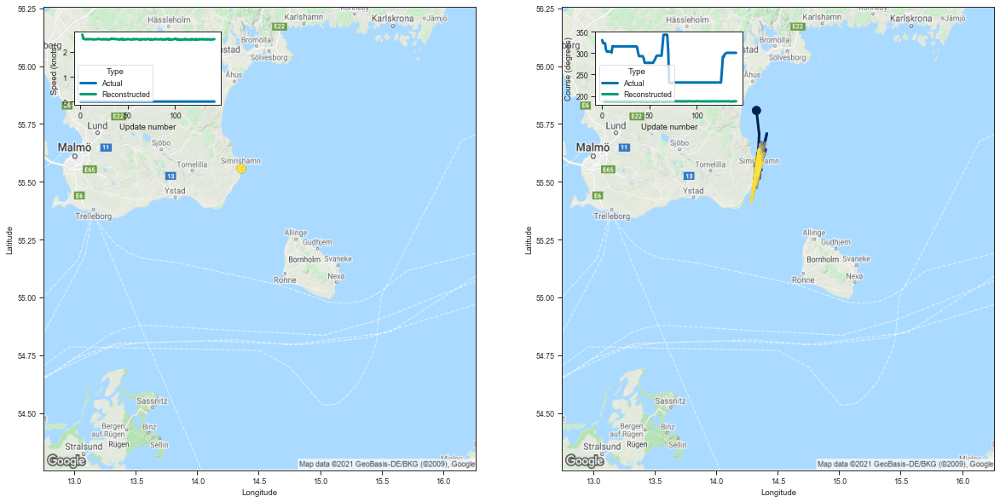

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.327854  55.808140  2.697866  187.616684         0.049808   
3    14.350348  55.704697  2.538239  187.869492         0.035627   
4    14.332914  55.529846  2.523100  187.454300         0.033400   
5    14.342503  55.543606  2.507845  187.502777         0.033050   
6    14.346826  55.631023  2.516187  187.808029         0.032876   
..         ...        ...       ...         ...              ...   
138  14.302261  55.481449  2.501571  187.243896         0.032973   
139  14.347818  55.640156  2.499830  187.771851         0.032677   
140  14.337871  55.526756  2.510139  187.468079         0.032861   
141  14.358412  55.587181  2.505793  187.620667         0.033146   
142  14.343735  55.595238  2.517484  187.703751         0.032873   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.133520     3.407759    100.542000                 1   
3          0.073097     3.309563    100.789085 

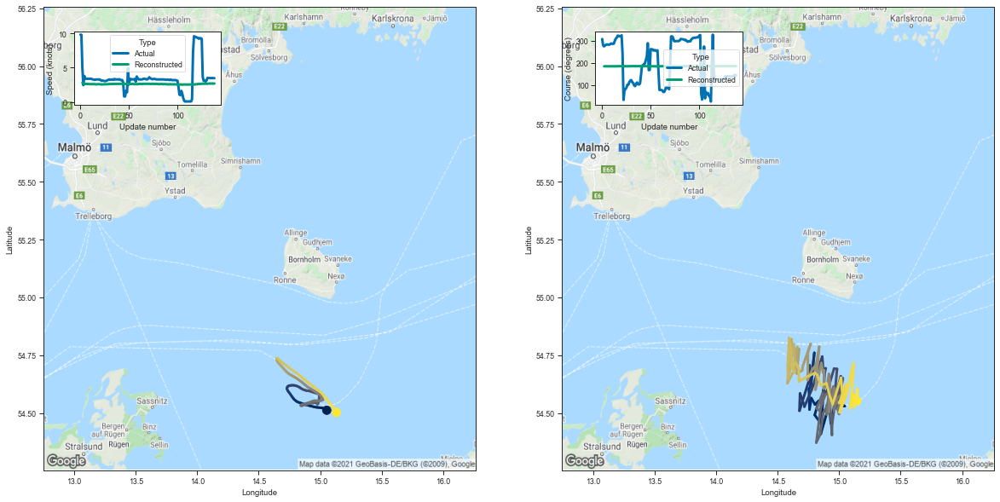

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.956416  54.561592  2.813601  184.709564         0.048222   
3    15.045615  54.529346  2.692877  185.151886         0.034939   
4    14.965756  54.543201  2.659111  185.189407         0.033060   
5    14.932268  54.454788  2.644963  184.833252         0.033321   
6    14.920476  54.535923  2.646450  185.153992         0.032919   
..         ...        ...       ...         ...              ...   
134  15.089729  54.519062  2.695770  185.326859         0.032764   
135  15.117285  54.579830  2.700269  185.454468         0.033140   
136  15.122252  54.526150  2.705291  185.400757         0.032877   
137  15.149183  54.604176  2.690693  185.561386         0.032528   
138  15.144348  54.552330  2.710560  185.412155         0.033534   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.128224     3.196736     98.997299                 1   
3          0.074864     3.091095     99.330826 

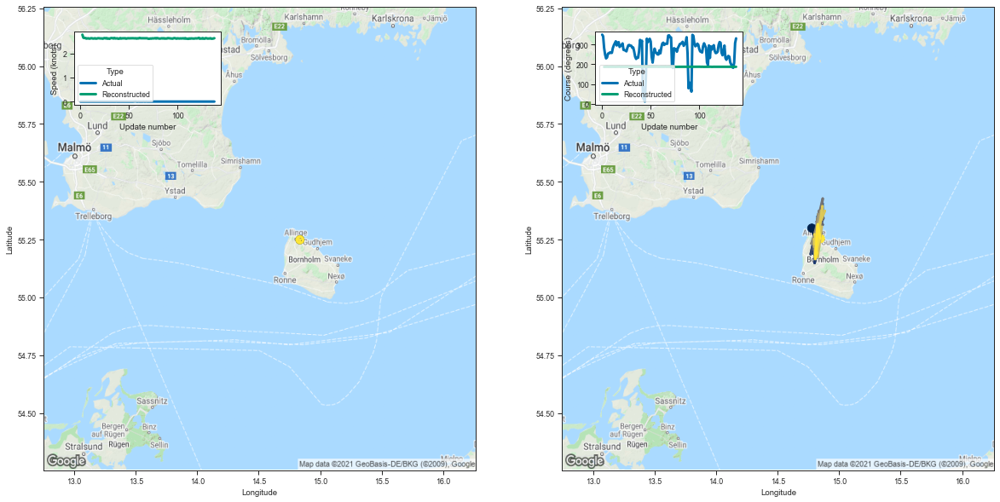

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.778192  55.299137  2.781009  186.691925         0.047566   
3    14.822541  55.216282  2.653434  186.937408         0.035287   
4    14.864434  55.407066  2.639650  187.635773         0.033028   
5    14.866095  55.342236  2.645032  187.470428         0.032858   
6    14.820086  55.239262  2.616524  187.040955         0.032978   
..         ...        ...       ...         ...              ...   
134  14.808765  55.184307  2.632187  186.976669         0.032835   
135  14.820298  55.194149  2.611550  186.967361         0.032510   
136  14.806541  55.166336  2.612725  186.898193         0.032573   
137  14.826753  55.315681  2.620373  187.463104         0.031996   
138  14.847075  55.254238  2.633255  187.201141         0.032438   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.129514     3.280207    100.050034                 1   
3          0.075902     3.189981    100.272697 

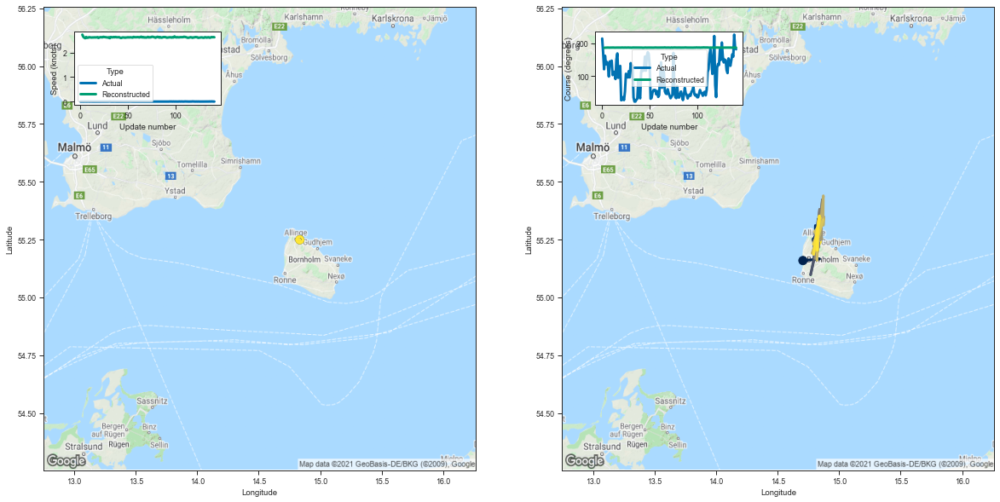

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.705891  55.159111  2.736403  186.227585         0.046803   
3    14.839977  55.165821  2.648410  186.893326         0.034302   
4    14.808091  55.172398  2.613384  186.888214         0.032671   
5    14.788855  55.251728  2.589406  187.109116         0.032076   
6    14.836486  55.287788  2.639163  187.342728         0.033105   
..         ...        ...       ...         ...              ...   
137  14.800666  55.219593  2.616349  187.051300         0.032756   
138  14.839450  55.352413  2.638188  187.587280         0.032323   
139  14.819337  55.255566  2.629277  187.163437         0.032664   
140  14.822011  55.204937  2.635689  187.062286         0.033102   
141  14.820055  55.240383  2.628670  187.107025         0.032859   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.119121     3.281289     99.826721                 1   
3          0.071741     3.176103    100.264313 

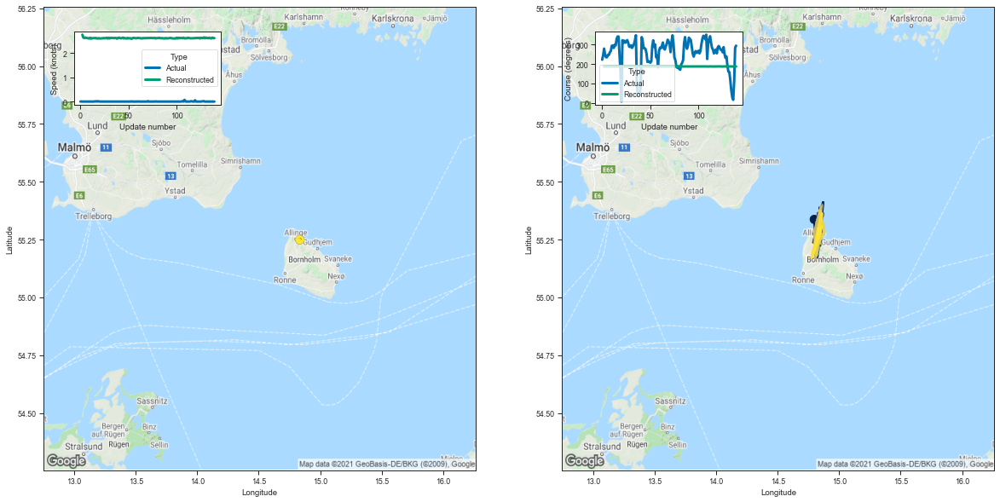

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.797924  55.337097  2.769346  186.705994         0.048085   
3    14.822750  55.175716  2.647821  186.852020         0.034775   
4    14.841872  55.289520  2.629664  187.307816         0.032601   
5    14.818112  55.197086  2.649051  187.038437         0.033198   
6    14.844098  55.388447  2.635979  187.565781         0.032521   
..         ...        ...       ...         ...              ...   
135  14.775317  55.171299  2.616457  186.901123         0.032637   
136  14.795198  55.193775  2.614068  186.941208         0.032852   
137  14.857780  55.306255  2.645835  187.338577         0.033544   
138  14.830283  55.255474  2.621248  187.138184         0.032527   
139  14.831112  55.299423  2.625116  187.306091         0.032702   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126995     3.305099    100.069267                 1   
3          0.073284     3.184443    100.238007 

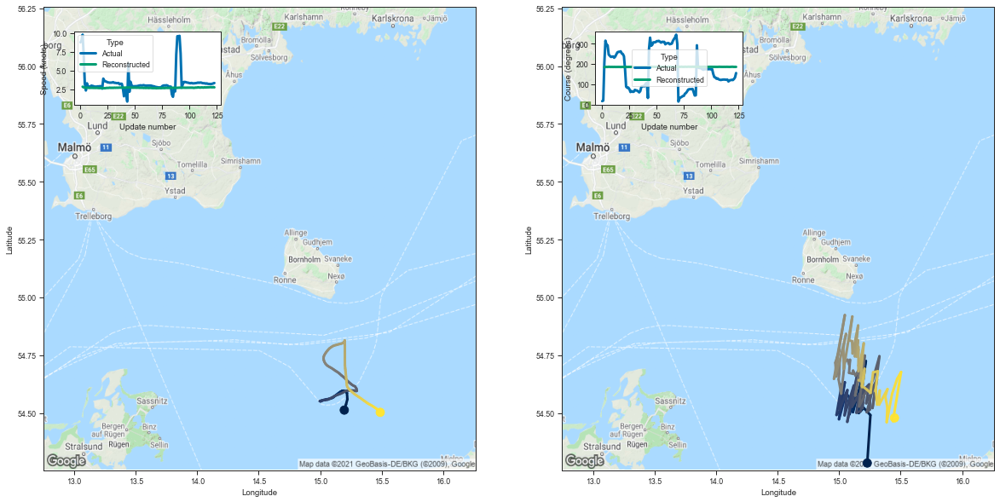

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.228690  54.283516  2.851105  184.139435         0.046161   
3    15.254369  54.490776  2.760748  185.275208         0.035262   
4    15.200021  54.521851  2.726361  185.393784         0.033471   
5    15.159388  54.499596  2.696632  185.284988         0.032821   
6    15.217486  54.724514  2.733944  186.034958         0.033323   
..         ...        ...       ...         ...              ...   
119  15.471579  54.647346  2.784442  186.083633         0.033085   
120  15.503735  54.677322  2.791581  186.160904         0.032973   
121  15.437304  54.464561  2.768646  185.463226         0.032514   
122  15.465025  54.482018  2.801188  185.643356         0.033336   
123  15.450397  54.478683  2.763691  185.523529         0.032977   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.121163     3.135163     98.699493                 1   
3          0.079483     3.056293     99.371338 

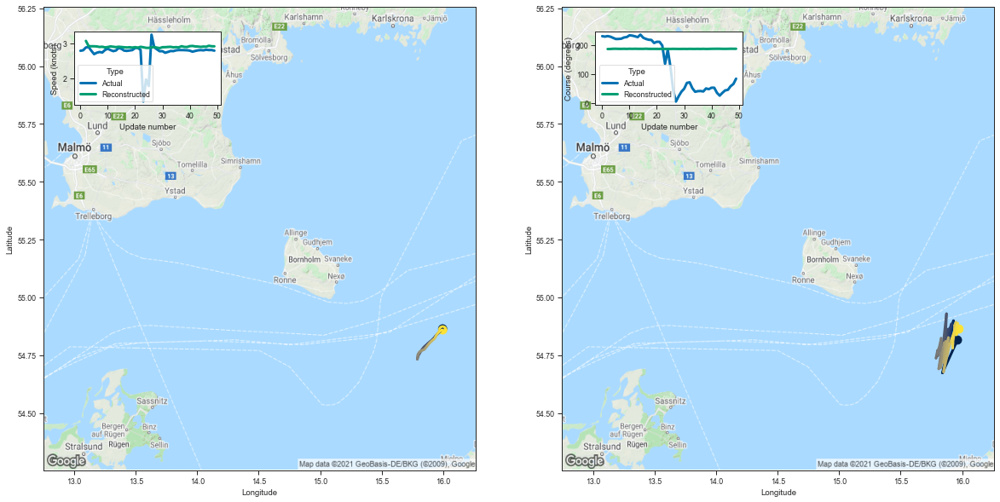

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.961889  54.815468  3.066372  186.411423         0.048549   
3   15.840092  54.673214  2.917403  186.517548         0.035041   
4   15.929592  54.899101  2.913352  187.264374         0.033814   
5   15.927905  54.894382  2.913473  187.344360         0.033087   
6   15.892665  54.791374  2.908142  186.965622         0.033655   
7   15.873228  54.767429  2.893698  186.902496         0.033045   
8   15.901052  54.850365  2.899641  187.187561         0.033071   
9   15.874553  54.773788  2.881271  186.852570         0.032877   
10  15.913583  54.885445  2.891651  187.299942         0.032906   
11  15.869704  54.817585  2.909141  187.000168         0.033805   
12  15.888342  54.862671  2.899207  187.296768         0.033036   
13  15.865204  54.822334  2.889190  187.048416         0.033044   
14  15.859949  54.811043  2.900027  187.009720         0.033395   
15  15.863423  54.812157  2.892408  186.989120         0.03337

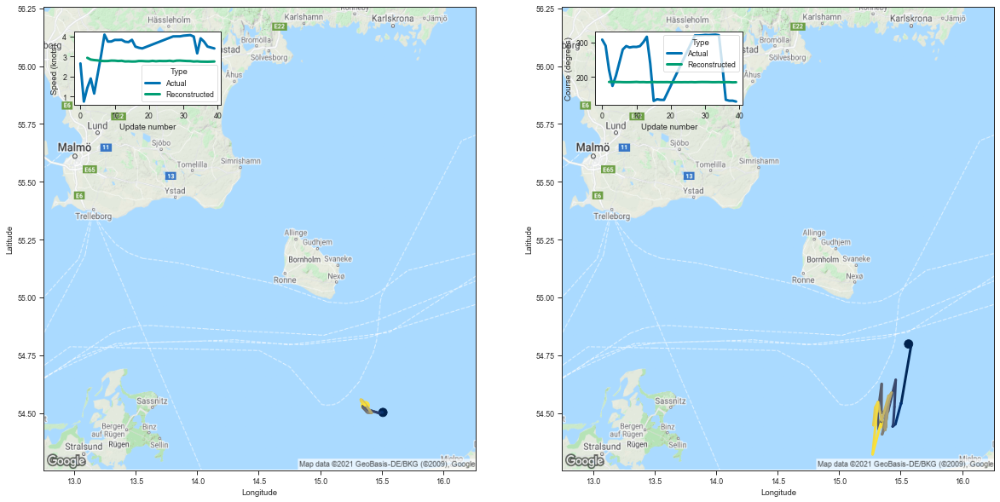

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.564857  54.798214  2.931047  186.114502         0.045641   
3   15.583931  54.788071  2.845108  186.573990         0.035244   
4   15.504316  54.540485  2.819318  185.866013         0.033807   
5   15.503498  54.542316  2.804336  185.828812         0.033326   
6   15.458103  54.451832  2.778089  185.510208         0.032934   
7   15.434921  54.441471  2.770821  185.395050         0.032873   
8   15.439827  54.449329  2.773824  185.460190         0.032925   
9   15.449590  54.526424  2.793413  185.715057         0.033066   
10  15.460325  54.643230  2.789903  186.109772         0.032908   
11  15.397979  54.506550  2.773499  185.501556         0.033481   
12  15.392810  54.539452  2.783722  185.700455         0.033092   
13  15.321875  54.430210  2.751483  185.253143         0.033286   
14  15.313097  54.492863  2.756648  185.508240         0.033136   
15  15.345887  54.625683  2.746691  185.874786         0.03258

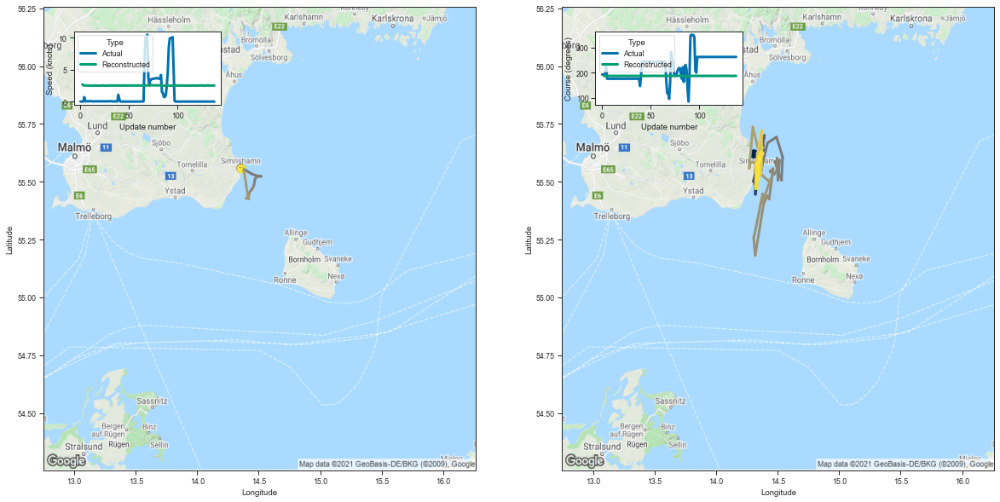

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.307507  55.619892  2.686023  186.979233         0.049941   
3    14.355528  55.602489  2.542809  187.607132         0.035279   
4    14.365337  55.555767  2.527737  187.550293         0.033402   
5    14.339452  55.551933  2.507914  187.451141         0.032962   
6    14.343373  55.549629  2.528899  187.532135         0.033367   
..         ...        ...       ...         ...              ...   
134  14.326589  55.503807  2.511861  187.382675         0.033103   
135  14.328222  55.579197  2.500194  187.544250         0.032842   
136  14.346972  55.509586  2.513853  187.374146         0.032897   
137  14.351131  55.608109  2.507422  187.713623         0.032724   
138  14.357586  55.590317  2.519161  187.661362         0.033073   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.132189     3.396517    100.208572                 1   
3          0.072363     3.290620    100.653847 

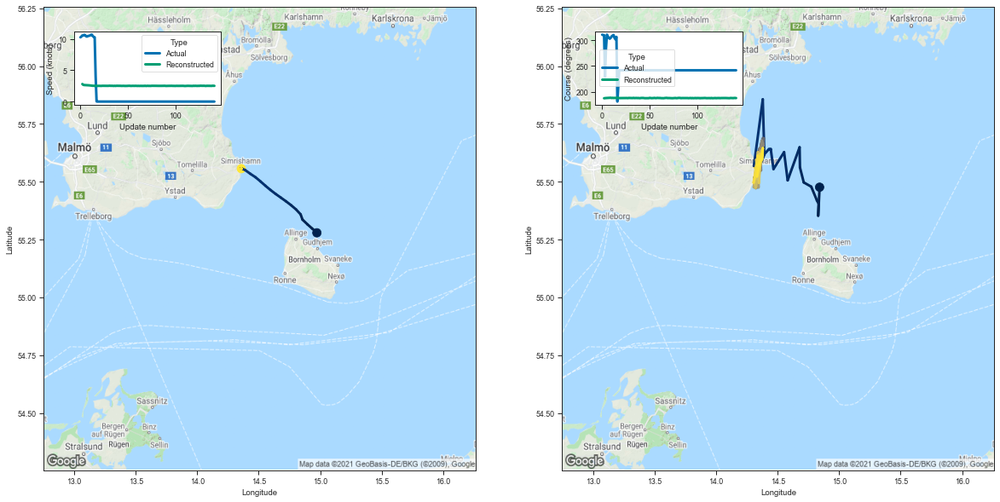

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.841367  55.476341  2.800640  187.215790         0.048575   
3    14.829899  55.353081  2.670921  187.456802         0.035213   
4    14.833995  55.404297  2.639200  187.634384         0.033066   
5    14.819497  55.419094  2.631098  187.738586         0.032628   
6    14.773436  55.478600  2.614453  187.799286         0.033327   
..         ...        ...       ...         ...              ...   
137  14.338573  55.561821  2.508238  187.596664         0.032858   
138  14.332282  55.522839  2.500968  187.453400         0.032542   
139  14.380091  55.645260  2.524822  187.818710         0.033330   
140  14.374790  55.598171  2.525460  187.749557         0.033095   
141  14.336542  55.569977  2.512006  187.589722         0.033171   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.135316     3.309902    100.327400                 1   
3          0.077347     3.186473    100.543968 

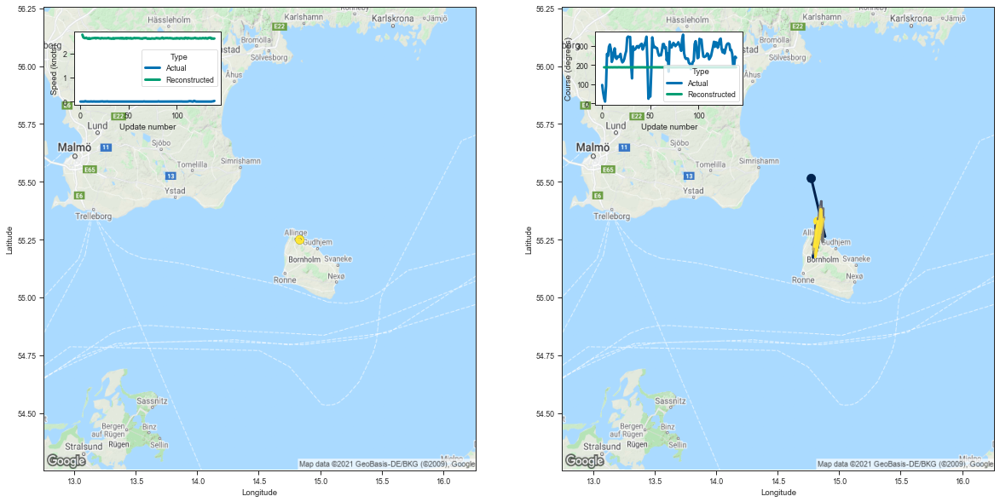

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.773566  55.514465  2.775772  187.288483         0.048250   
3    14.885653  55.263702  2.660866  187.118317         0.035439   
4    14.838157  55.279831  2.637864  187.213104         0.033553   
5    14.838615  55.330540  2.628176  187.438141         0.032555   
6    14.856353  55.294086  2.649946  187.387146         0.032889   
..         ...        ...       ...         ...              ...   
135  14.857193  55.333191  2.647708  187.491135         0.032653   
136  14.806553  55.174999  2.607421  186.934494         0.032281   
137  14.818496  55.227528  2.620716  187.047043         0.033031   
138  14.798963  55.219639  2.605566  187.074631         0.032401   
139  14.827394  55.329445  2.616348  187.424515         0.032468   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.130143     3.324973    100.374123                 1   
3          0.075521     3.201636    100.372665 

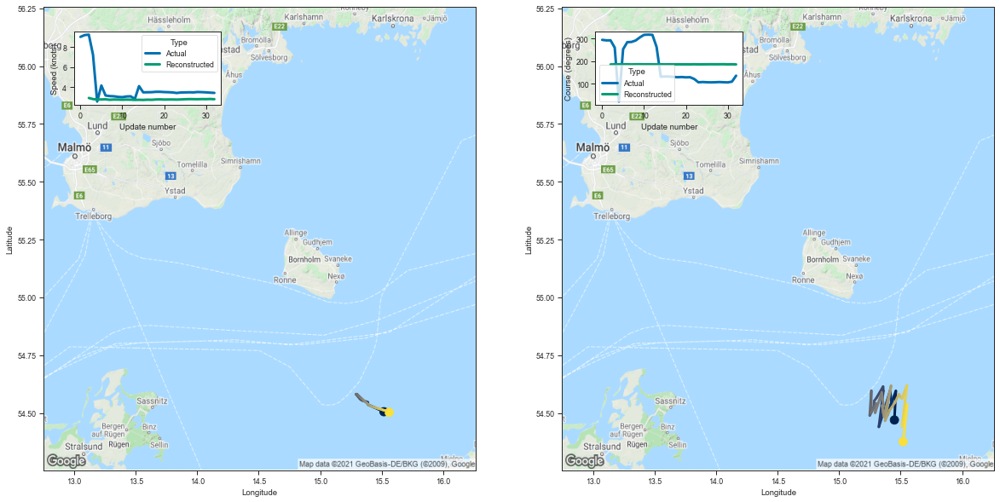

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.449389  54.469681  2.917829  184.951401         0.046905   
3   15.461227  54.595127  2.808177  185.755737         0.035297   
4   15.389954  54.489212  2.766241  185.457916         0.033372   
5   15.425919  54.546333  2.770515  185.693741         0.032981   
6   15.414222  54.595589  2.784670  185.898880         0.033163   
7   15.323016  54.439816  2.737203  185.259842         0.032830   
8   15.359768  54.595036  2.763815  185.782700         0.033239   
9   15.357265  54.613815  2.754805  185.875427         0.033035   
10  15.305371  54.566692  2.743592  185.656967         0.032826   
11  15.285459  54.552086  2.754160  185.666855         0.033031   
12  15.282206  54.526836  2.745989  185.488602         0.033146   
13  15.249114  54.489021  2.725908  185.323441         0.032686   
14  15.261813  54.596058  2.735703  185.689529         0.033128   
15  15.259203  54.500832  2.723506  185.366364         0.03277

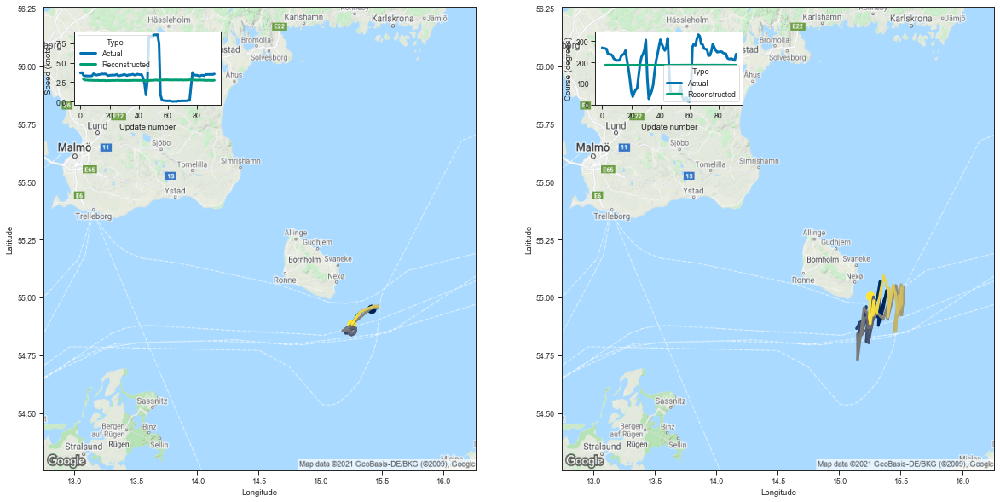

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.320727  54.928421  2.901044  186.124191         0.047869   
3   15.388357  55.021336  2.782662  187.013092         0.034973   
4   15.384429  55.029175  2.777434  187.140045         0.033313   
5   15.358842  54.951443  2.765491  186.946991         0.032607   
6   15.318688  54.878284  2.744246  186.608749         0.032645   
..        ...        ...       ...         ...              ...   
88  15.274987  54.923031  2.742864  186.683792         0.033183   
89  15.281594  54.985977  2.742498  186.915390         0.032804   
90  15.253060  54.885723  2.725958  186.550293         0.032776   
91  15.244970  54.912144  2.733847  186.575058         0.033283   
92  15.254515  55.004440  2.745641  186.948257         0.032539   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.135397     3.182900     99.727066                 1   
3         0.079512     3.103593    100.290230                

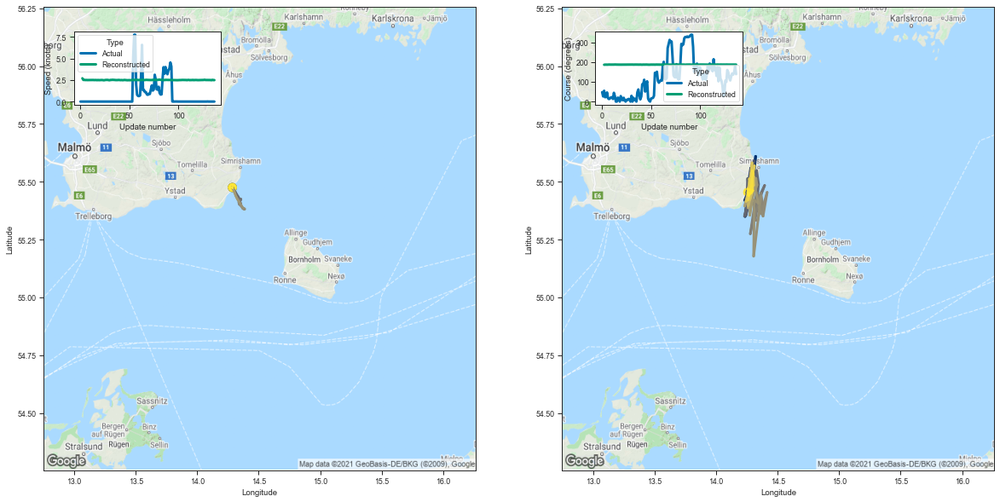

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.291461  55.486530  2.692961  186.566711         0.050632   
3    14.258174  55.428707  2.507698  186.932480         0.035161   
4    14.307616  55.475243  2.508356  187.232941         0.033762   
5    14.235723  55.349716  2.493010  186.848404         0.033185   
6    14.268981  55.511757  2.498609  187.344269         0.033298   
..         ...        ...       ...         ...              ...   
133  14.275826  55.450459  2.492108  187.084488         0.033215   
134  14.255764  55.468361  2.472038  187.154236         0.032743   
135  14.297228  55.461399  2.513444  187.222305         0.033392   
136  14.263859  55.440590  2.488285  187.104324         0.033122   
137  14.257076  55.454735  2.484805  187.154678         0.032745   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.138794     3.373124     99.982620                 1   
3          0.070123     3.290533    100.307762 

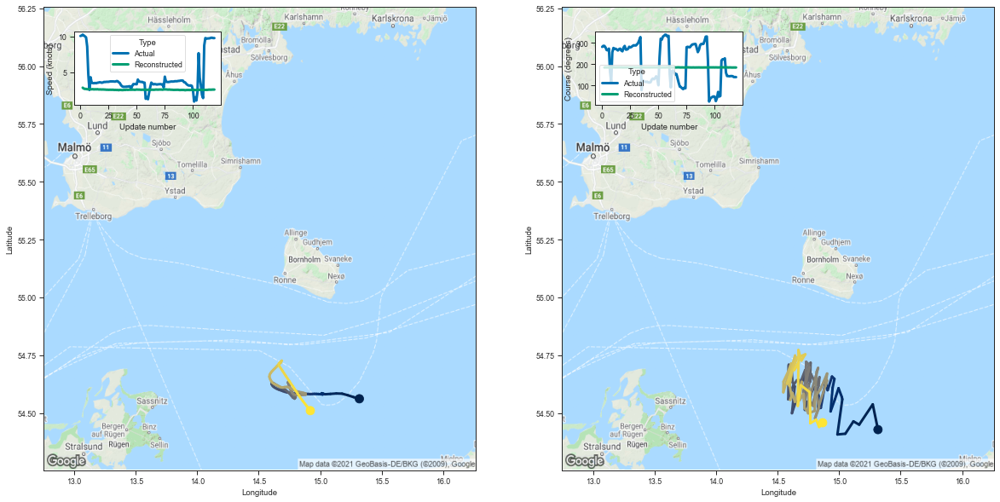

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.315778  54.428024  2.883765  184.703476         0.046886   
3    15.273411  54.537167  2.759649  185.428970         0.035243   
4    15.162992  54.449375  2.710804  185.156647         0.033269   
5    15.116480  54.463753  2.716766  185.149765         0.033657   
6    15.050633  54.410191  2.672626  184.888519         0.032951   
..         ...        ...       ...         ...              ...   
115  14.766234  54.482101  2.611429  184.690628         0.033060   
116  14.765693  54.455437  2.602156  184.677383         0.032822   
117  14.813703  54.471085  2.617702  184.808121         0.032773   
118  14.837633  54.439404  2.623078  184.734512         0.033327   
119  14.866061  54.457771  2.622472  184.740662         0.033395   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.128459     3.128251     98.983322                 1   
3          0.078632     3.063278     99.461258 

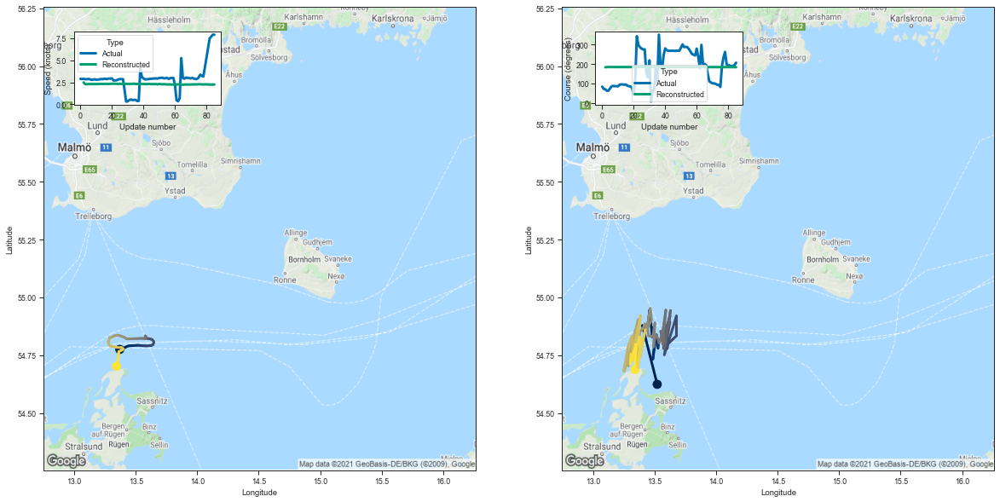

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.521258  54.623989  2.484048  183.126434         0.050686   
3   13.400541  54.878098  2.289161  184.280914         0.036202   
4   13.440429  54.859997  2.280515  184.344299         0.034083   
5   13.459768  54.944729  2.291845  184.698532         0.034072   
6   13.480695  54.828075  2.291490  184.279465         0.034317   
..        ...        ...       ...         ...              ...   
81  13.328154  54.728844  2.247988  183.922684         0.033495   
82  13.308061  54.754120  2.244892  183.939728         0.033764   
83  13.301568  54.712448  2.235604  183.874985         0.033359   
84  13.347239  54.796875  2.241619  184.151047         0.033258   
85  13.340137  54.688290  2.250524  183.734222         0.033906   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.118576     3.401640     98.205513                 1   
3         0.063202     3.356972     98.927368                

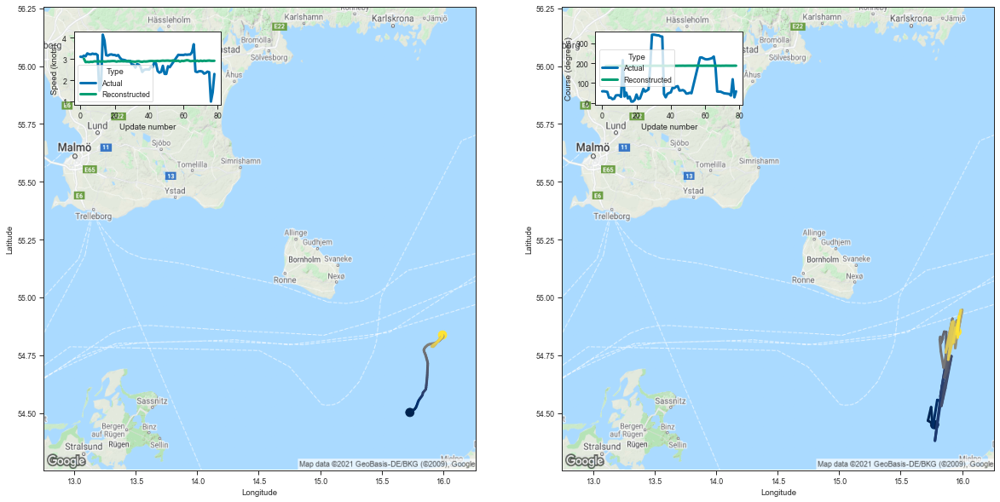

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.776301  54.449524  3.019488  185.242508         0.047694   
3   15.722233  54.466751  2.855899  185.726013         0.034891   
4   15.747886  54.524990  2.864715  186.058609         0.033502   
5   15.756084  54.469875  2.853885  185.848724         0.033184   
6   15.761413  54.436470  2.871483  185.810654         0.033090   
..        ...        ...       ...         ...              ...   
74  15.949555  54.841747  2.921098  187.253510         0.033185   
75  15.961983  54.855583  2.928961  187.266876         0.033330   
76  15.963826  54.826176  2.916611  187.200058         0.032794   
77  15.974690  54.917645  2.914220  187.460739         0.032995   
78  15.958605  54.851719  2.916952  187.261917         0.033070   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.145546     3.064374     99.234398                 1   
3         0.081371     3.008690     99.597740                

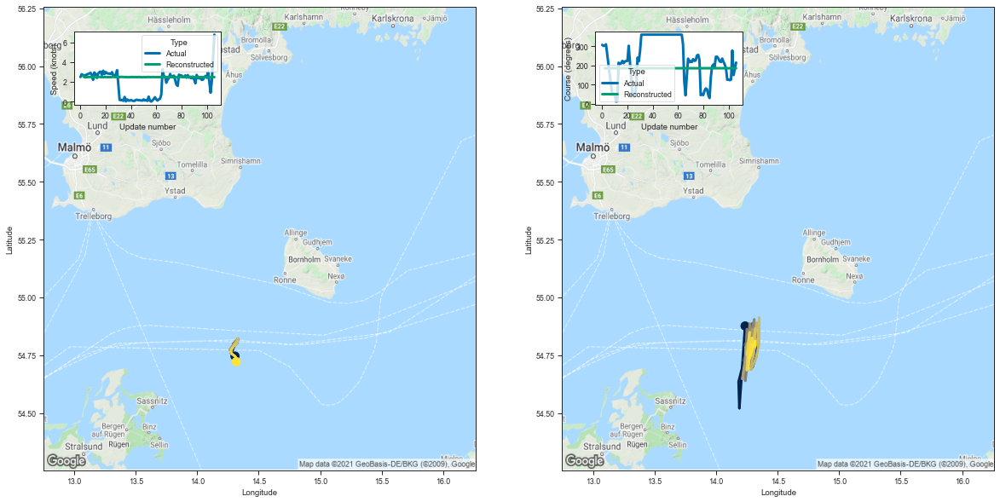

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.235578  54.876217  2.617000  184.747559         0.047678   
3    14.189022  54.520710  2.485584  184.189194         0.035109   
4    14.182632  54.635185  2.455443  184.544327         0.033372   
5    14.258423  54.789574  2.471764  185.163788         0.032810   
6    14.273005  54.784107  2.499288  185.159302         0.033472   
..         ...        ...       ...         ...              ...   
102  14.280245  54.796185  2.473115  185.181000         0.032720   
103  14.295922  54.787388  2.485841  185.093658         0.033382   
104  14.271961  54.739941  2.487322  185.016937         0.033124   
105  14.315631  54.810925  2.483765  185.236221         0.032873   
106  14.314396  54.787987  2.484877  185.185913         0.032636   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.113304     3.332143     99.059242                 1   
3          0.067457     3.191459     98.848473 

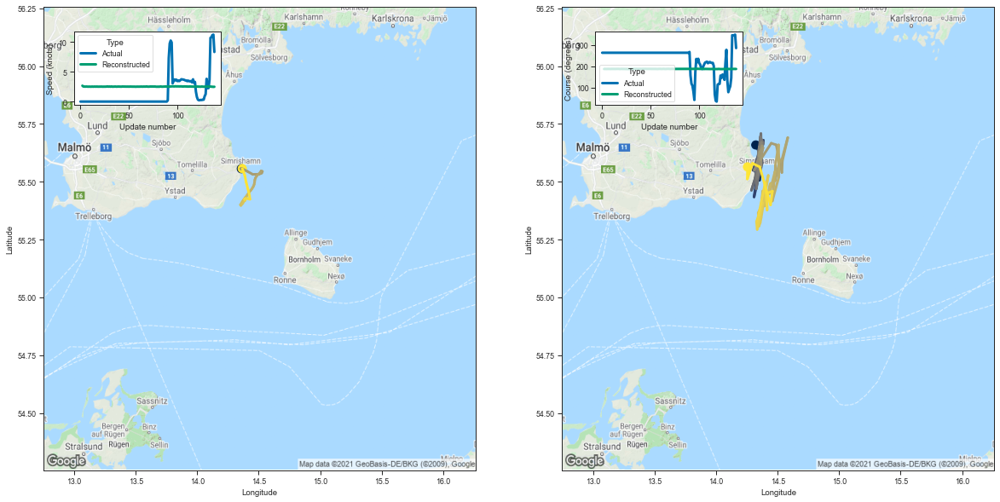

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.322762  55.659065  2.663282  187.242661         0.048298   
3    14.357770  55.617432  2.530270  187.703522         0.035316   
4    14.352707  55.506401  2.511695  187.339951         0.033365   
5    14.367871  55.597439  2.507528  187.656418         0.032866   
6    14.354092  55.560093  2.523083  187.623627         0.033227   
..         ...        ...       ...         ...              ...   
134  14.442392  55.399567  2.519993  187.235046         0.031956   
135  14.354877  55.564045  2.505463  187.544067         0.032946   
136  14.295700  55.579620  2.491762  187.581116         0.032881   
137  14.254045  55.511909  2.469858  187.268921         0.032702   
138  14.255205  55.564312  2.486047  187.385605         0.033498   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.121959     3.394419    100.362160                 1   
3          0.070638     3.300771    100.707512 

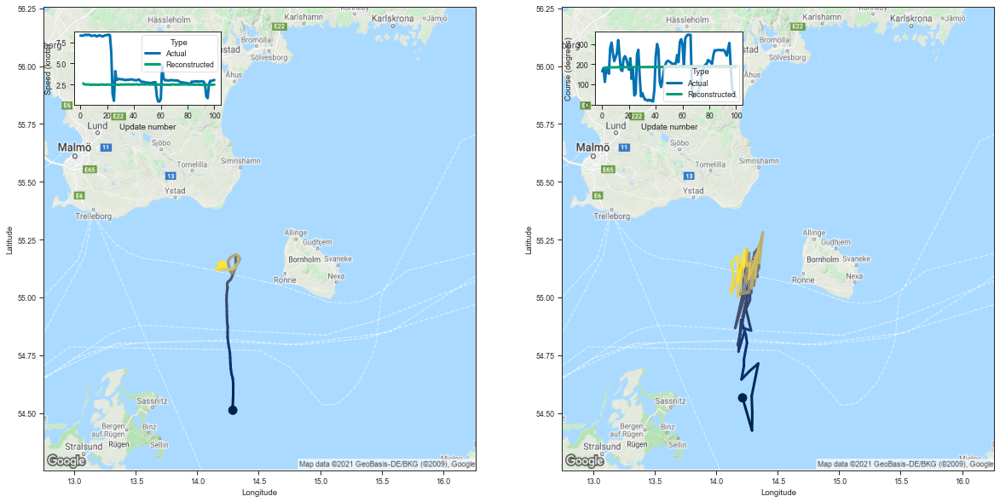

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.214941  54.565540  2.622260  183.763046         0.048705   
3    14.291979  54.424084  2.513368  183.986557         0.035223   
4    14.293990  54.502392  2.495723  184.300217         0.033752   
5    14.289129  54.573132  2.496167  184.577835         0.033157   
6    14.342634  54.713768  2.504481  185.018066         0.033362   
..         ...        ...       ...         ...              ...   
96   14.126193  55.153133  2.450189  186.137253         0.032912   
97   14.178698  55.179127  2.460030  186.176102         0.033210   
98   14.176199  55.063107  2.463008  185.815414         0.033097   
99   14.228941  55.203072  2.480708  186.326172         0.032993   
100  14.224295  55.130051  2.476138  186.125671         0.033087   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.115795     3.318381     98.534386                 1   
3          0.068352     3.177287     98.736870 

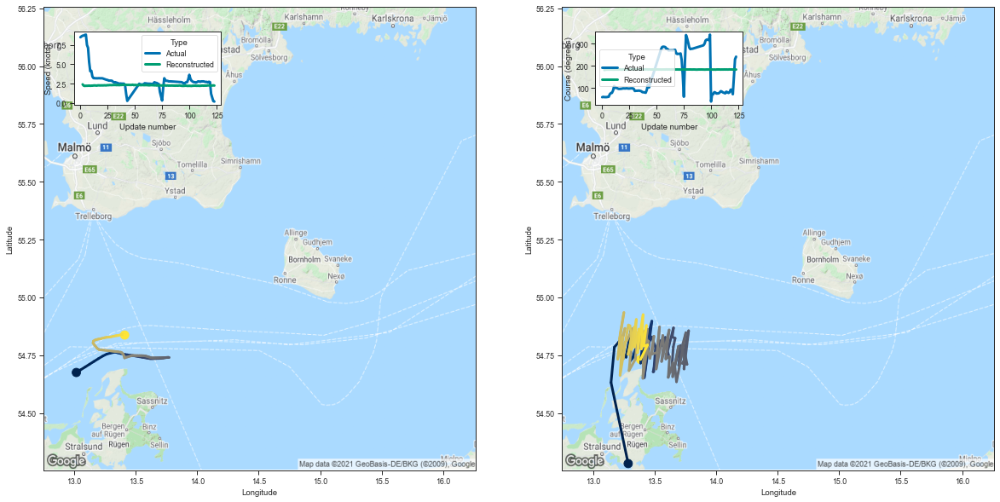

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.285298  54.281170  2.416491  181.786316         0.051498   
3    13.145878  54.631596  2.250402  183.228348         0.037065   
4    13.172932  54.784340  2.215125  183.789200         0.034357   
5    13.211251  54.808762  2.238861  183.961548         0.034242   
6    13.231020  54.770958  2.234754  183.857498         0.034001   
..         ...        ...       ...         ...              ...   
119  13.433515  54.878471  2.276846  184.406097         0.033865   
120  13.411401  54.791035  2.258330  184.072327         0.033611   
121  13.414165  54.789989  2.267683  184.164352         0.033687   
122  13.442281  54.793980  2.287860  184.209564         0.034187   
123  13.385957  54.731186  2.263757  183.888260         0.033921   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.113148     3.395091     97.495934                 1   
3          0.064941     3.364102     98.360512 

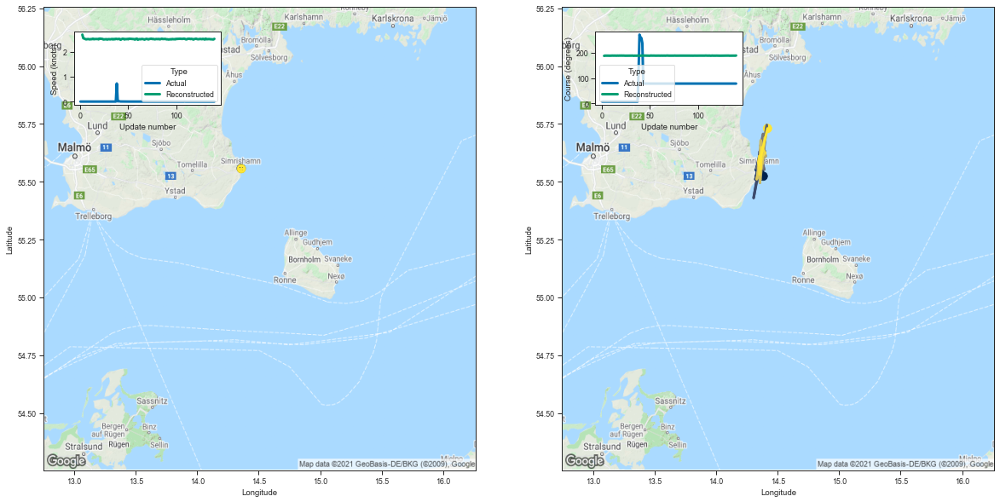

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.383073  55.523918  2.692917  186.774872         0.050105   
3    14.363230  55.613171  2.549027  187.596664         0.035834   
4    14.368057  55.581116  2.534930  187.672913         0.033461   
5    14.380087  55.651646  2.516501  187.843842         0.033261   
6    14.346754  55.569378  2.502888  187.596649         0.032408   
..         ...        ...       ...         ...              ...   
136  14.350358  55.575993  2.506911  187.601440         0.032759   
137  14.362092  55.555672  2.507010  187.537415         0.032759   
138  14.366536  55.600960  2.503094  187.659439         0.032939   
139  14.348577  55.573948  2.498124  187.543839         0.032976   
140  14.418120  55.730480  2.523793  188.116776         0.032633   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.132578     3.390367    100.091965                 1   
3          0.074395     3.293815    100.634720 

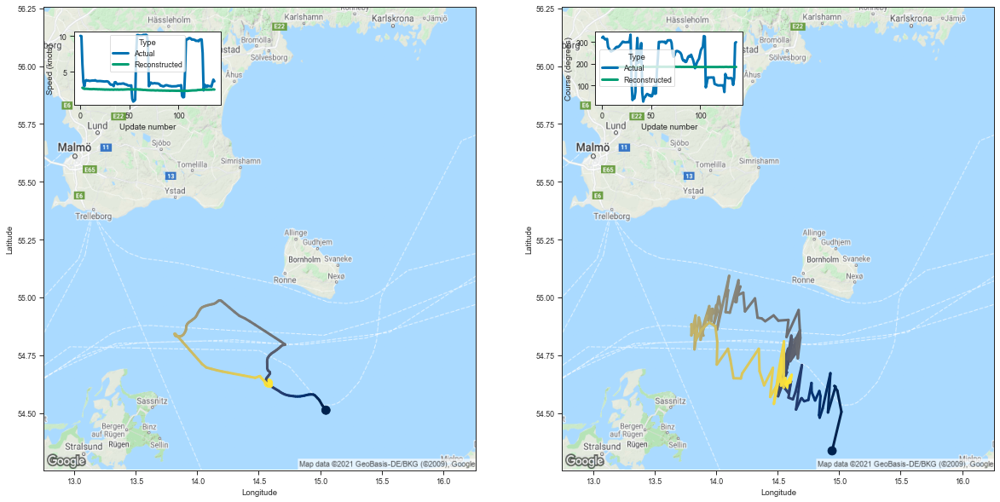

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.942925  54.336269  2.813694  184.009323         0.047582   
3    15.018843  54.504776  2.714363  185.085144         0.035620   
4    14.985689  54.595879  2.655855  185.395828         0.032853   
5    14.961817  54.616779  2.660046  185.386398         0.032915   
6    14.970683  54.613804  2.665692  185.357010         0.033476   
..         ...        ...       ...         ...              ...   
133  14.563331  54.650925  2.561470  185.083344         0.032997   
134  14.562192  54.624180  2.538937  184.898743         0.033087   
135  14.603307  54.632381  2.573499  185.073761         0.033182   
136  14.614710  54.664879  2.580416  185.179855         0.033134   
137  14.566529  54.622055  2.559222  184.938492         0.033033   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.128199     3.156261     98.621880                 1   
3          0.078529     3.086398     99.283546 

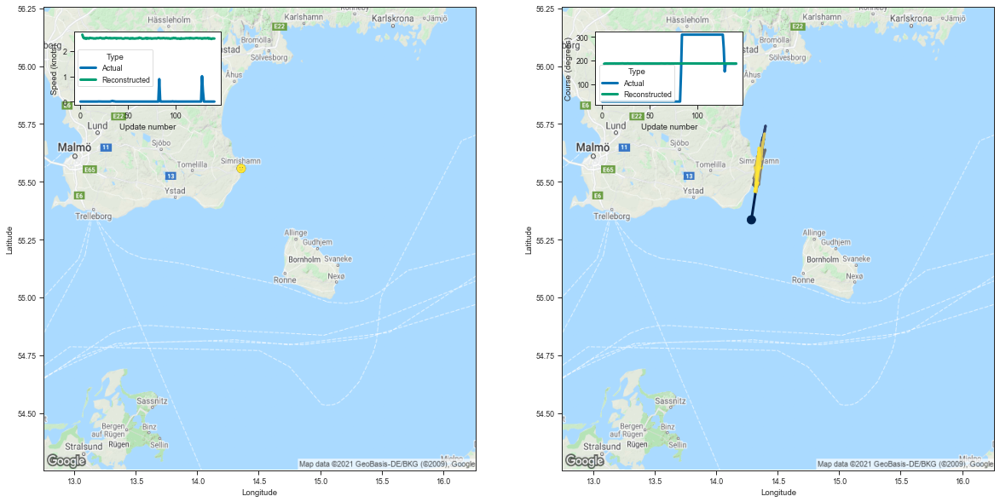

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.286713  55.335339  2.654929  186.225555         0.048045   
3    14.350859  55.559158  2.540446  187.461334         0.035246   
4    14.322256  55.539215  2.506342  187.405624         0.033424   
5    14.381503  55.624958  2.521319  187.771042         0.033312   
6    14.324484  55.457890  2.488748  187.178223         0.032808   
..         ...        ...       ...         ...              ...   
137  14.347176  55.645504  2.494635  187.810776         0.032344   
138  14.325240  55.483738  2.482948  187.311874         0.032199   
139  14.339749  55.495872  2.503397  187.351578         0.032999   
140  14.312922  55.457542  2.499907  187.184891         0.032943   
141  14.346148  55.564934  2.499403  187.546707         0.032604   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.118819     3.369830     99.830399                 1   
3          0.072241     3.279416    100.566742 

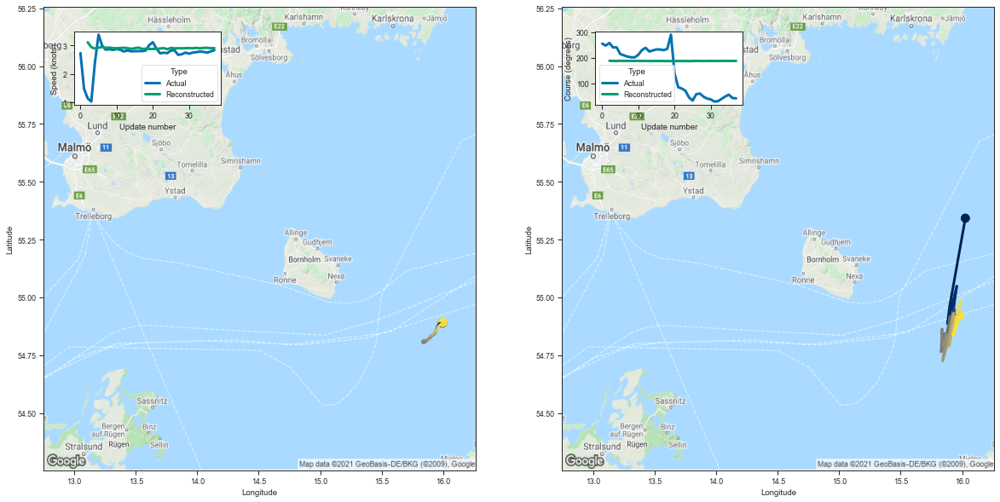

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   16.026106  55.342354  3.112140  187.944092         0.051178   
3   15.898541  54.960770  2.940009  187.525894         0.035629   
4   15.880926  54.886806  2.890683  187.251984         0.033335   
5   15.956375  55.048012  2.919222  187.899185         0.032869   
6   15.918567  54.906868  2.946116  187.360077         0.034282   
7   15.918871  54.923264  2.916755  187.467957         0.033340   
8   15.941450  54.925816  2.923277  187.457397         0.033648   
9   15.909818  54.904964  2.903696  187.333359         0.033204   
10  15.938162  54.946880  2.901876  187.436371         0.032856   
11  15.928450  54.906200  2.910822  187.416656         0.032917   
12  15.896919  54.841366  2.918573  187.120758         0.033763   
13  15.884620  54.842121  2.903078  187.114838         0.033557   
14  15.878924  54.831581  2.880557  187.082977         0.032862   
15  15.875981  54.805164  2.900486  187.024078         0.03321

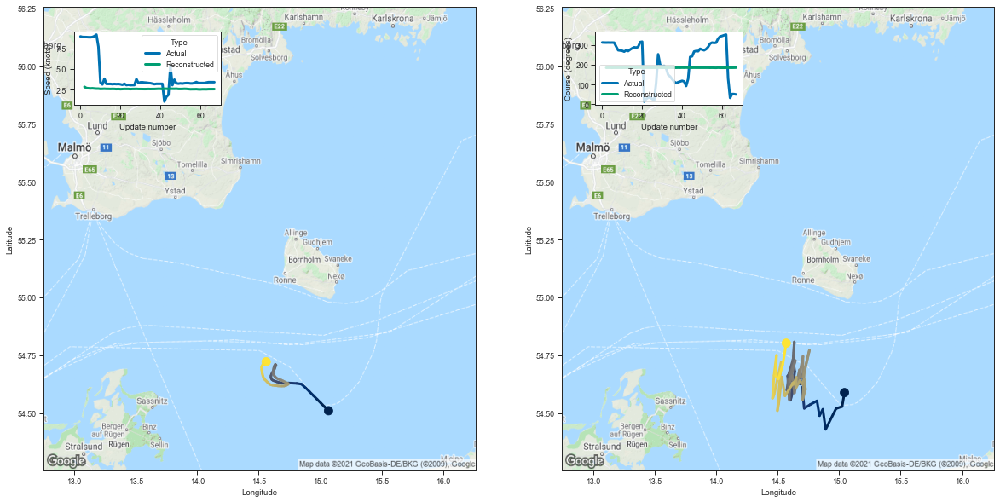

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.043538  54.588043  2.832594  184.839325         0.047712   
3   15.024168  54.527931  2.685736  185.095703         0.035480   
4   14.974892  54.519016  2.659242  185.117676         0.033231   
5   14.890489  54.429230  2.639513  184.713379         0.033754   
6   14.867774  54.515984  2.654746  185.027893         0.033467   
..        ...        ...       ...         ...              ...   
63  14.490920  54.749020  2.533348  185.278488         0.033139   
64  14.484654  54.660713  2.550498  185.063904         0.033117   
65  14.507339  54.647400  2.553122  185.010986         0.033211   
66  14.541795  54.709076  2.553658  185.181183         0.032901   
67  14.570307  54.801983  2.555416  185.530228         0.032995   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.129354     3.184434     99.064796                 1   
3         0.075395     3.100942     99.296196                

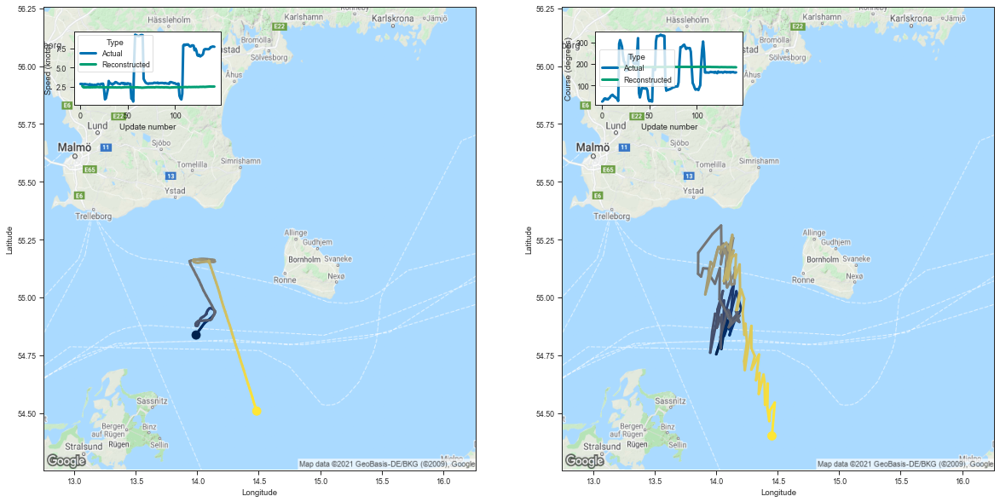

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.076218  54.888241  2.589710  184.646469         0.047953   
3    14.026274  54.792587  2.451227  184.795868         0.035230   
4    14.001066  54.753834  2.416648  184.729935         0.033473   
5    14.042658  54.826019  2.441184  185.023575         0.033808   
6    14.048259  54.812279  2.421617  184.945267         0.033232   
..         ...        ...       ...         ...              ...   
138  14.416645  54.522480  2.530146  184.531860         0.033305   
139  14.432117  54.464840  2.520765  184.343628         0.033131   
140  14.436435  54.509583  2.527337  184.462463         0.033420   
141  14.477037  54.545082  2.529346  184.578903         0.032806   
142  14.453687  54.400681  2.534251  184.157928         0.033454   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.116535     3.333874     98.997383                 1   
3          0.066013     3.254799     99.178650 

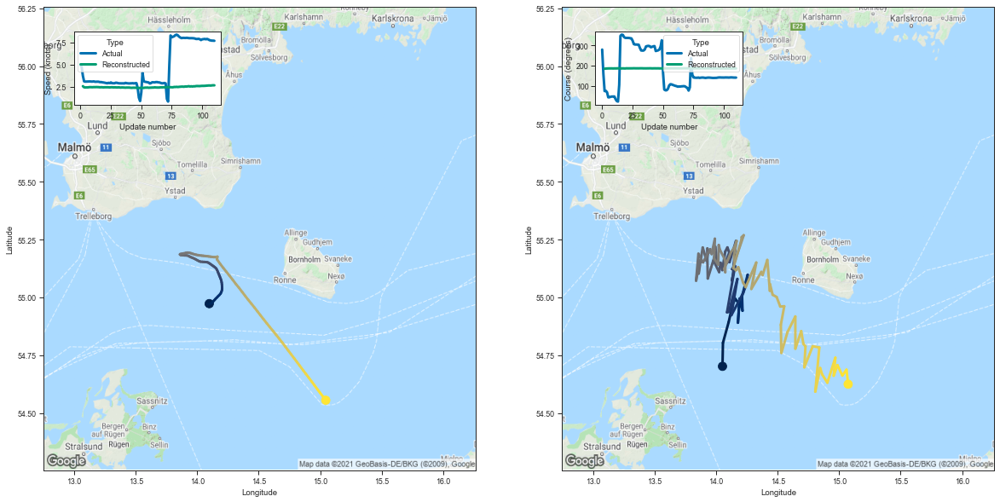

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.051824  54.701691  2.580718  184.031967         0.048236   
3    14.055598  54.803276  2.455954  184.818665         0.035696   
4    14.102059  54.893051  2.435722  185.220978         0.033230   
5    14.134641  54.969986  2.444314  185.472107         0.033306   
6    14.156711  54.993328  2.442905  185.642334         0.032410   
..         ...        ...       ...         ...              ...   
106  14.955929  54.660919  2.658883  185.465149         0.033321   
107  14.986405  54.706985  2.648806  185.693283         0.032617   
108  15.026328  54.661942  2.669140  185.660812         0.032247   
109  15.060022  54.687016  2.680809  185.769043         0.032733   
110  15.073487  54.624371  2.676713  185.575089         0.032804   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.112925     3.339012     98.680649                 1   
3          0.068469     3.254804     99.186539 

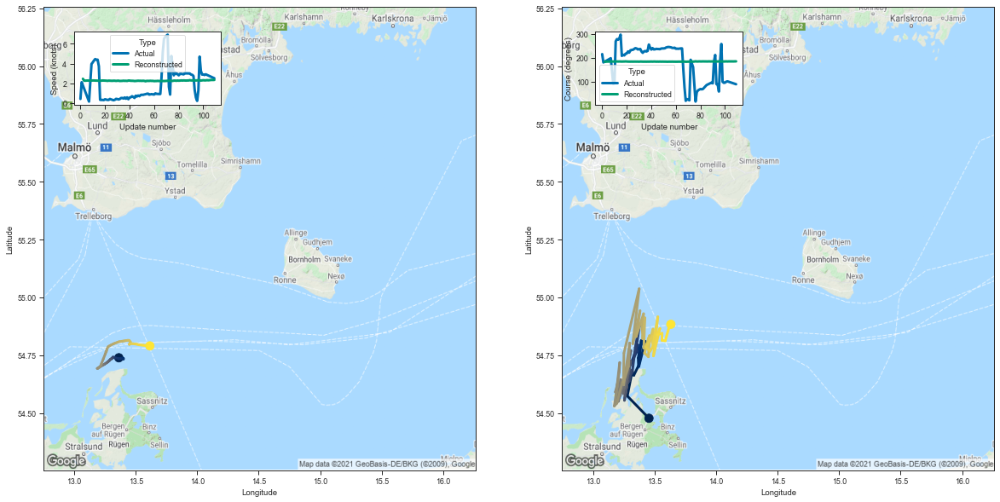

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.454053  54.477100  2.448460  182.741165         0.049350   
3    13.278442  54.573135  2.258109  183.249237         0.035873   
4    13.318112  54.681545  2.253874  183.674698         0.034094   
5    13.331126  54.662685  2.265401  183.737747         0.033291   
6    13.368944  54.704140  2.268563  183.816010         0.033902   
..         ...        ...       ...         ...              ...   
105  13.560434  54.844830  2.304420  184.469452         0.033845   
106  13.560417  54.813427  2.324626  184.400696         0.034039   
107  13.586820  54.812191  2.329432  184.368256         0.034203   
108  13.615012  54.866215  2.327624  184.617279         0.033897   
109  13.632211  54.883469  2.335595  184.662338         0.033740   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.110523     3.384390     98.006210                 1   
3          0.061716     3.340227     98.385269 

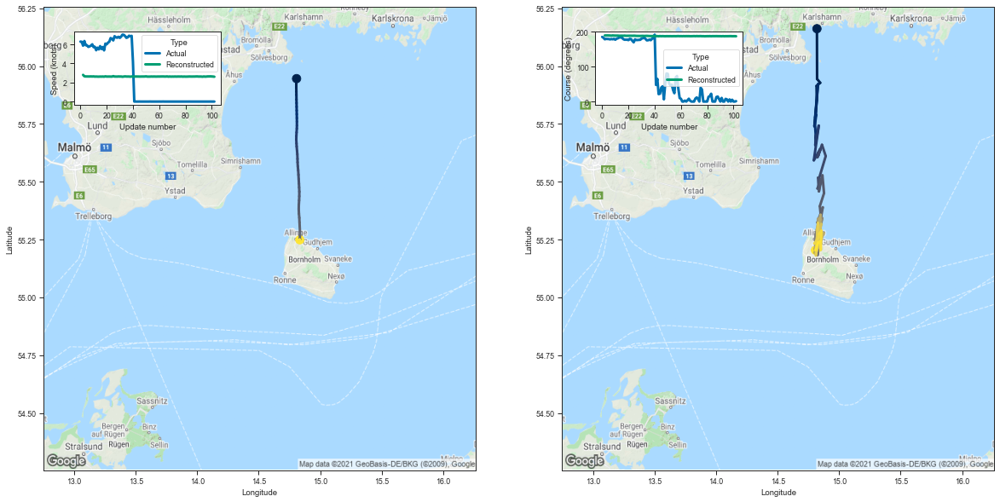

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.819650  56.161808  2.803350  189.157150         0.049664   
3    14.820810  55.944450  2.655553  189.220505         0.034631   
4    14.846402  55.927891  2.639386  189.252029         0.032900   
5    14.816191  55.914307  2.637077  189.180573         0.032966   
6    14.818460  55.852119  2.635692  189.000946         0.032600   
..         ...        ...       ...         ...              ...   
98   14.856501  55.288296  2.641895  187.338684         0.032729   
99   14.850513  55.205753  2.646692  187.092529         0.033135   
100  14.848194  55.242580  2.637173  187.140091         0.032867   
101  14.828240  55.236824  2.627023  187.165359         0.032567   
102  14.807981  55.203796  2.608783  186.961914         0.032509   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141481     3.391934    101.350029                 1   
3          0.074618     3.263117    101.485909 

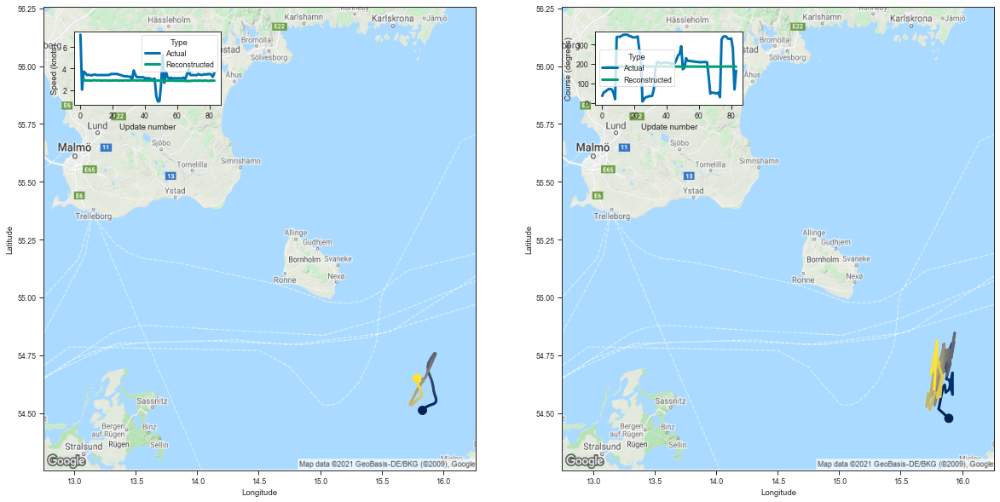

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.891754  54.476826  3.036500  185.372070         0.047730   
3   15.809128  54.517235  2.892039  185.984940         0.034902   
4   15.845130  54.611275  2.888470  186.394913         0.033434   
5   15.857774  54.620926  2.903436  186.448227         0.033667   
6   15.867102  54.589138  2.889229  186.330780         0.033211   
..        ...        ...       ...         ...              ...   
79  15.798942  54.766830  2.860136  186.821915         0.032783   
80  15.765130  54.728462  2.869870  186.645691         0.033362   
81  15.747313  54.669186  2.879912  186.512619         0.033660   
82  15.797345  54.812054  2.887344  187.012100         0.033464   
83  15.772698  54.601391  2.879212  186.321854         0.033353   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.141858     3.078230     99.310516                 1   
3         0.084438     2.990060     99.725014                

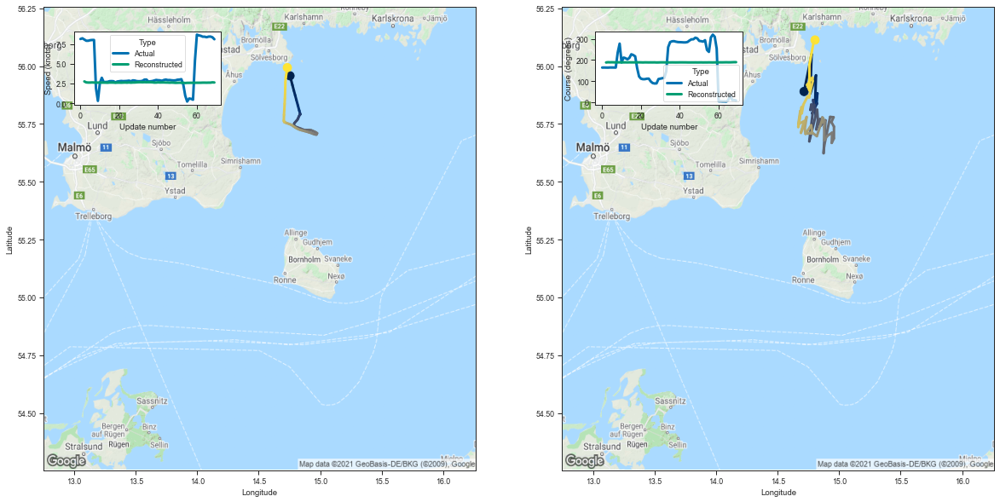

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.715211  55.890289  2.769889  188.298004         0.048718   
3   14.776323  56.051689  2.646768  189.437607         0.035289   
4   14.765888  55.882248  2.626859  189.038696         0.033311   
5   14.812093  55.960258  2.627024  189.248901         0.032885   
6   14.805041  55.840103  2.640298  188.998611         0.032721   
..        ...        ...       ...         ...              ...   
65  14.739451  55.918797  2.608026  189.001602         0.033081   
66  14.758946  55.894859  2.616389  189.068314         0.033023   
67  14.758109  56.005489  2.615637  189.398270         0.032660   
68  14.796156  56.113461  2.651491  189.818237         0.033075   
69  14.804144  56.113049  2.633947  189.768311         0.032699   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.133509     3.374019    100.907990                 1   
3         0.076736     3.283685    101.605408                

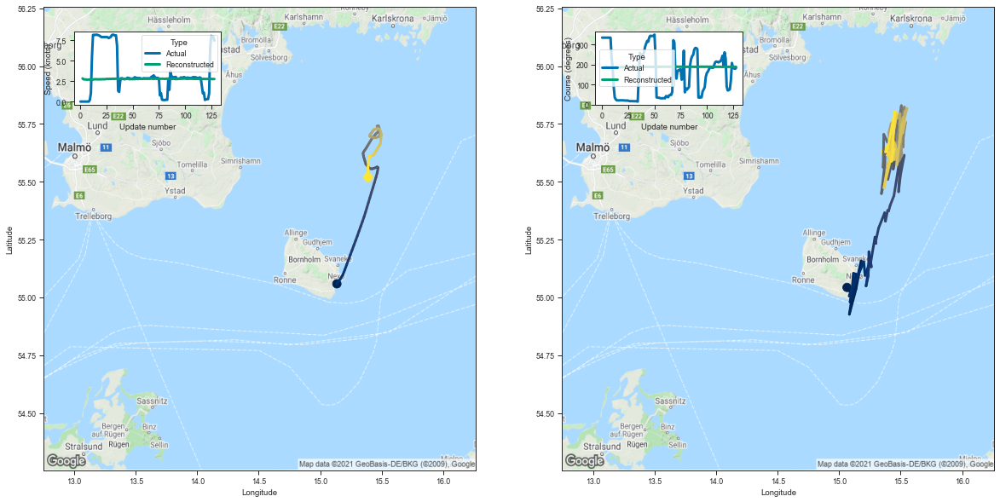

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.064216  55.042961  2.837831  186.254623         0.046968   
3    15.112630  55.003716  2.723952  186.712708         0.034752   
4    15.180017  55.157604  2.716722  187.312683         0.032666   
5    15.137489  55.036182  2.712486  186.877640         0.033032   
6    15.083150  54.926723  2.689730  186.476669         0.032843   
..         ...        ...       ...         ...              ...   
124  15.429634  55.590584  2.771046  188.883713         0.032299   
125  15.452621  55.803772  2.785914  189.509827         0.032282   
126  15.394330  55.639797  2.752082  188.946884         0.032231   
127  15.389960  55.656963  2.769291  189.025101         0.032602   
128  15.376925  55.628216  2.763854  188.927124         0.032374   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.129571     3.217121     99.815338                 1   
3          0.076872     3.117628    100.147240 

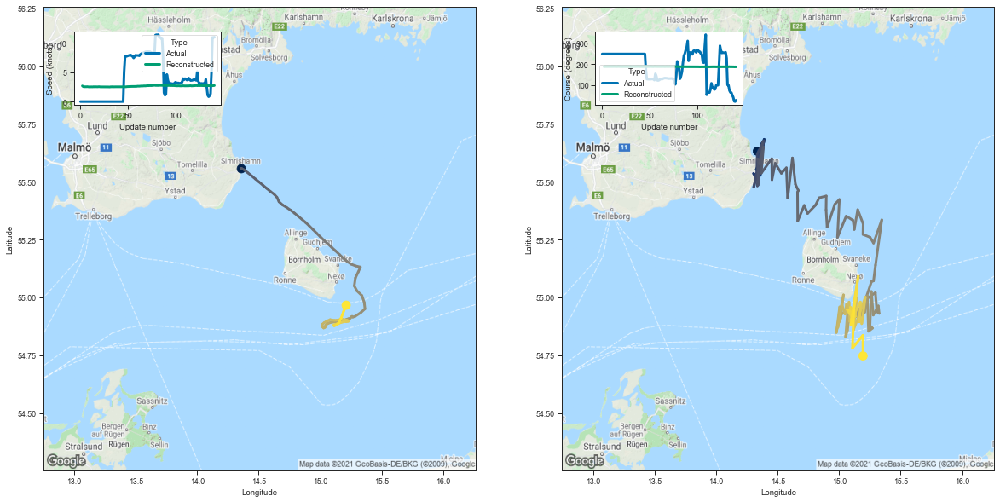

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.335749  55.632175  2.667247  187.065094         0.048883   
3    14.377620  55.606316  2.546481  187.592941         0.035509   
4    14.354316  55.547752  2.507529  187.447418         0.033231   
5    14.352114  55.591137  2.532467  187.651840         0.033545   
6    14.347739  55.589161  2.514877  187.692383         0.032944   
..         ...        ...       ...         ...              ...   
137  15.095893  54.880428  2.701226  186.334885         0.033143   
138  15.120652  54.961960  2.696733  186.602814         0.032704   
139  15.108447  54.780731  2.688765  186.041962         0.032595   
140  15.192996  54.835800  2.715488  186.313721         0.033177   
141  15.194264  54.746899  2.730843  186.073608         0.033343   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126033     3.403065    100.264488                 1   
3          0.073040     3.292773    100.630211 

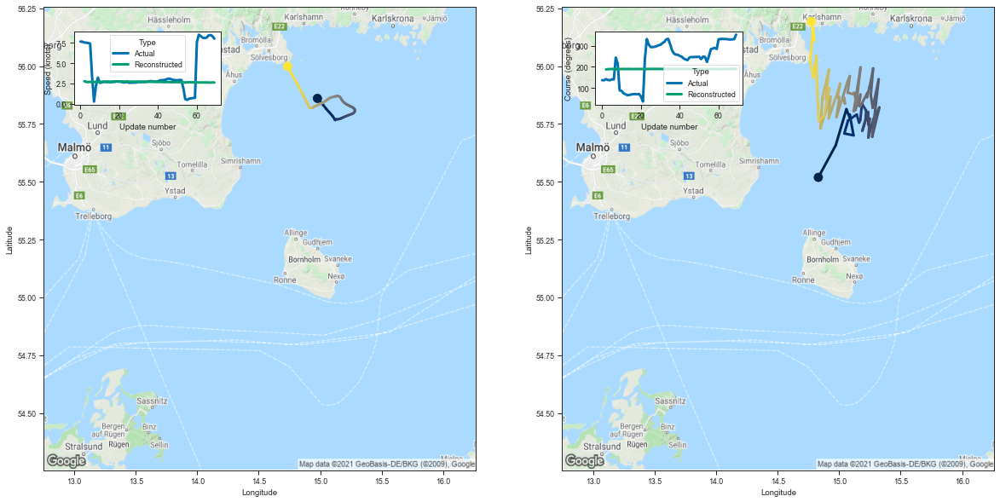

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.830935  55.518929  2.787363  187.355652         0.047970   
3   14.972297  55.657516  2.685211  188.498978         0.034460   
4   15.059253  55.813782  2.683423  189.070862         0.032564   
5   15.086073  55.776569  2.697463  189.091827         0.032785   
6   15.086535  55.790604  2.678194  189.117599         0.032054   
..        ...        ...       ...         ...              ...   
65  14.790652  55.950317  2.632136  189.296295         0.032876   
66  14.764350  56.019016  2.624757  189.447617         0.033025   
67  14.788704  56.166058  2.613080  189.892715         0.031971   
68  14.797266  56.109383  2.635019  189.708954         0.032945   
69  14.773897  56.193157  2.614092  189.979065         0.032420   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.127606     3.330022    100.404182                 1   
3         0.075382     3.212748    101.106750                

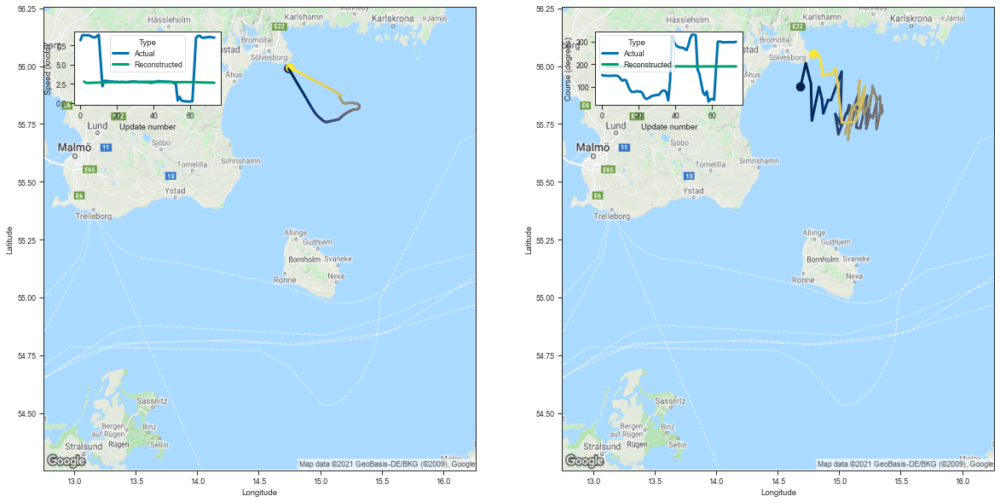

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.686664  55.910309  2.785445  188.363403         0.049560   
3   14.728908  56.012627  2.621801  189.205215         0.034963   
4   14.771122  55.924458  2.622841  189.145309         0.032962   
5   14.778586  55.765350  2.606350  188.654572         0.032318   
6   14.836741  55.909618  2.622888  189.170959         0.032523   
..        ...        ...       ...         ...              ...   
69  14.905605  55.968262  2.652157  189.458878         0.032749   
70  14.866785  55.958530  2.645023  189.304443         0.032935   
71  14.847999  56.033508  2.647223  189.603409         0.032805   
72  14.821564  56.054455  2.638000  189.656921         0.032687   
73  14.794580  56.052647  2.629715  189.573837         0.032703   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.142035     3.367059    100.937950                 1   
3         0.074289     3.302391    101.486671                

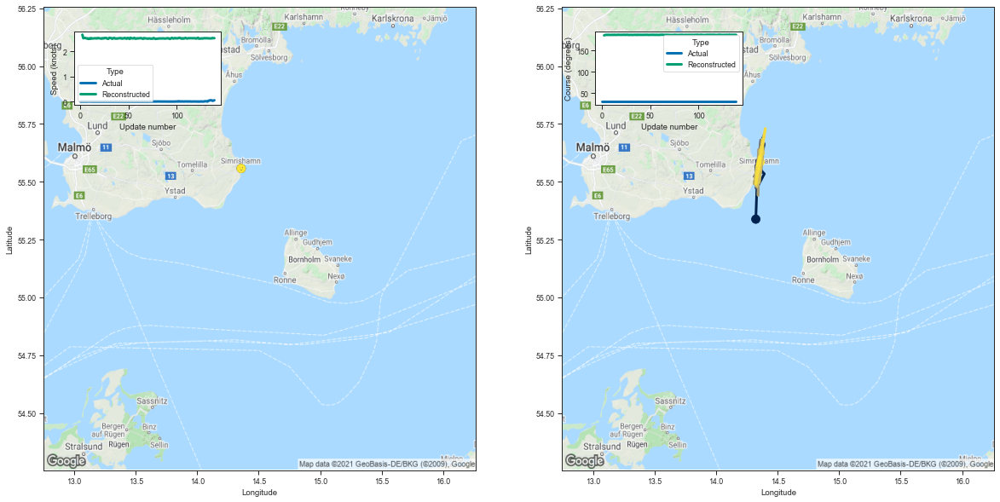

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.322798  55.338116  2.659439  186.282379         0.048057   
3    14.331340  55.472149  2.516006  187.235123         0.034515   
4    14.391606  55.534019  2.526440  187.531784         0.033354   
5    14.330972  55.571415  2.526231  187.592941         0.033475   
6    14.359012  55.594418  2.512532  187.622818         0.033278   
..         ...        ...       ...         ...              ...   
135  14.348791  55.554600  2.505580  187.576981         0.032970   
136  14.361087  55.611462  2.509622  187.664886         0.033068   
137  14.335835  55.570595  2.524765  187.661041         0.032947   
138  14.351948  55.607525  2.517566  187.763519         0.032971   
139  14.357281  55.584793  2.519500  187.655457         0.033026   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.119564     3.355687     99.861038                 1   
3          0.068758     3.275069    100.466553 

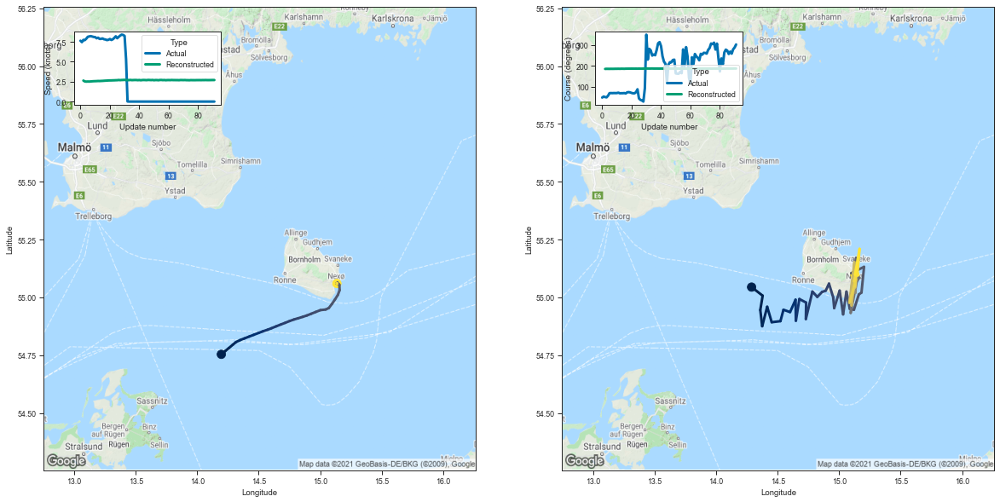

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.288432  55.044338  2.636629  185.313416         0.048280   
3   14.378357  55.007149  2.528575  185.734299         0.035671   
4   14.359139  54.945290  2.509339  185.677444         0.033398   
5   14.374696  54.875107  2.521394  185.547897         0.033175   
6   14.415226  54.959251  2.512774  185.774445         0.033133   
..        ...        ...       ...         ...              ...   
87  15.142618  55.103584  2.695982  187.076584         0.032487   
88  15.135044  55.093410  2.698536  187.093048         0.032086   
89  15.147527  55.095070  2.703613  187.096832         0.032568   
90  15.166179  55.209694  2.706366  187.451736         0.032547   
91  15.128541  55.097527  2.705294  187.140182         0.032661   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.119177     3.340475     99.345055                 1   
3         0.070336     3.247534     99.663597                

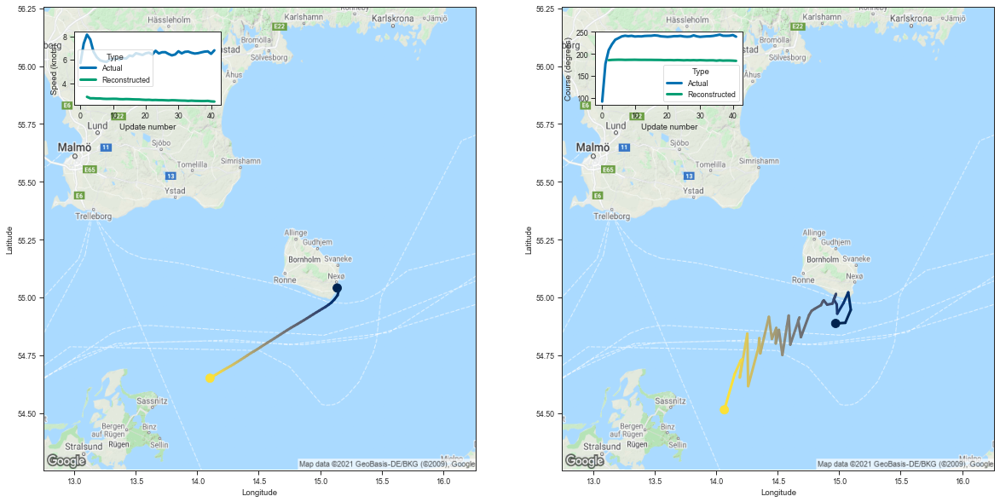

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.971781  54.887104  2.830429  185.675018         0.047544   
3   15.050186  54.889877  2.708249  186.296539         0.034745   
4   15.095003  54.946011  2.708463  186.541901         0.033574   
5   15.074277  55.021652  2.691667  186.722321         0.033072   
6   15.035690  54.975616  2.692385  186.635651         0.033307   
7   14.984681  54.929348  2.666204  186.349503         0.032713   
8   14.980829  54.969326  2.656145  186.483734         0.032640   
9   14.957174  54.991142  2.659354  186.548706         0.032767   
10  14.974563  55.014553  2.665109  186.646805         0.033168   
11  14.945555  54.972851  2.662447  186.477219         0.032835   
12  14.902521  54.968384  2.637609  186.390884         0.032614   
13  14.874959  54.987019  2.630002  186.419342         0.032609   
14  14.867307  54.982086  2.642443  186.347183         0.032972   
15  14.852058  54.966053  2.634516  186.362076         0.03300

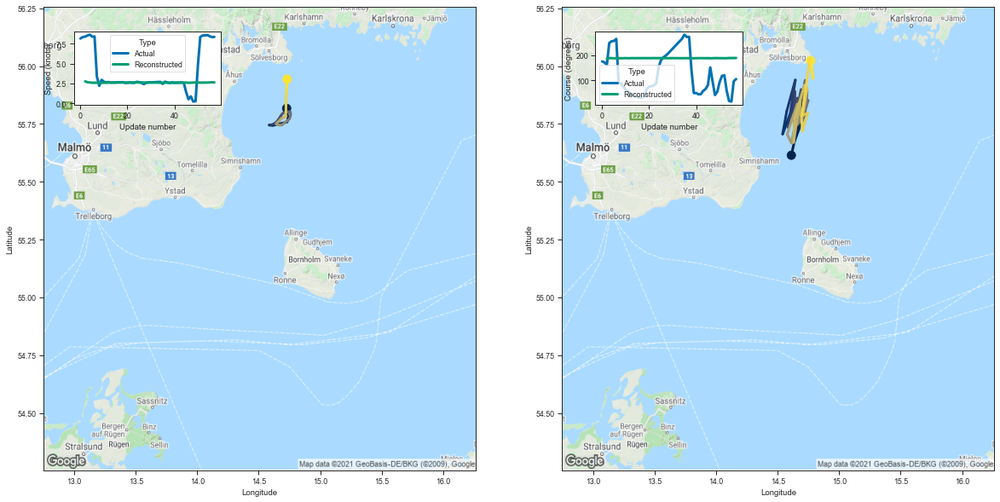

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.611620  55.614464  2.754623  187.319778         0.049565   
3   14.721976  55.880634  2.643989  188.854340         0.035029   
4   14.723801  55.798378  2.611523  188.702820         0.033268   
5   14.635638  55.673149  2.580110  188.151810         0.032886   
6   14.636666  55.758026  2.577219  188.477463         0.032719   
7   14.626186  55.828587  2.585453  188.680908         0.032876   
8   14.540768  55.705982  2.555721  188.243530         0.032548   
9   14.574570  55.805824  2.568455  188.480301         0.032739   
10  14.643983  55.940041  2.580168  189.009567         0.032805   
11  14.586016  55.734627  2.573490  188.337860         0.033009   
12  14.634988  55.846935  2.591881  188.716156         0.033276   
13  14.639266  55.891064  2.600889  188.907455         0.033036   
14  14.638572  55.809288  2.590282  188.620285         0.033264   
15  14.650808  55.859680  2.593965  188.870773         0.03258

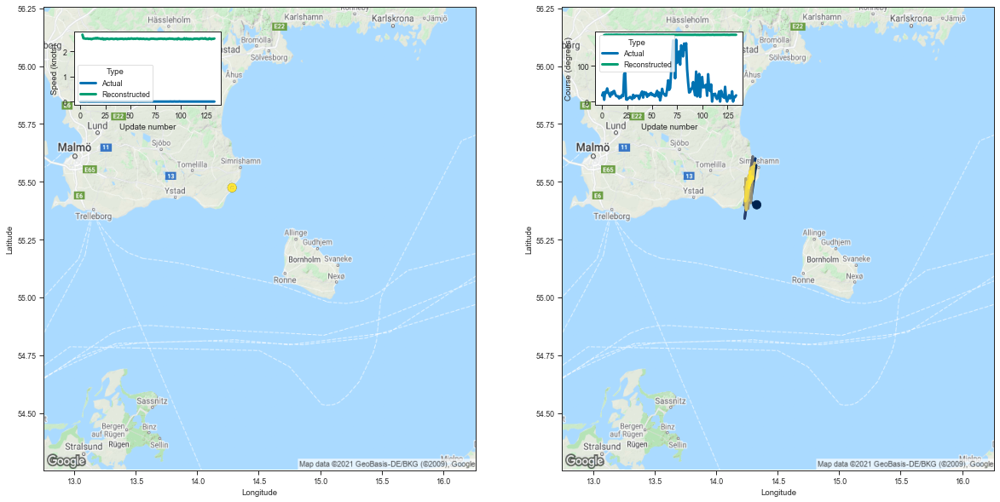

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.330343  55.400410  2.658655  186.512878         0.047848   
3    14.279791  55.412151  2.511783  186.896286         0.035231   
4    14.324695  55.571457  2.507701  187.587677         0.033100   
5    14.263070  55.434303  2.497130  186.996002         0.033883   
6    14.279048  55.515129  2.497476  187.419876         0.033165   
..         ...        ...       ...         ...              ...   
130  14.271533  55.514381  2.493016  187.330154         0.032902   
131  14.275757  55.544094  2.476382  187.415909         0.032831   
132  14.269134  55.481716  2.492828  187.216034         0.032864   
133  14.291488  55.523216  2.490792  187.381638         0.032922   
134  14.265334  55.473480  2.503350  187.263458         0.033223   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.120220     3.354369     99.970306                 1   
3          0.069651     3.297132    100.283691 

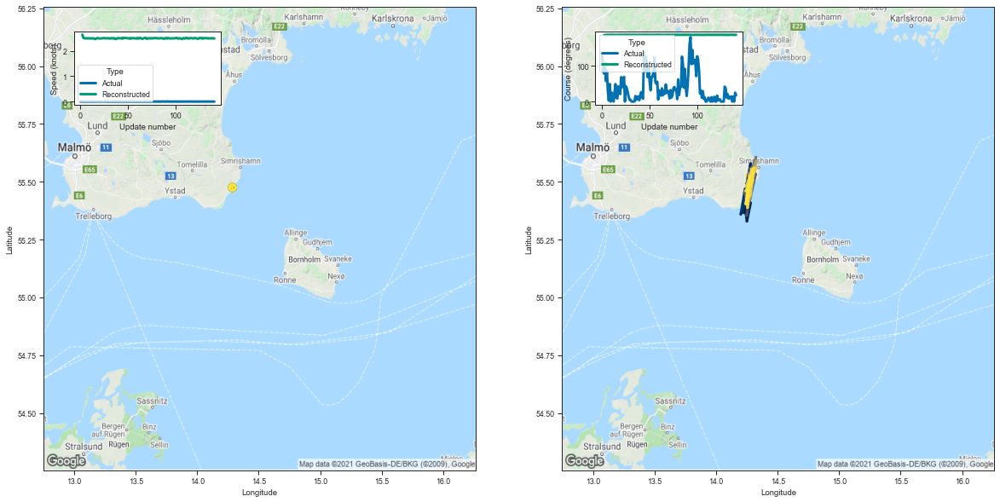

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.238640  55.378639  2.636221  186.332809         0.047777   
3    14.250309  55.328804  2.514003  186.694931         0.035490   
4    14.280916  55.408775  2.497787  187.040802         0.033336   
5    14.259538  55.400928  2.487706  186.994156         0.032944   
6    14.244934  55.442616  2.488423  187.069626         0.033093   
..         ...        ...       ...         ...              ...   
137  14.287133  55.489857  2.494886  187.265457         0.032818   
138  14.254809  55.464558  2.483196  187.160492         0.032819   
139  14.258819  55.441273  2.499665  187.149872         0.033278   
140  14.240685  55.403618  2.489758  186.961838         0.033048   
141  14.276045  55.523590  2.483990  187.381989         0.032886   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.115806     3.375960     99.883499                 1   
3          0.071501     3.269098    100.166389 

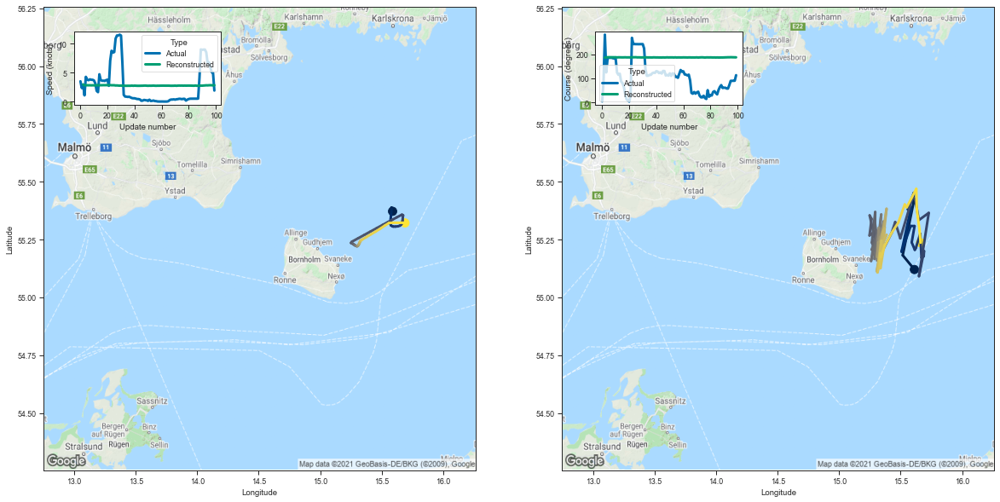

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.611954  55.120457  2.972747  187.075363         0.047128   
3   15.517027  55.182140  2.821650  187.652863         0.034497   
4   15.603719  55.406311  2.816364  188.510651         0.032765   
5   15.607012  55.429459  2.830737  188.634689         0.032586   
6   15.607432  55.452015  2.818690  188.588913         0.032561   
..        ...        ...       ...         ...              ...   
95  15.627322  55.469311  2.827601  188.711594         0.032717   
96  15.631129  55.381847  2.835822  188.497238         0.032744   
97  15.639176  55.349487  2.827412  188.384384         0.032256   
98  15.654270  55.287743  2.812176  188.209671         0.031984   
99  15.661988  55.236366  2.826957  188.078415         0.032486   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.137051     3.163801    100.228058                 1   
3         0.079986     3.094375    100.633553                

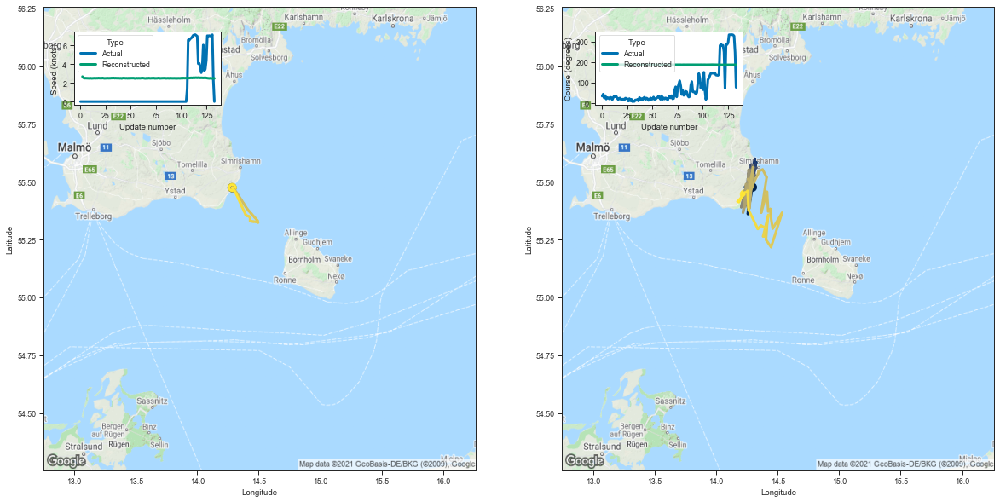

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.294962  55.476120  2.661080  186.775024         0.047481   
3    14.258072  55.360531  2.530914  186.809860         0.035511   
4    14.265906  55.440853  2.490002  187.069519         0.033444   
5    14.272752  55.483269  2.496686  187.262558         0.033284   
6    14.283669  55.474022  2.492401  187.211899         0.033213   
..         ...        ...       ...         ...              ...   
129  14.248418  55.454933  2.490641  187.123489         0.033310   
130  14.227789  55.453003  2.464512  187.098694         0.033050   
131  14.185463  55.412182  2.472064  186.952652         0.033164   
132  14.174397  55.414116  2.472253  186.873032         0.033380   
133  14.229966  55.446072  2.471925  187.009918         0.033110   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.118306     3.366157    100.113892                 1   
3          0.072389     3.271936    100.225731 

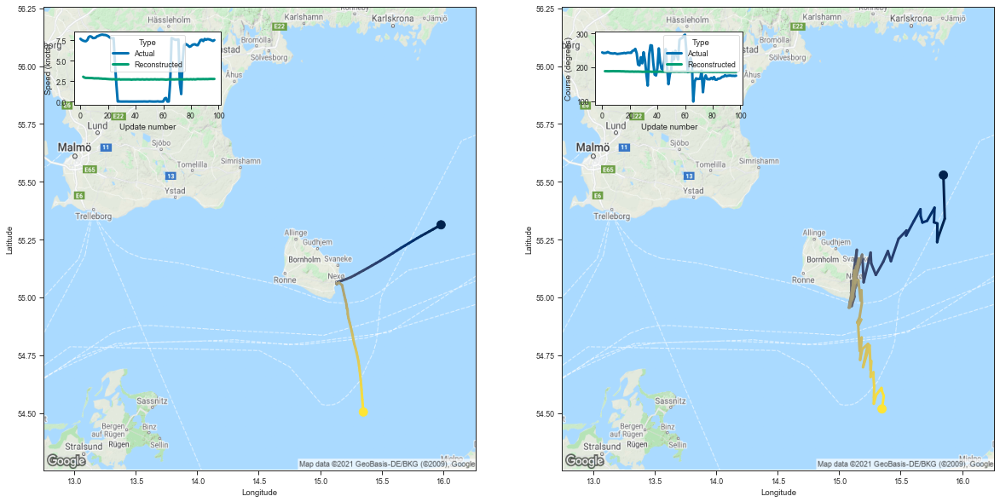

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.847778  55.528873  3.029804  188.525940         0.047664   
3   15.858832  55.340431  2.922658  188.547516         0.035171   
4   15.806985  55.261951  2.885940  188.351105         0.033077   
5   15.796878  55.238716  2.888082  188.271561         0.032885   
6   15.798805  55.319592  2.882782  188.468445         0.033070   
..        ...        ...       ...         ...              ...   
93  15.300272  54.577309  2.753324  185.726593         0.032988   
94  15.344424  54.608368  2.760498  185.786743         0.033331   
95  15.348539  54.594219  2.762852  185.745300         0.033345   
96  15.362973  54.573715  2.756543  185.761887         0.033050   
97  15.348658  54.517456  2.762515  185.594269         0.032999   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.143758     3.183711    100.998947                 1   
3         0.086799     3.068655    101.095406                

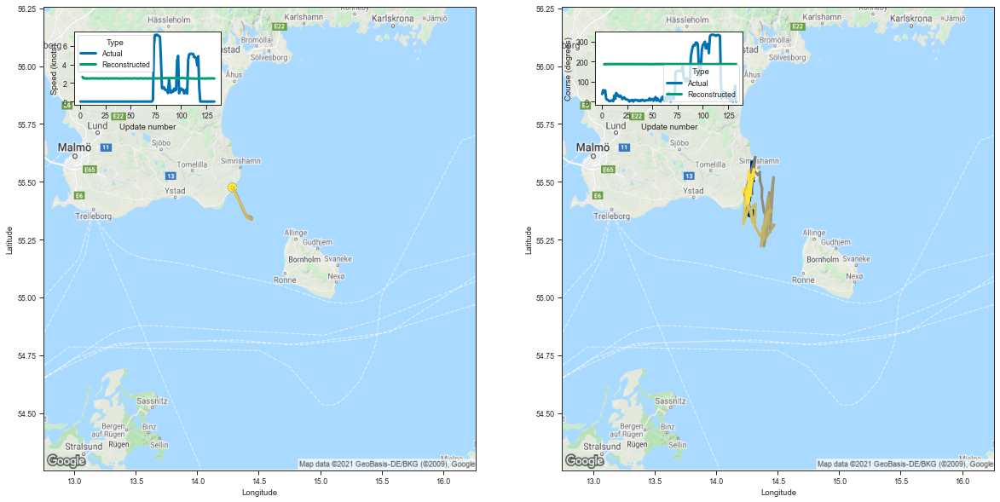

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.280146  55.365780  2.660185  186.309525         0.048697   
3    14.255273  55.428734  2.510966  186.979263         0.035247   
4    14.288469  55.477764  2.519701  187.228851         0.034011   
5    14.289249  55.586300  2.490402  187.520416         0.033075   
6    14.285754  55.544750  2.489404  187.363541         0.033135   
..         ...        ...       ...         ...              ...   
129  14.264260  55.544525  2.478826  187.393005         0.032866   
130  14.262763  55.412342  2.513200  187.018600         0.033406   
131  14.307446  55.553856  2.507818  187.408310         0.033619   
132  14.257833  55.405891  2.481356  186.916092         0.033278   
133  14.246644  55.457977  2.493176  187.075546         0.033235   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126523     3.357613     99.853325                 1   
3          0.070188     3.288268    100.316826 

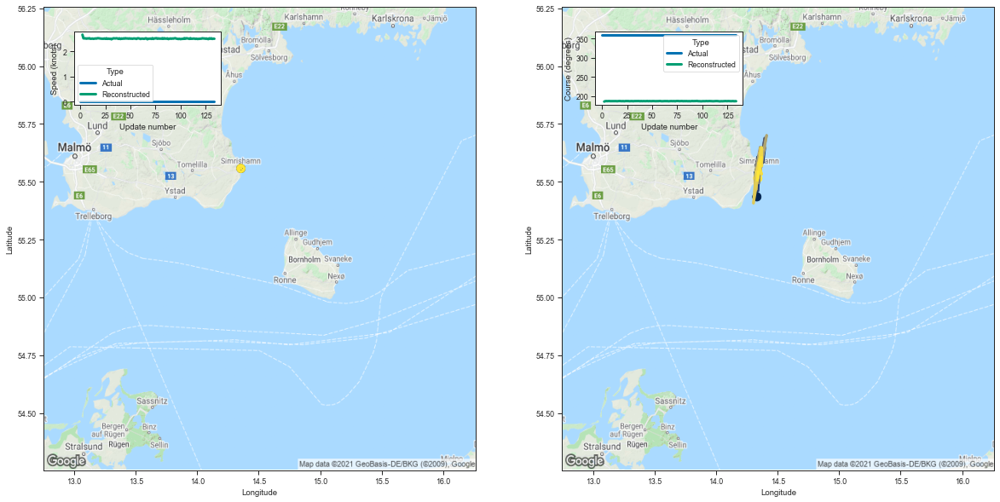

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.331211  55.434772  2.670385  186.457016         0.049162   
3    14.318033  55.540703  2.523508  187.362564         0.035036   
4    14.362710  55.607677  2.519670  187.745911         0.033177   
5    14.359591  55.552937  2.523501  187.505386         0.033411   
6    14.348754  55.607018  2.508978  187.728134         0.033066   
..         ...        ...       ...         ...              ...   
130  14.345479  55.579784  2.506418  187.610992         0.032851   
131  14.368662  55.606441  2.523160  187.733383         0.032961   
132  14.335605  55.506695  2.499475  187.300430         0.033084   
133  14.340324  55.542877  2.510674  187.551178         0.032970   
134  14.338595  55.514759  2.505200  187.410934         0.032633   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.125909     3.379361     99.947479                 1   
3          0.070459     3.292096    100.521217 

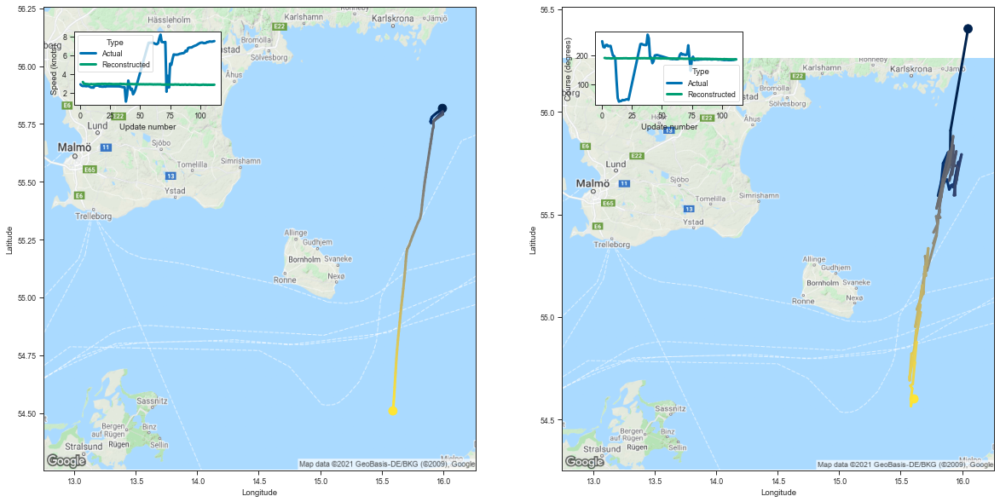

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    16.048437  56.405216  3.128382  191.069229         0.050591   
3    15.905487  55.909130  2.929374  190.261536         0.034866   
4    15.902594  55.758423  2.922097  189.804428         0.033650   
5    15.899165  55.781166  2.904783  190.045898         0.031987   
6    15.887786  55.767075  2.897635  189.957809         0.032185   
..         ...        ...       ...         ...              ...   
108  15.594748  54.650467  2.821346  186.190826         0.033173   
109  15.587541  54.618797  2.826087  186.100174         0.033200   
110  15.583889  54.564823  2.823833  185.987152         0.033080   
111  15.591538  54.592930  2.824012  186.003052         0.033402   
112  15.608543  54.600277  2.835299  186.076935         0.033589   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.184131     3.268440    102.297211                 1   
3          0.088969     3.117635    101.990433 

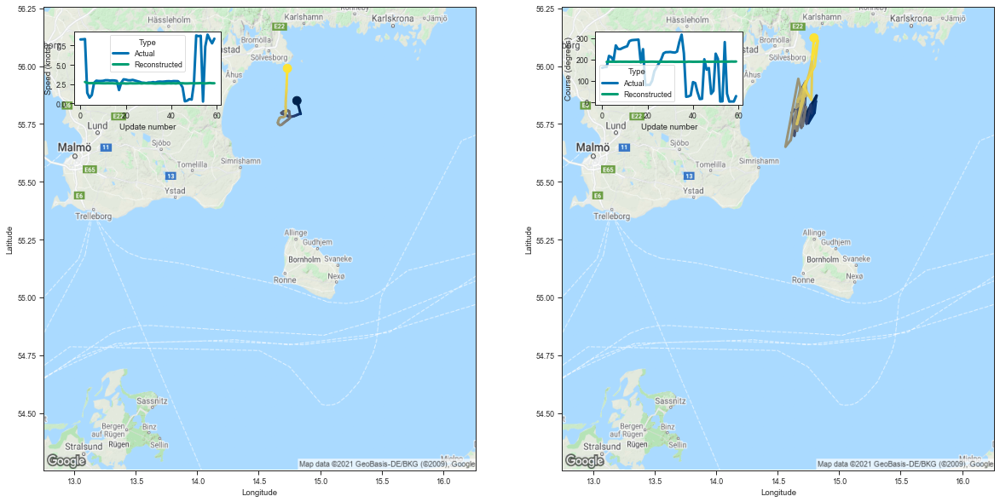

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.718257  55.782444  2.778643  187.903366         0.049356   
3   14.816802  55.872540  2.649638  188.878113         0.035191   
4   14.776893  55.785152  2.617958  188.723480         0.033041   
5   14.795123  55.838516  2.630696  188.896286         0.033179   
6   14.748487  55.752583  2.611110  188.563599         0.032791   
7   14.800127  55.798317  2.617179  188.829727         0.032163   
8   14.811359  55.848640  2.620275  188.959564         0.032366   
9   14.776601  55.795410  2.609270  188.748367         0.032335   
10  14.769493  55.833023  2.600752  188.868942         0.032213   
11  14.757012  55.805332  2.599683  188.800613         0.032117   
12  14.735168  55.751106  2.607757  188.634201         0.032507   
13  14.718490  55.796104  2.603820  188.702682         0.032681   
14  14.725061  55.869694  2.606299  188.922363         0.032730   
15  14.667301  55.810333  2.586954  188.624084         0.03298

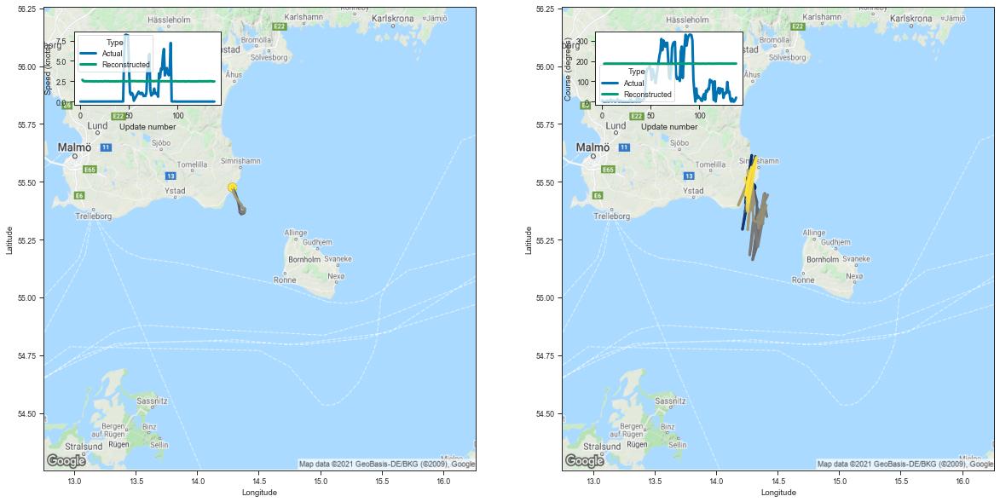

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.291127  55.476250  2.677328  186.586502         0.049841   
3    14.270325  55.499828  2.530514  187.225296         0.035759   
4    14.276325  55.472565  2.498049  187.230438         0.033389   
5    14.286062  55.527149  2.490060  187.409561         0.033056   
6    14.281605  55.498009  2.504938  187.289841         0.033343   
..         ...        ...       ...         ...              ...   
134  14.327624  55.604462  2.516083  187.587555         0.033760   
135  14.269959  55.519676  2.496155  187.261444         0.033502   
136  14.240752  55.442135  2.487363  187.044342         0.033160   
137  14.259752  55.498859  2.466465  187.211548         0.032718   
138  14.263417  55.510315  2.485514  187.308090         0.033068   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.131051     3.378567    100.009323                 1   
3          0.073573     3.282816    100.438972 

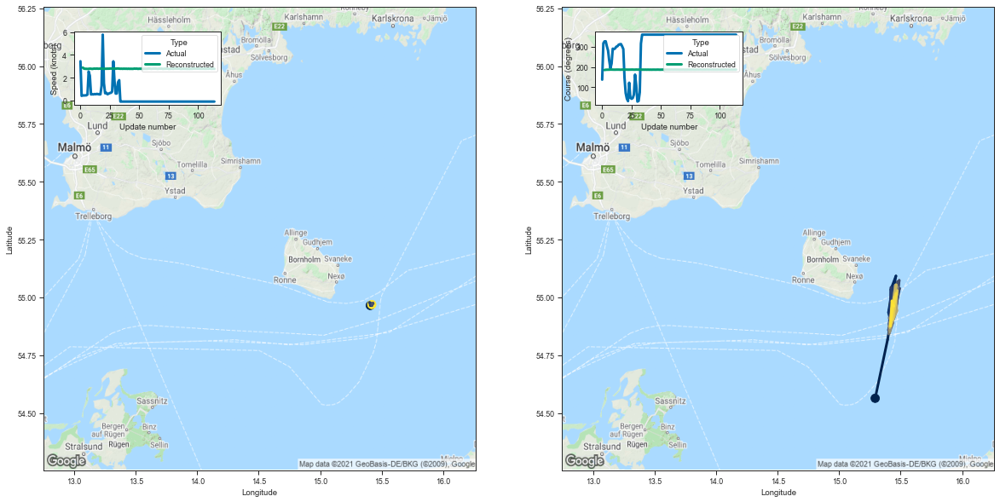

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.293097  54.563545  2.879145  185.090088         0.046506   
3    15.393879  54.816803  2.791603  186.445221         0.034565   
4    15.412008  54.874554  2.772874  186.649918         0.033082   
5    15.419413  54.920483  2.772878  186.872269         0.032718   
6    15.402650  54.932091  2.761311  186.856598         0.032382   
..         ...        ...       ...         ...              ...   
110  15.432587  54.961861  2.789287  187.005920         0.032523   
111  15.417985  54.875359  2.775001  186.669434         0.032948   
112  15.429049  54.984558  2.769166  187.070557         0.032223   
113  15.444405  54.961967  2.783189  186.993469         0.032935   
114  15.437356  54.965302  2.765919  187.033478         0.032268   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.127716     3.145006     99.190712                 1   
3          0.079071     3.074034     99.990089 

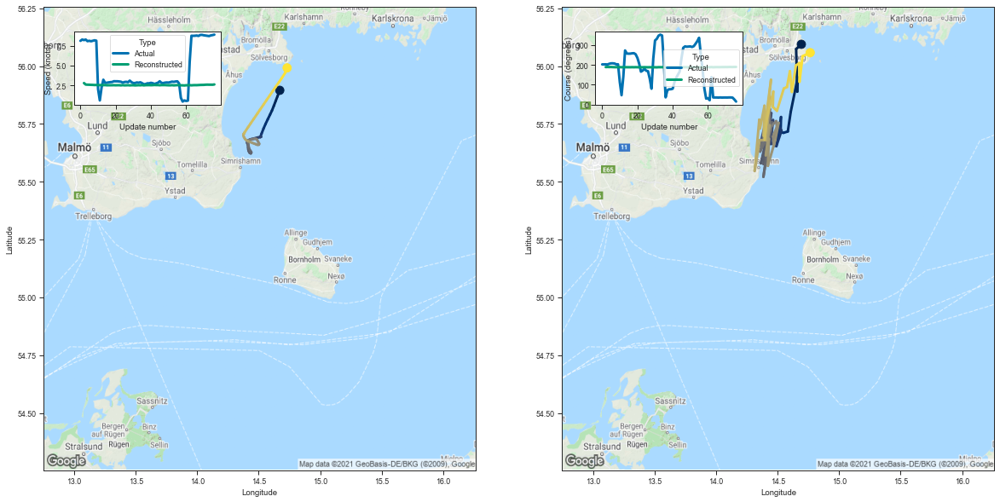

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.693031  56.094460  2.799941  188.733795         0.051536   
3   14.650620  56.073864  2.611695  189.345947         0.035059   
4   14.659900  55.889690  2.596691  188.889389         0.033303   
5   14.663879  55.951107  2.590468  189.135147         0.032605   
6   14.606640  55.802227  2.577519  188.651260         0.032664   
..        ...        ...       ...         ...              ...   
72  14.648602  56.002491  2.601777  189.292007         0.033204   
73  14.676319  56.013268  2.594815  189.334610         0.032545   
74  14.677885  55.931957  2.596549  189.051727         0.032835   
75  14.702921  56.042961  2.591637  189.418152         0.032854   
76  14.764990  56.058247  2.626040  189.585129         0.032745   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.150886     3.400174    101.112701                 1   
3         0.073492     3.307386    101.564812                

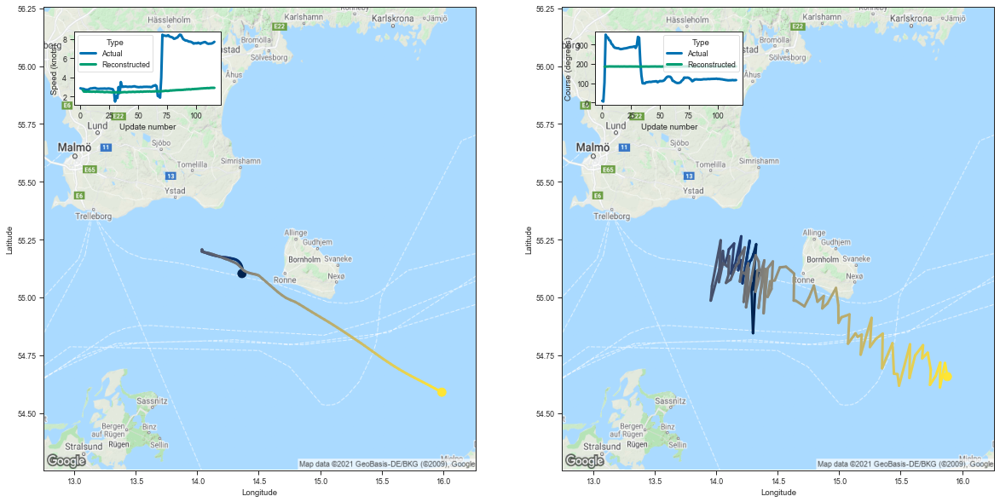

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.323733  55.097347  2.670427  185.504333         0.048783   
3    14.300060  54.845219  2.498055  185.186127         0.034747   
4    14.287128  55.061665  2.503910  186.005249         0.033308   
5    14.299369  55.033424  2.490132  185.937454         0.032844   
6    14.325764  55.229450  2.508225  186.559921         0.033039   
..         ...        ...       ...         ...              ...   
112  15.785802  54.660507  2.871341  186.484680         0.032997   
113  15.822227  54.718315  2.891059  186.706924         0.033462   
114  15.819732  54.610634  2.890394  186.379669         0.033647   
115  15.860710  54.716019  2.893484  186.760406         0.032984   
116  15.880054  54.657310  2.889072  186.479416         0.033642   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.125346     3.335022     99.438210                 1   
3          0.067504     3.229746     99.375931 

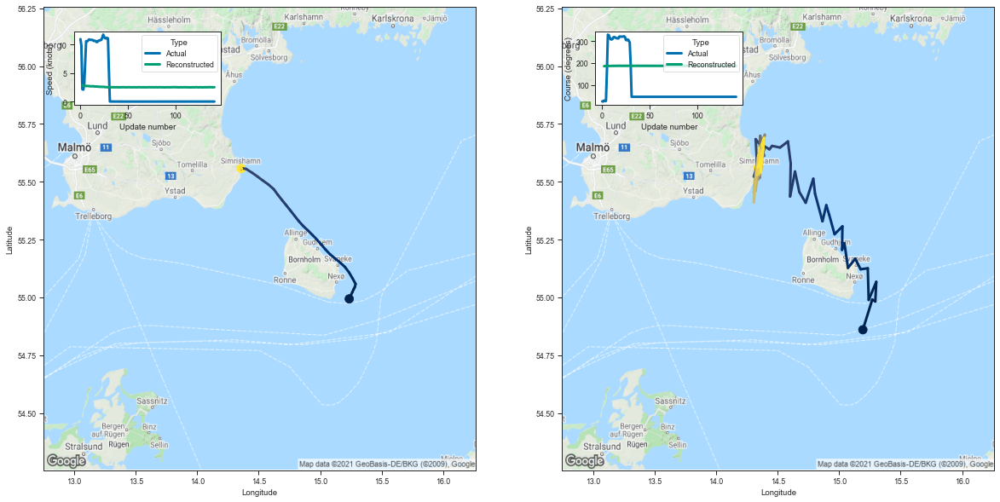

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.193023  54.859921  2.880436  185.830826         0.048334   
3    15.269265  54.990513  2.761281  186.815964         0.035069   
4    15.294040  54.981949  2.747813  186.854416         0.033051   
5    15.301984  55.067162  2.749023  187.184265         0.032510   
6    15.240440  54.988937  2.725238  186.878036         0.032817   
..         ...        ...       ...         ...              ...   
137  14.370481  55.659256  2.519039  187.912643         0.032946   
138  14.390153  55.689610  2.519677  188.003571         0.032915   
139  14.364322  55.540821  2.510486  187.444763         0.033114   
140  14.360439  55.591156  2.521841  187.646118         0.033312   
141  14.340014  55.561562  2.517779  187.571930         0.033274   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.137103     3.195806     99.577950                 1   
3          0.079231     3.108735    100.191589 

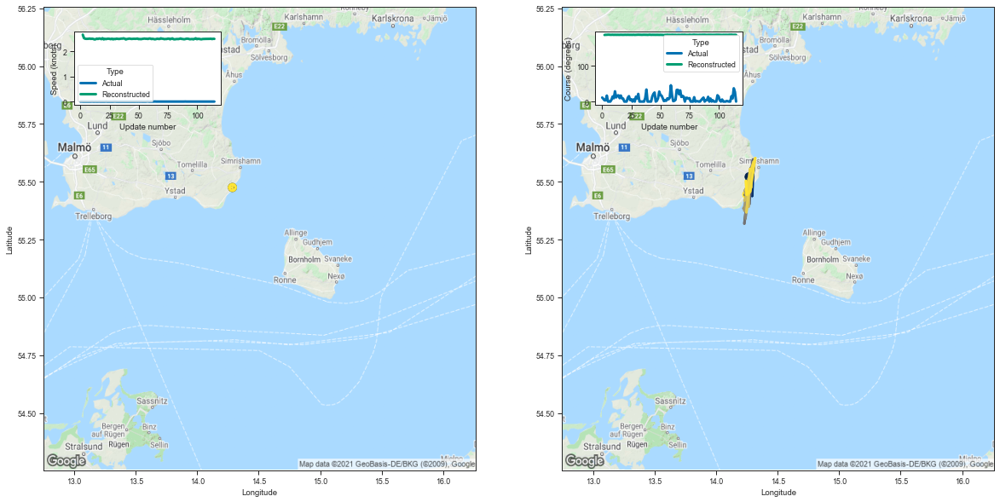

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.268822  55.521320  2.660781  186.712967         0.049678   
3    14.281944  55.491161  2.524648  187.211456         0.035351   
4    14.291353  55.496475  2.498919  187.225647         0.033520   
5    14.308801  55.568928  2.493902  187.562271         0.032896   
6    14.306002  55.565666  2.494707  187.498932         0.033065   
..         ...        ...       ...         ...              ...   
111  14.318172  55.602531  2.493713  187.583954         0.033055   
112  14.277572  55.461983  2.498131  187.147598         0.033325   
113  14.248747  55.443836  2.484667  187.107254         0.032948   
114  14.242849  55.503731  2.496393  187.267792         0.033090   
115  14.249326  55.445000  2.492018  187.022293         0.033647   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.127615     3.399192    100.076591                 1   
3          0.071129     3.287041    100.449684 

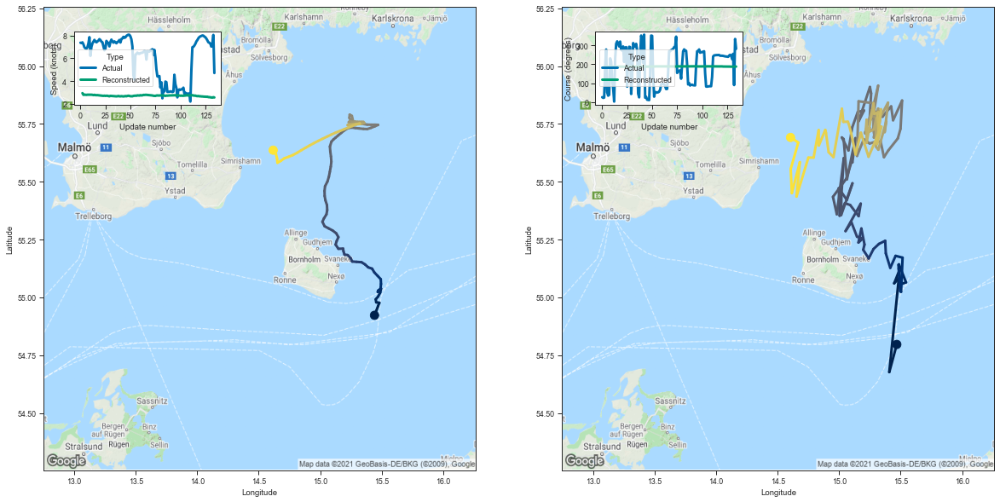

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.468790  54.796413  2.949803  185.962433         0.047959   
3    15.407723  54.676720  2.799341  186.028152         0.035010   
4    15.485168  55.081898  2.810043  187.452072         0.033756   
5    15.447544  55.060616  2.806977  187.331314         0.033390   
6    15.486788  55.112617  2.795518  187.534042         0.032766   
..         ...        ...       ...         ...              ...   
130  14.680616  55.584740  2.582087  188.021194         0.032552   
131  14.615674  55.450565  2.574442  187.515656         0.033170   
132  14.606464  55.555405  2.558754  187.762924         0.033029   
133  14.668032  55.669468  2.591974  188.281815         0.032873   
134  14.605231  55.691525  2.569130  188.242676         0.032908   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.139393     3.149219     99.639145                 1   
3          0.079590     3.054006     99.771027 

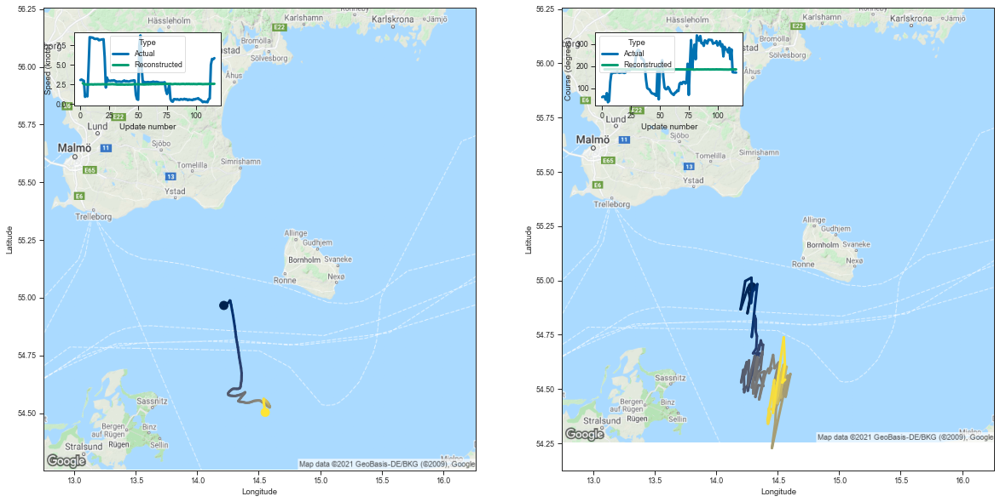

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.292415  54.970375  2.649863  185.103043         0.048556   
3    14.254431  54.849155  2.520607  185.335663         0.035362   
4    14.276599  54.911106  2.500450  185.546875         0.033303   
5    14.258615  54.966972  2.486406  185.668915         0.033045   
6    14.198891  54.866859  2.461323  185.316284         0.032787   
..         ...        ...       ...         ...              ...   
112  14.462002  54.390297  2.534886  184.152328         0.033436   
113  14.549876  54.738419  2.557286  185.354919         0.033215   
114  14.559685  54.613438  2.559830  184.941437         0.033194   
115  14.536988  54.529964  2.548305  184.651611         0.033058   
116  14.561603  54.544285  2.564174  184.729401         0.033289   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.120529     3.328376     99.234840                 1   
3          0.070693     3.212763     99.447433 

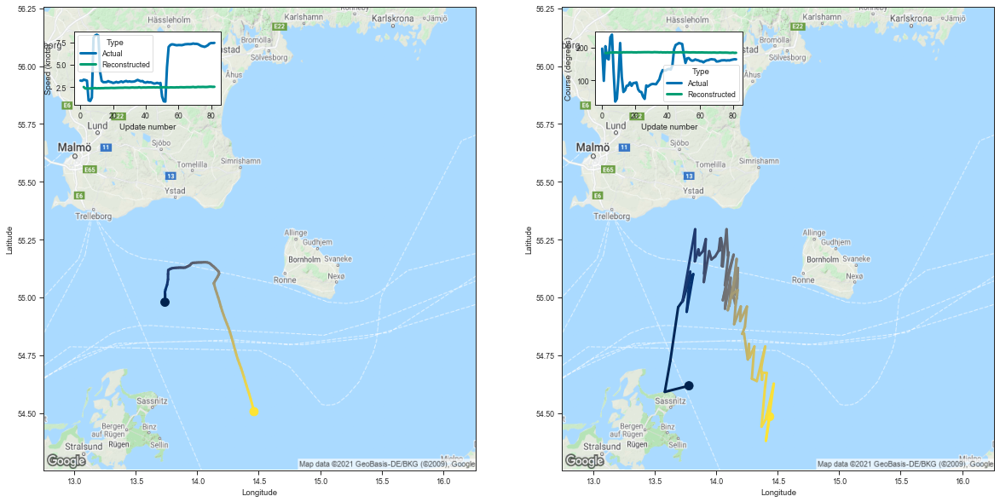

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.779089  54.617664  2.501223  183.544510         0.047047   
3   13.583014  54.591141  2.334349  183.688278         0.035510   
4   13.627371  54.724545  2.339265  184.201889         0.034127   
5   13.691391  54.957268  2.341532  185.004486         0.033418   
6   13.731084  54.987259  2.338123  185.141769         0.032958   
..        ...        ...       ...         ...              ...   
78  14.369257  54.440758  2.510184  184.152832         0.033390   
79  14.405569  54.475273  2.534468  184.316467         0.033676   
80  14.469027  54.626816  2.534974  184.891754         0.033120   
81  14.404739  54.379528  2.517440  184.047791         0.033285   
82  14.435206  54.484447  2.522815  184.394745         0.033083   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.103261     3.362478     98.444786                 1   
3         0.063574     3.284906     98.608261                

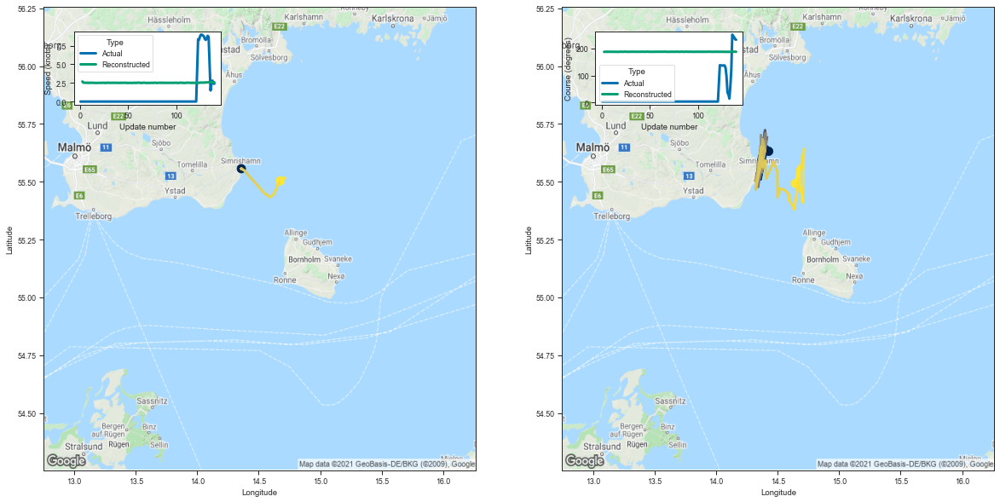

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.427567  55.631618  2.695622  187.313950         0.048573   
3    14.385803  55.619678  2.542205  187.667236         0.035223   
4    14.361423  55.510849  2.530229  187.414551         0.033750   
5    14.416306  55.651577  2.528319  187.892319         0.033084   
6    14.364620  55.573730  2.516377  187.615326         0.032969   
..         ...        ...       ...         ...              ...   
136  14.705855  55.410881  2.592475  187.498688         0.032549   
137  14.661579  55.553829  2.595958  187.858139         0.033084   
138  14.678759  55.522175  2.600202  187.800751         0.032955   
139  14.674399  55.567036  2.586238  187.957062         0.032810   
140  14.645350  55.492290  2.588934  187.702057         0.033014   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.126103     3.372817    100.399605                 1   
3          0.071844     3.292099    100.678177 

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
17,17,6685896,265759000,Fishing,143,-619.307556,-4.330822
44,44,7135380,266054000,Fishing,144,-631.192444,-4.383281
8,8,1943886,230069190,Fishing,135,-594.340698,-4.402524
102,102,2204657,230069190,Fishing,141,-622.452576,-4.414557
25,25,7292936,266054000,Fishing,144,-636.115479,-4.417469
...,...,...,...,...,...,...,...
57,57,4868710,265551874,Fishing,116,-698.222839,-6.019162
49,49,1557318,219021428,Fishing,135,-813.022949,-6.022392
94,94,3010756,261002520,Fishing,117,-709.282471,-6.062243
7,7,3067071,261002520,Fishing,83,-504.764008,-6.081494


In [11]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    # print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
    print(tracks['Reconstructed trajectory'])
df_n